In [ ]:
from google.colab import files
uploaded = files.upload()

Saving alzheimers_disease_data.csv to alzheimers_disease_data.csv


# **1.Installing Librariesies**

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import time
import matplotlib.pyplot as plt
from google.colab import files
import scipy.stats as stats
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc, roc_auc_score
from sklearn.tree import plot_tree

# **2.Reading and Understanding the data**

In [ ]:
data=pd.read_csv('alzheimers_disease_data.csv')
data.drop(columns=['DoctorInCharge','PatientID'],inplace=True)

In [ ]:
# Checking for missing values in the dataset.
data.isnull().sum()

,0
Age,0
Gender,0
Ethnicity,0
EducationLevel,0
BMI,0
Smoking,0
AlcoholConsumption,0
PhysicalActivity,0
DietQuality,0
SleepQuality,0


In [ ]:
# Checking of duplicate data
data.duplicated().sum()

0

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2149 entries, 0 to 2148
Data columns (total 33 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Age                        2149 non-null   int64  
 1   Gender                     2149 non-null   int64  
 2   Ethnicity                  2149 non-null   int64  
 3   EducationLevel             2149 non-null   int64  
 4   BMI                        2149 non-null   float64
 5   Smoking                    2149 non-null   int64  
 6   AlcoholConsumption         2149 non-null   float64
 7   PhysicalActivity           2149 non-null   float64
 8   DietQuality                2149 non-null   float64
 9   SleepQuality               2149 non-null   float64
 10  FamilyHistoryAlzheimers    2149 non-null   int64  
 11  CardiovascularDisease      2149 non-null   int64  
 12  Diabetes                   2149 non-null   int64  
 13  Depression                 2149 non-null   int64

In [ ]:
data.describe()

,Age,Gender,Ethnicity,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,SleepQuality,...,FunctionalAssessment,MemoryComplaints,BehavioralProblems,ADL,Confusion,Disorientation,PersonalityChanges,DifficultyCompletingTasks,Forgetfulness,Diagnosis
count,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,...,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000,2149.000000
mean,74.908795,0.506282,0.697534,1.286645,27.655697,0.288506,10.039442,4.920202,4.993138,7.051081,...,5.080055,0.208004,0.156817,4.982958,0.205212,0.158213,0.150768,0.158678,0.301536,0.353653
std,8.990221,0.500077,0.996128,0.904527,7.217438,0.453173,5.757910,2.857191,2.909055,1.763573,...,2.892743,0.405974,0.363713,2.949775,0.403950,0.365026,0.357906,0.365461,0.459032,0.478214
min,60.000000,0.000000,0.000000,0.000000,15.008851,0.000000,0.002003,0.003616,0.009385,4.002629,...,0.000460,0.000000,0.000000,0.001288,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,67.000000,0.000000,0.000000,1.000000,21.611408,0.000000,5.139810,2.570626,2.458455,5.482997,...,2.566281,0.000000,0.000000,2.342836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,75.000000,1.000000,0.000000,1.000000,27.823924,0.000000,9.934412,4.766424,5.076087,7.115646,...,5.094439,0.000000,0.000000,5.038973,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,83.000000,1.000000,1.000000,2.000000,33.869778,1.000000,15.157931,7.427899,7.558625,8.562521,...,7.546981,0.000000,0.000000,7.581490,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,90.000000,1.000000,3.000000,3.000000,39.992767,1.000000,19.989293,9.987429,9.998346,9.999840,...,9.996467,1.000000,1.000000,9.999747,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# **3. Data Visualization**

In [ ]:
#counting unique values in each column
for column in data.columns:
    unique_values = len(data[column].unique())
    print(f"Unique values in column '{column}':")
    print(unique_values)
    print()

Unique values in column 'Age':
31

Unique values in column 'Gender':
2

Unique values in column 'Ethnicity':
4

Unique values in column 'EducationLevel':
4

Unique values in column 'BMI':
2149

Unique values in column 'Smoking':
2

Unique values in column 'AlcoholConsumption':
2149

Unique values in column 'PhysicalActivity':
2149

Unique values in column 'DietQuality':
2149

Unique values in column 'SleepQuality':
2149

Unique values in column 'FamilyHistoryAlzheimers':
2

Unique values in column 'CardiovascularDisease':
2

Unique values in column 'Diabetes':
2

Unique values in column 'Depression':
2

Unique values in column 'HeadInjury':
2

Unique values in column 'Hypertension':
2

Unique values in column 'SystolicBP':
90

Unique values in column 'DiastolicBP':
60

Unique values in column 'CholesterolTotal':
2149

Unique values in column 'CholesterolLDL':
2149

Unique values in column 'CholesterolHDL':
2149

Unique values in column 'CholesterolTriglycerides':
2149

Unique values in

In [ ]:
# Identify numerical columns: columns with more than 10 unique values are considered numerical
numerical_columns = [col for col in data.columns if data[col].nunique() > 10]

# Identify categorical columns: columns that are not numerical and not 'Diagnosis'
categorical_columns = data.columns.difference(numerical_columns).difference(['Diagnosis']).to_list()
print(f'Numerical data:{numerical_columns}')
print(f'Categorical data:{categorical_columns}')


Numerical data:['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']
Categorical data:['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes', 'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity', 'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'PersonalityChanges', 'Smoking']


# **3.1. Distribution of Categorical Features**

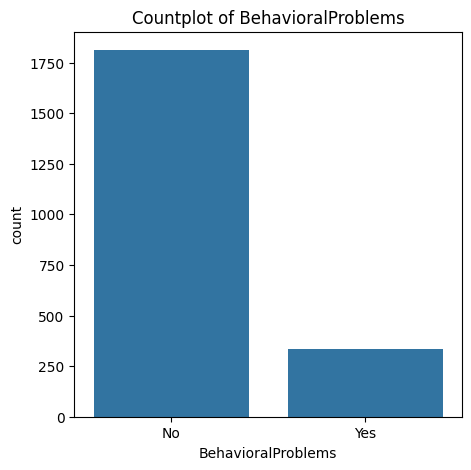

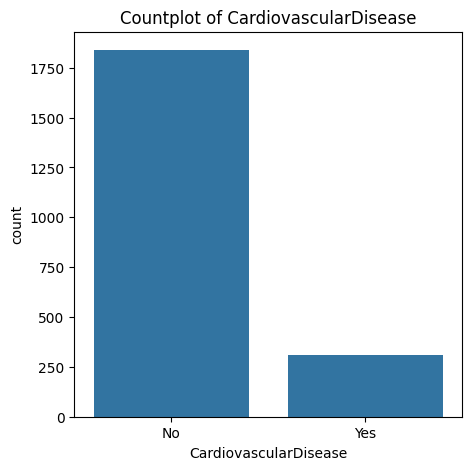

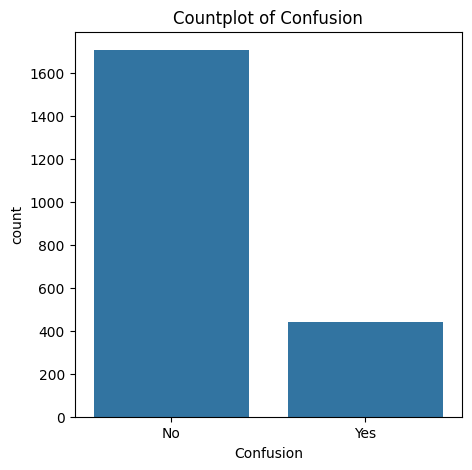

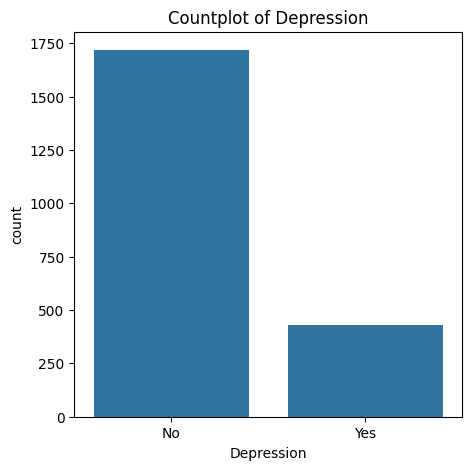

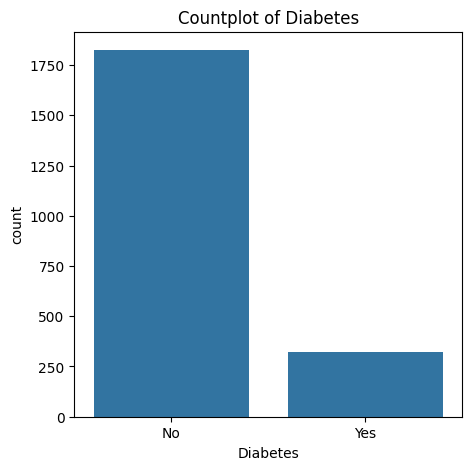

...

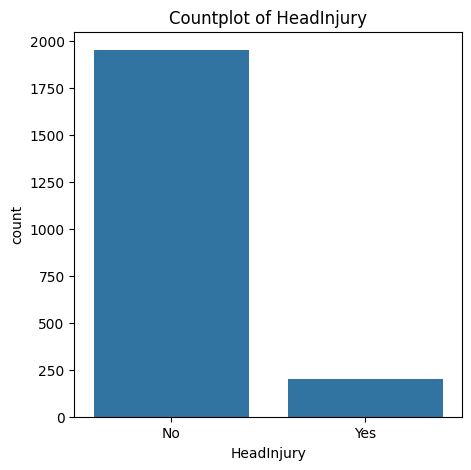

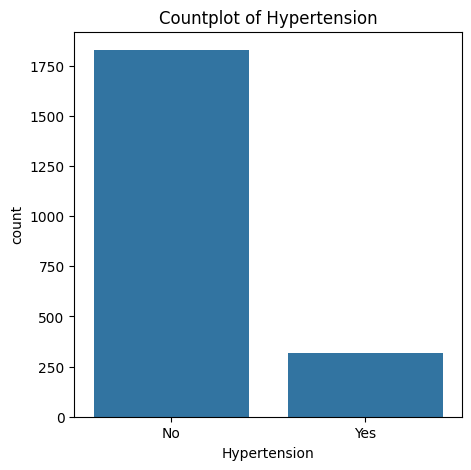

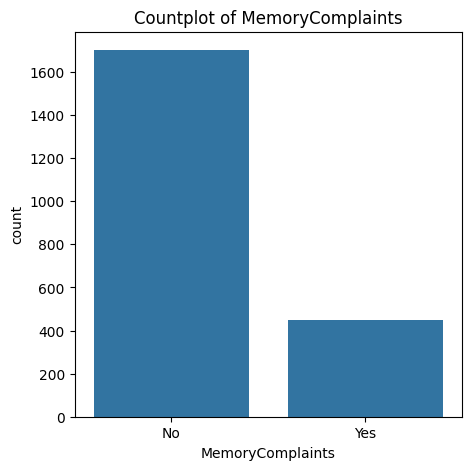

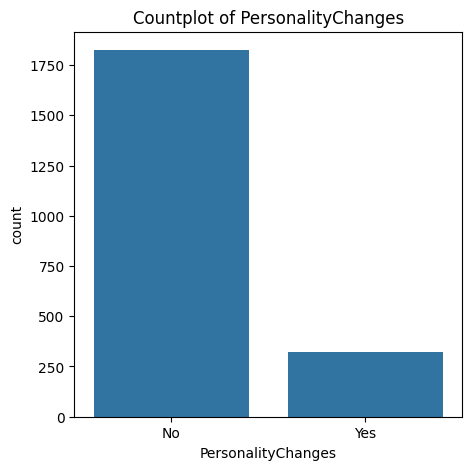

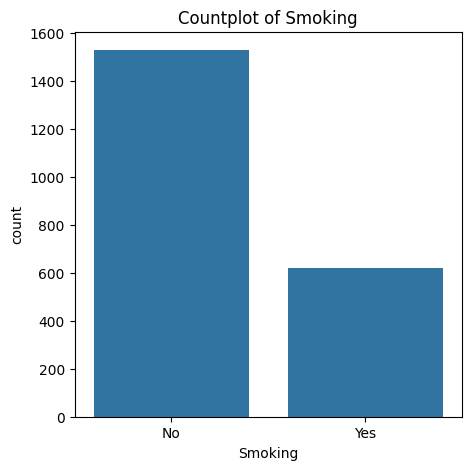

In [ ]:
from google.colab import files

custom_labels = {
    'Gender': ['Male', 'Female'],
    'Ethnicity': ['Caucasian', 'African American', 'Asian', 'Other'],
    'EducationLevel': ['None', 'High School', 'Bachelor\'s', 'Higher'],
    'Smoking': ['No', 'Yes'],
    'FamilyHistoryAlzheimers': ['No', 'Yes'],
    'CardiovascularDisease': ['No', 'Yes'],
    'Diabetes': ['No', 'Yes'],
    'Depression': ['No', 'Yes'],
    'HeadInjury': ['No', 'Yes'],
    'Hypertension': ['No', 'Yes'],
    'MemoryComplaints': ['No', 'Yes'],
    'BehavioralProblems': ['No', 'Yes'],
    'Confusion': ['No', 'Yes'],
    'Disorientation': ['No', 'Yes'],
    'PersonalityChanges': ['No', 'Yes'],
    'DifficultyCompletingTasks': ['No', 'Yes'],
    'Forgetfulness': ['No', 'Yes']
}

# Plot and save countplots for each categorical column
for column in categorical_columns:
    plt.figure(figsize=(5, 5))
    sns.countplot(data=data, x=column)
    plt.title(f'Countplot of {column}')
    labels = custom_labels[column]
    ticks = range(len(labels))
    plt.xticks(ticks=ticks, labels=labels)
    plt.show()

    plt.savefig(f'countplot_{column}.png', dpi=300)  # Save the plot with 300 DPI
    plt.close()  # Close the plot to free memory

    # Download the saved plot
    #files.download(f'countplot_{column}.png')

# **3.2. Distribution of Numerical Features**

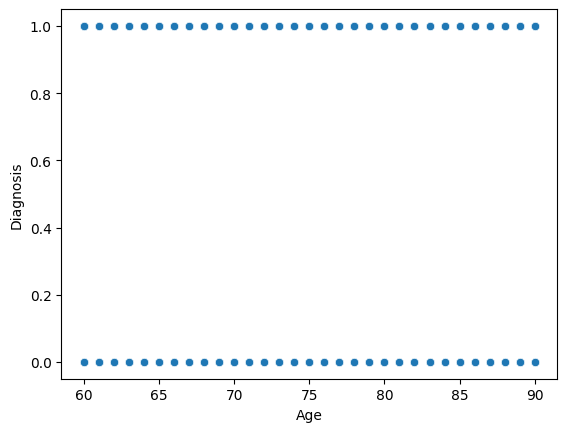

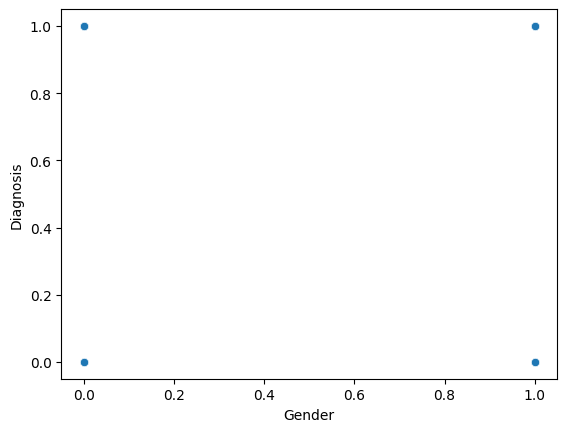

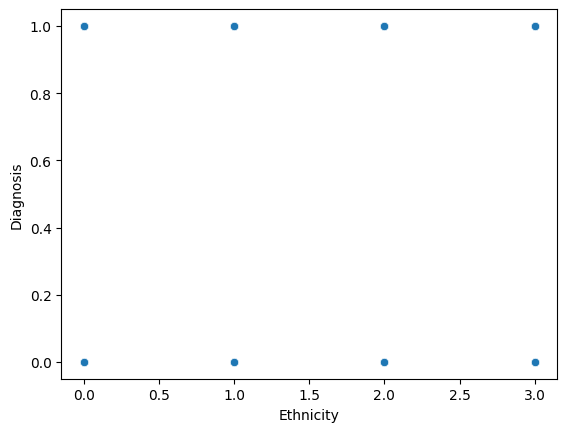

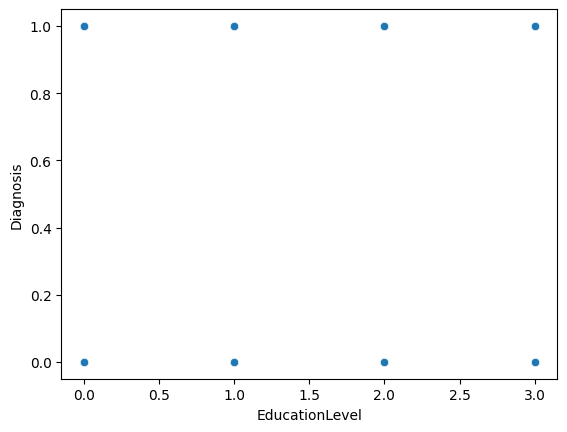

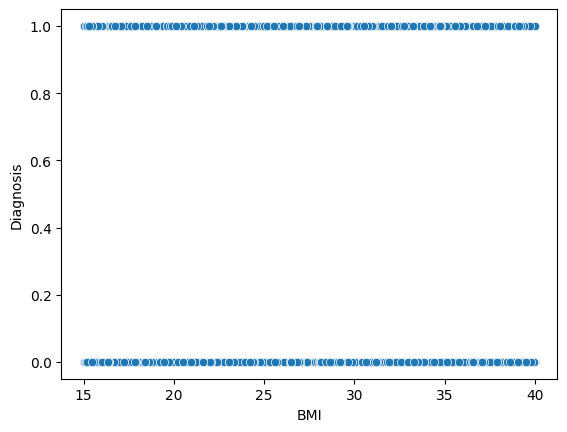

...

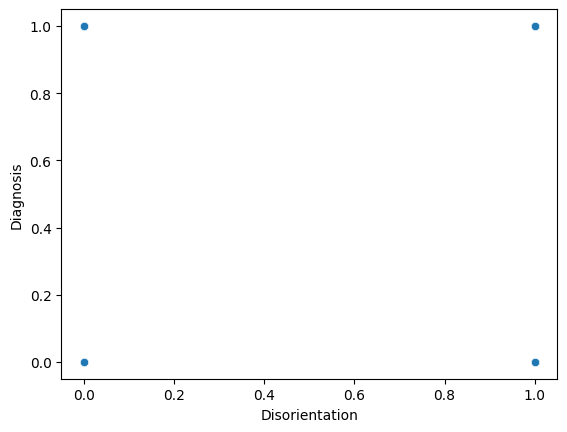

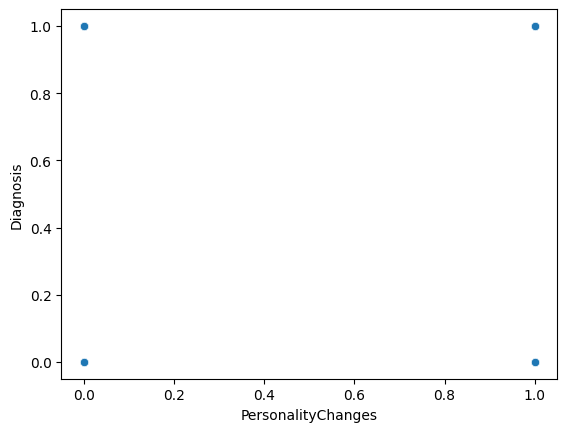

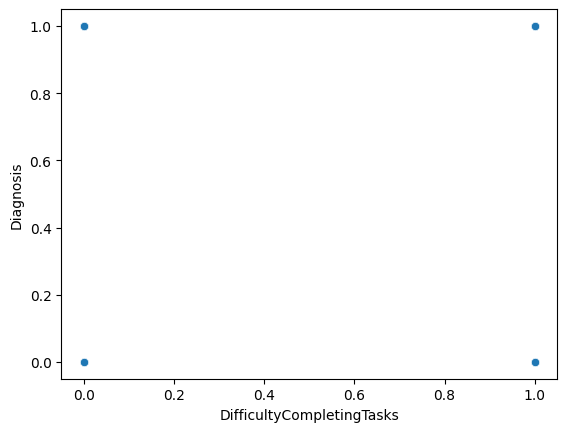

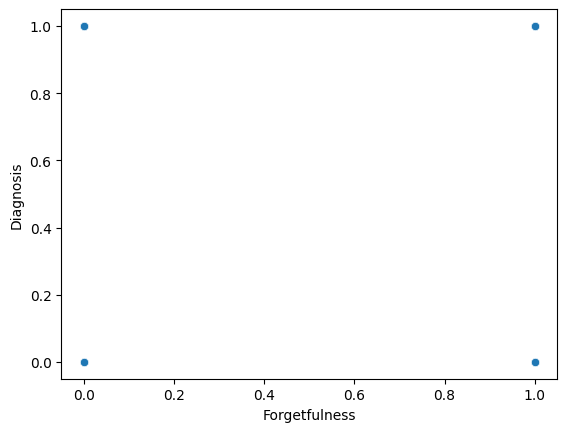

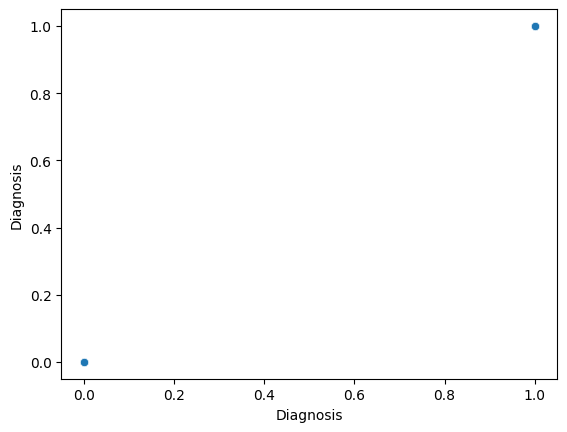

In [ ]:
for column in data:
  sns.scatterplot(data=data,x=column,y='Diagnosis')
  plt.show()

<Figure size 1000x1000 with 0 Axes>

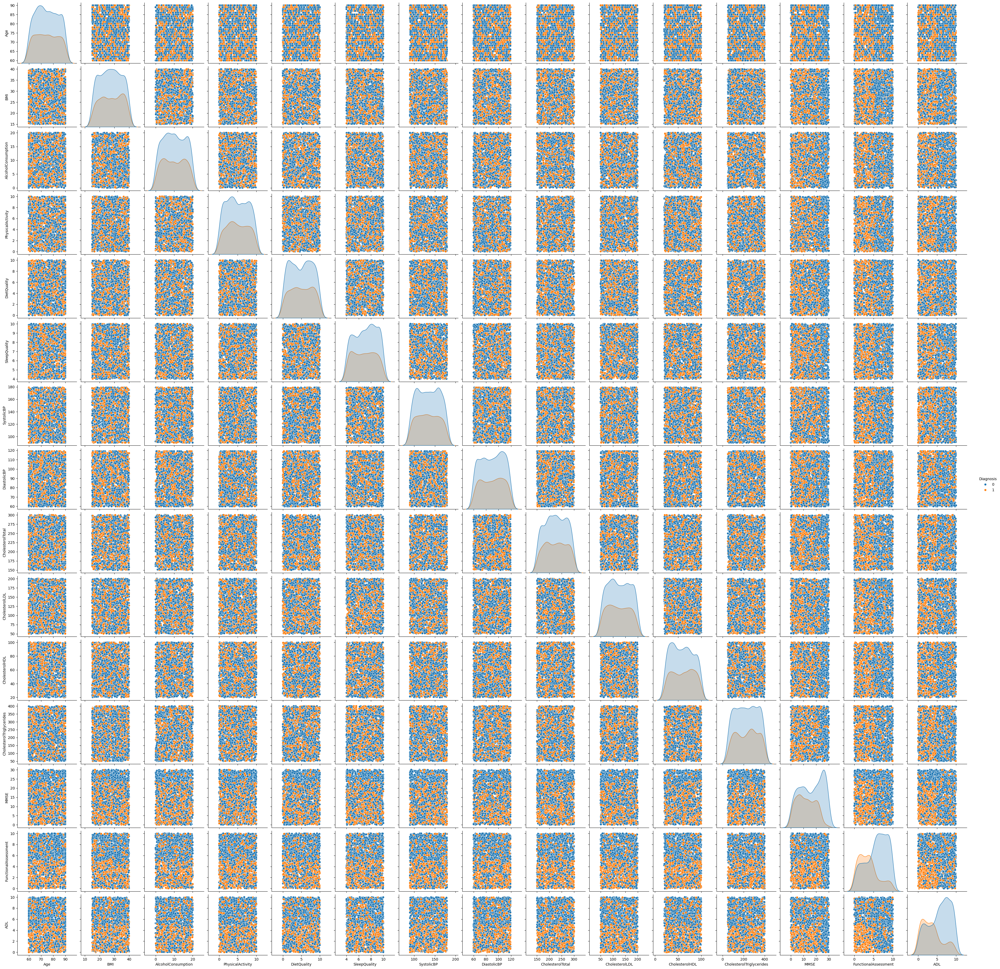

In [ ]:
#pair plot of numerical columns
plt.figure(figsize=(10,10))
sns.pairplot(data[numerical_columns+['Diagnosis']],hue='Diagnosis')
plt.show()

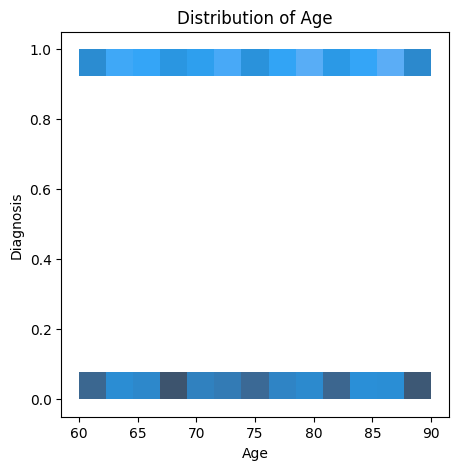

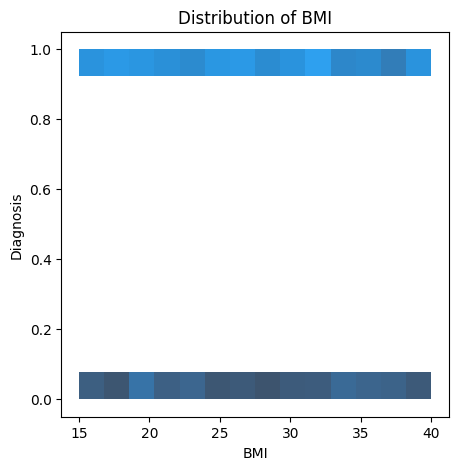

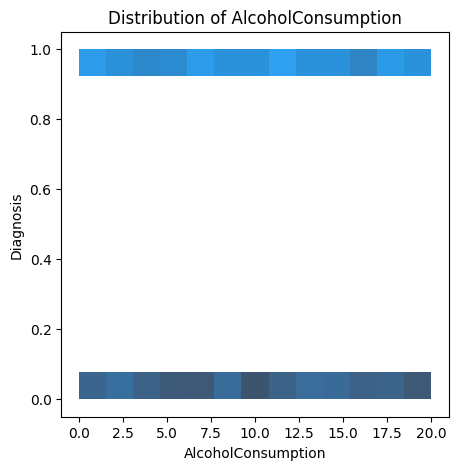

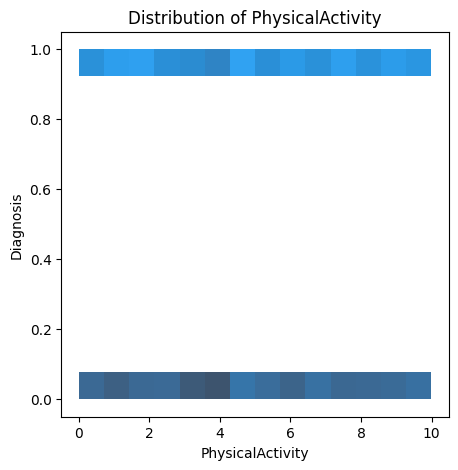

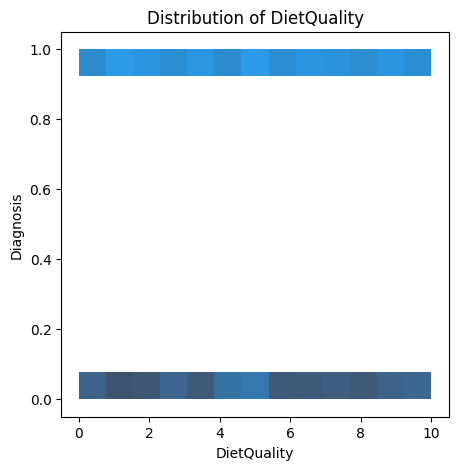

...

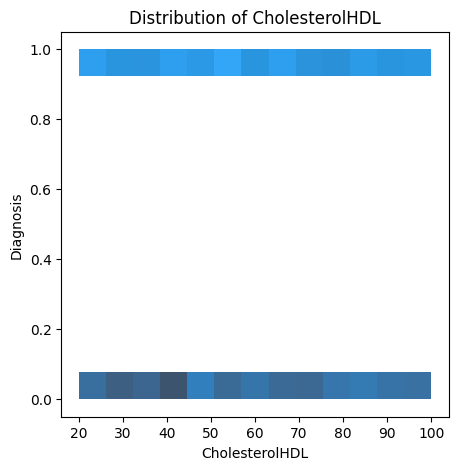

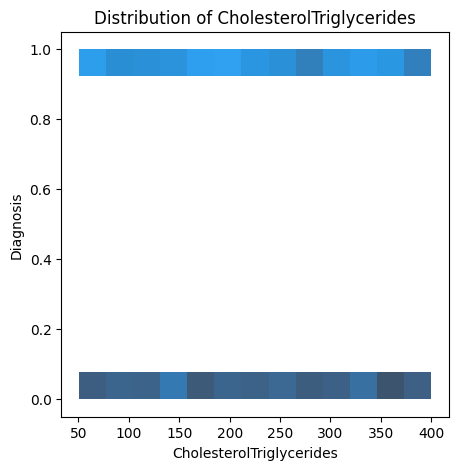

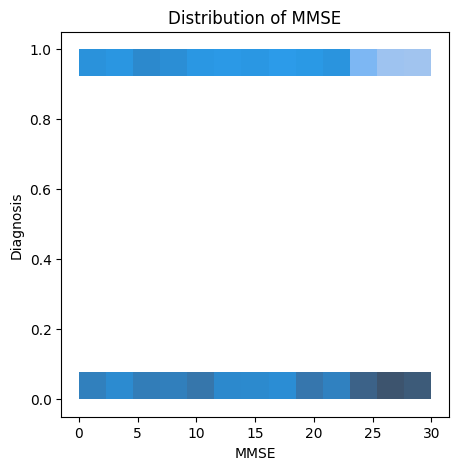

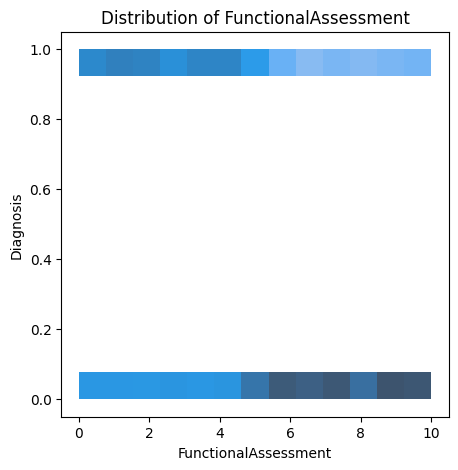

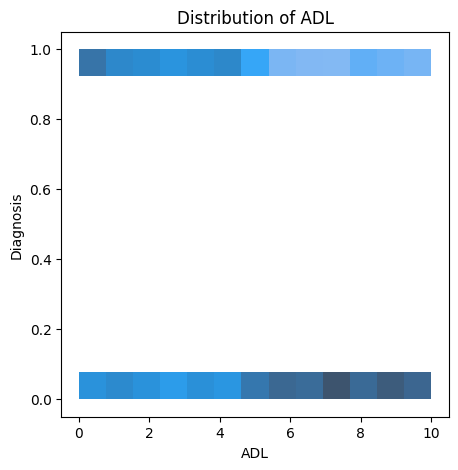

In [ ]:
for column in numerical_columns:
    plt.figure(figsize=(5, 5))
    sns.histplot(data=data, x=column,y=data['Diagnosis'])
    plt.title(f'Distribution of {column}')
    plt.show()

# **3.3. Exploring Correlations**

In [ ]:
# pearson corr of numerical column w.r.t diagnosis
for column in ['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality',
               'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal',
               'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides',
               'MMSE', 'FunctionalAssessment', 'ADL']:
    # Calculate Pearson correlation for each column against 'Diagnosis'
    corr, _ = stats.pearsonr(data[column], data['Diagnosis'])
    print(f'Pearsons correlation for {column}: %.3f' % corr)

Pearsons correlation for Age: -0.005
Pearsons correlation for BMI: 0.026
Pearsons correlation for AlcoholConsumption: -0.008
Pearsons correlation for PhysicalActivity: 0.006
Pearsons correlation for DietQuality: 0.009
Pearsons correlation for SleepQuality: -0.057
Pearsons correlation for SystolicBP: -0.016
Pearsons correlation for DiastolicBP: 0.005
Pearsons correlation for CholesterolTotal: 0.006
Pearsons correlation for CholesterolLDL: -0.032
Pearsons correlation for CholesterolHDL: 0.043
Pearsons correlation for CholesterolTriglycerides: 0.023
Pearsons correlation for MMSE: -0.237
Pearsons correlation for FunctionalAssessment: -0.365
Pearsons correlation for ADL: -0.332


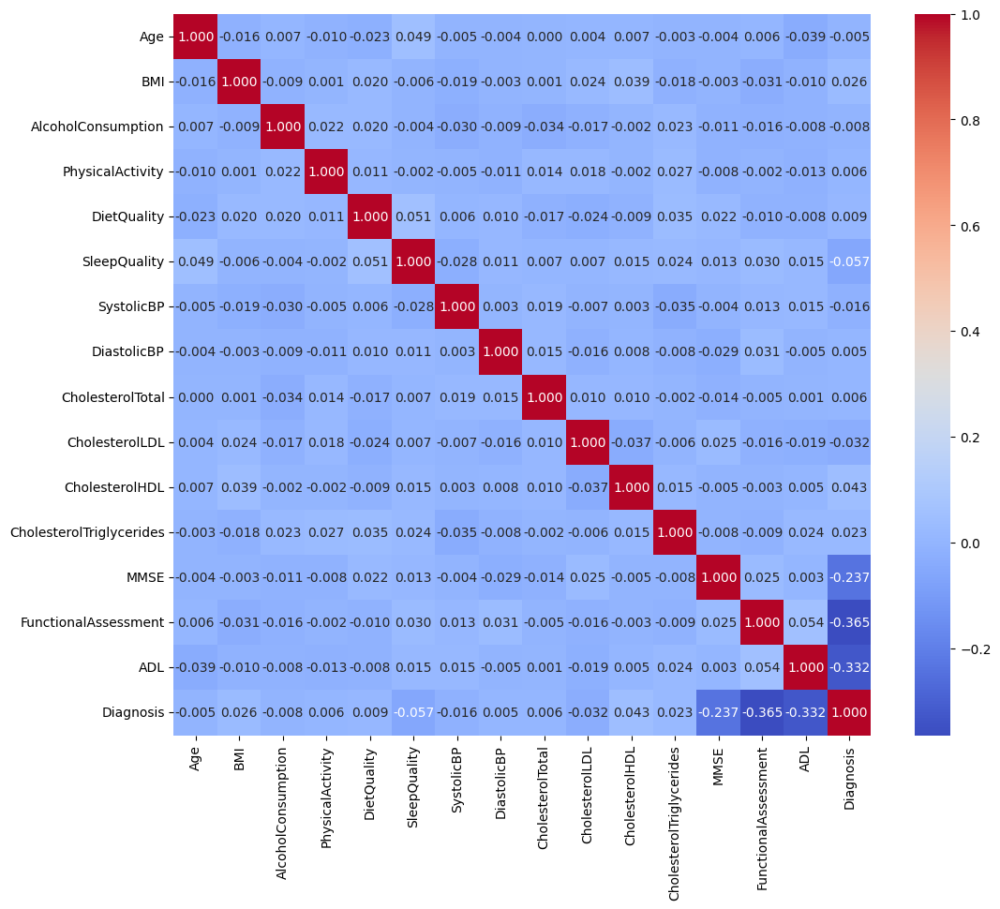

<Figure size 640x480 with 0 Axes>

In [ ]:
#plotting the heatmap
fig, ax = plt.subplots(figsize=(12, 10))
#heatmap of numerical column
sns.heatmap(data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality',
               'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal',
               'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides',
               'MMSE', 'FunctionalAssessment', 'ADL','Diagnosis']].corr(), annot=True, cmap='coolwarm', fmt='0.3f')
plt.show()

#save and download image
plt.savefig('heatmap.png', dpi=300)
#files.download('heatmap.png')

In [ ]:
#chi-square for categorical columns
from logging import critical
from scipy.stats import chi2
print(categorical_columns)
for column in categorical_columns:
  dataset_table = pd.crosstab(data['Diagnosis'], data[column])
  # print("dataset_table : ", dataset_table)
  # print()
  observed_value = dataset_table.values
  # print("observed_value : ",observed_value)
  val = stats.chi2_contingency(dataset_table)
  # print("val : ", val)
  print()
  Expected_value = val[3]
  no_of_rows = len(dataset_table.iloc[0:2,0])
  no_of_columns = len(dataset_table.iloc[0,0:2])
  ddof = (no_of_rows - 1) * (no_of_columns - 1)
  # print(ddof)
  alpha = 0.05
  chi_square = sum([(o - e) ** 2. / e for o, e in zip(observed_value, Expected_value)])
  chi_square_statistic = chi_square[0] + chi_square[1]
  critical_value = chi2.ppf(q = 1 - alpha, df = ddof)
  #p-value
  p_value = 1 - chi2.cdf(x = chi_square_statistic, df = ddof)
  print(column)
  print("chi_square_statistic :", chi_square_statistic)
  print("critical_value :", critical_value)
  print("p_value :", p_value)
  print("Significance level :", alpha)
  print("Degree of freedom :", ddof)

['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes', 'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity', 'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'PersonalityChanges', 'Smoking']

BehavioralProblems
chi_square_statistic : 108.16583697285267
critical_value : 3.841458820694124
p_value : 0.0
Significance level : 0.05
Degree of freedom : 1

CardiovascularDisease
chi_square_statistic : 2.1310249449464083
critical_value : 3.841458820694124
p_value : 0.14434421007443543
Significance level : 0.05
Degree of freedom : 1

Confusion
chi_square_statistic : 0.7910293630349065
critical_value : 3.841458820694124
p_value : 0.37378905013162356
Significance level : 0.05
Degree of freedom : 1

Depression
chi_square_statistic : 0.07462693316507048
critical_value : 3.841458820694124
p_value : 0.7847153866985926
Significance level : 0.05
Degree of freedom : 1

Diabetes
chi_square_statist

In [ ]:
import pandas as pd
from scipy.stats import pearsonr

target = 'Diagnosis'
# Select only numerical columns
numerical_cols = [column for column in ['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality',
               'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal',
               'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', # removed unexpected indent
               'MMSE', 'FunctionalAssessment', 'ADL']] # removed unexpected indent

# Dictionary to store p-values for numerical columns
p_values = {}

# Perform Pearson correlation between each numerical column and the target
for col in numerical_cols:
    if col != target:
        corr, p_value = pearsonr(data[col], data[target])
        p_values[col] = p_value

# Print p values
for col, p in p_values.items():
    print(f"P-value for {col}: {p}")

# Select features with p-value less than the significance level (e.g., 0.05)
selected_numerical_features = [col for col, p in p_values.items() if p < 0.05]
print("")

print("Selected Numerical Features:", selected_numerical_features)


#plotting the heatmap
#fig, ax = plt.subplots(figsize=(12, 10))
#heatmap of numerical column
#sns.heatmap(data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality',
              # 'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal',
              # 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides',
              # 'MMSE', 'FunctionalAssessment', 'ADL','Diagnosis']].corr(), annot=True, cmap='coolwarm', fmt='0.3f')
#plt.show()
#files.download('heatmap.png')

P-value for Age: 0.799279022412388
P-value for BMI: 0.22220598815453718
P-value for AlcoholConsumption: 0.7241273045229578
P-value for PhysicalActivity: 0.7829795610227279
P-value for DietQuality: 0.6935202236240916
P-value for SleepQuality: 0.008741800761833254
P-value for SystolicBP: 0.4693708949525697
P-value for DiastolicBP: 0.8062912382894503
P-value for CholesterolTotal: 0.7670310351981604
P-value for CholesterolLDL: 0.13838562194865753
P-value for CholesterolHDL: 0.04840127000143341
P-value for CholesterolTriglycerides: 0.293474180155588
P-value for MMSE: 7.537247571979273e-29
P-value for FunctionalAssessment: 1.1347847959943976e-68
P-value for ADL: 1.3968844495324108e-56

Selected Numerical Features: ['SleepQuality', 'CholesterolHDL', 'MMSE', 'FunctionalAssessment', 'ADL']


In [ ]:
import pandas as pd
from scipy.stats import chi2_contingency, chi2

# Dictionary to store p-values and other statistics for categorical columns
p_values_cat = {}

# Significance level
alpha = 0.05

# Loop through categorical columns (those with < 10 unique values)
categorical_cols = [col for col in data.columns if data[col].nunique() < 10]

target = 'Diagnosis'

for col in categorical_cols:
    if col != target:
        contingency_table = pd.crosstab(data[target], data[col])
        chi2_statistic, p_value, ddof, expected = chi2_contingency(contingency_table)

        # Critical value
        critical_value = chi2.ppf(q=1 - alpha, df=ddof)

        # Print results
        print(f"P-value for {col} vs {target}: {p_value:.4f}")
        print(f"Chi-Square Statistic for {col} vs {target}: {chi2_statistic:.4f}")
        print(f"Critical Value for {col} vs {target}: {critical_value:.4f}")
        print(f"Degrees of Freedom for {col} vs {target}: {ddof}")
        print(f"Significance Level (alpha): {alpha}")
        print()

        # Store p-value
        p_values_cat[col] = p_value

# Select features with p-value less than the significance level (e.g., 0.05)
selected_categorical_features = [col for col, p in p_values_cat.items() if p < 0.05]

print("Selected Categorical Features:", selected_categorical_features)


['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'Smoking', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality', 'FamilyHistoryAlzheimers', 'CardiovascularDisease', 'Diabetes', 'Depression', 'HeadInjury', 'Hypertension', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'MemoryComplaints', 'BehavioralProblems', 'ADL', 'Confusion', 'Disorientation', 'PersonalityChanges', 'DifficultyCompletingTasks', 'Forgetfulness', 'Diagnosis']
P-value for Age vs Diagnosis: 0.9286
Chi-Square Statistic for Age vs Diagnosis: 19.5114
Critical Value for Age vs Diagnosis: 43.7730
Degrees of Freedom for Age vs Diagnosis: 30
Significance Level (alpha): 0.05

P-value for Gender vs Diagnosis: 0.3538
Chi-Square Statistic for Gender vs Diagnosis: 0.8597
Critical Value for Gender vs Diagnosis: 3.8415
Degrees of Freedom for Gender vs Diagnosis: 1
Significance Level (alpha): 0.05

P-value for Eth

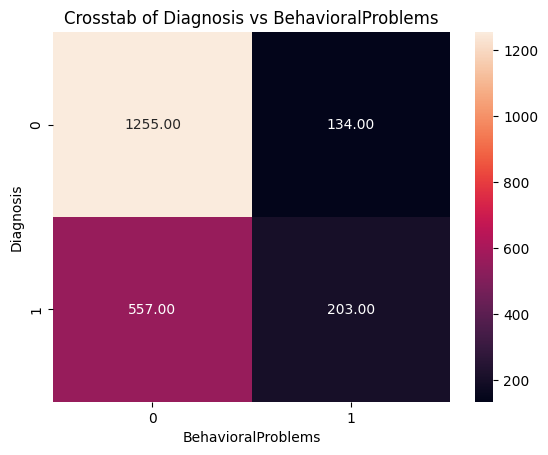

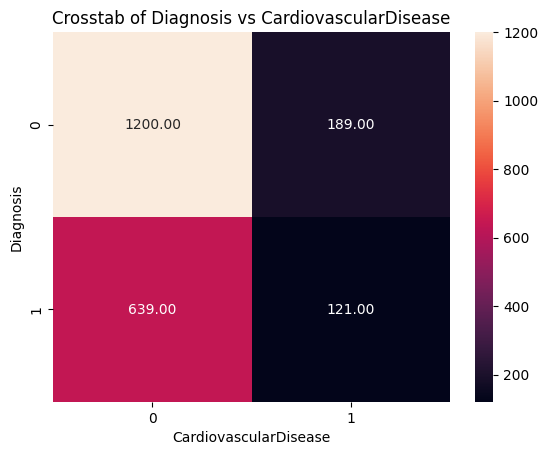

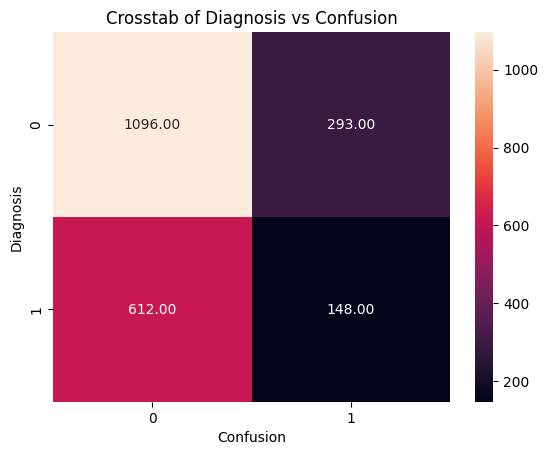

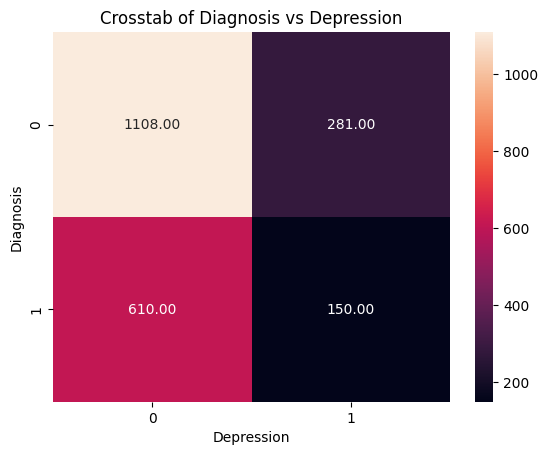

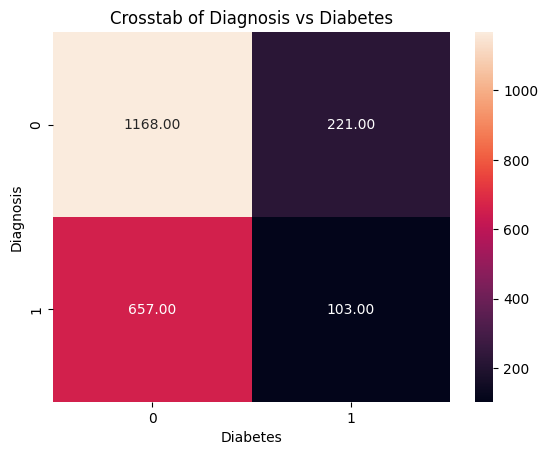

...

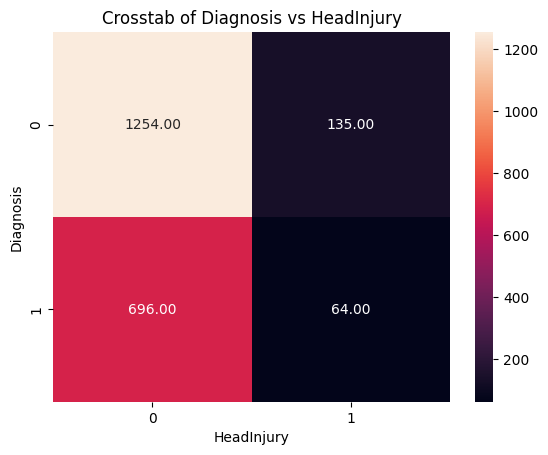

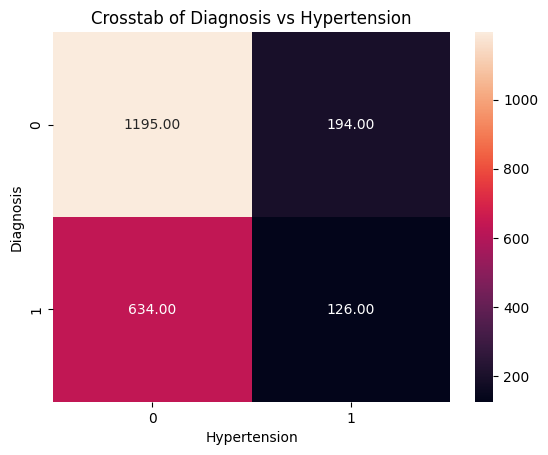

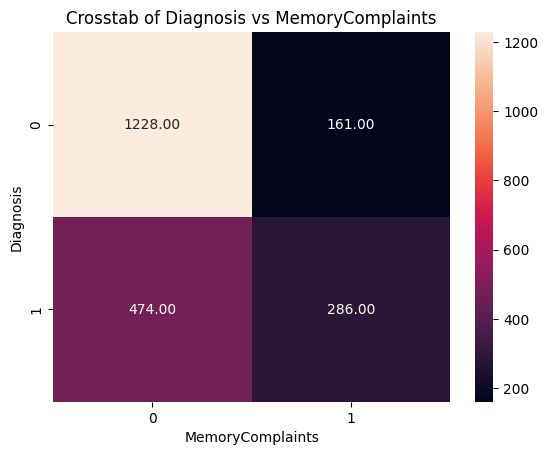

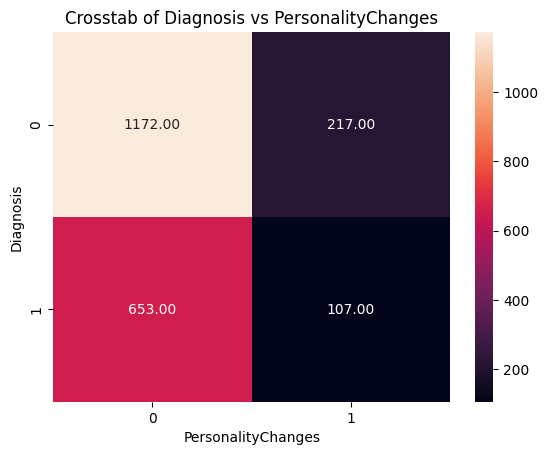

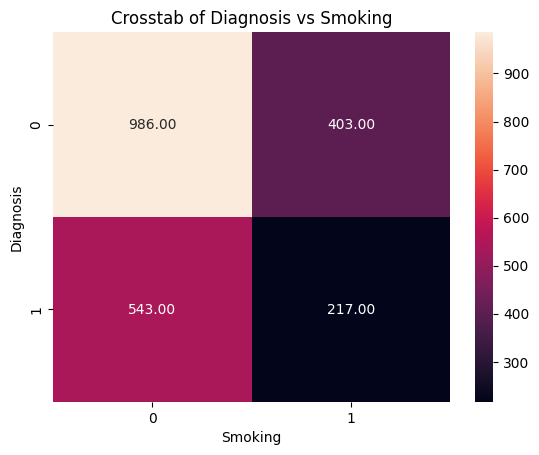

In [ ]:
# Iterate over each column and create individual crosstabs
for column in ['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes',
               'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity',
               'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension',
               'MemoryComplaints', 'PersonalityChanges', 'Smoking']:
    crosstab_result = pd.crosstab(data['Diagnosis'], data[column])
    plt.figure()  # Create a new figure for each heatmap
    sns.heatmap(crosstab_result, fmt='.2f', annot=True)
    plt.title(f"Crosstab of Diagnosis vs {column}")  # Set title for clarity
    plt.show()

In [ ]:
# Compute point biserial correlation for each numerical feature with the binary target
from scipy.stats import pointbiserialr
correlations = {}
for column in data.columns:
    if column != 'Diagnosis':
        corr, _ = pointbiserialr(data[column], data['Diagnosis'])
        correlations[column] = corr

# Convert to DataFrame for better visualization
corr_df = pd.DataFrame.from_dict(correlations, orient='index', columns=['Correlation'])
corr_df = corr_df.sort_values(by='Correlation', ascending=False)

# Classify the correlations
strong_positive = corr_df[corr_df['Correlation'] > 0.05]
strong_negative = corr_df[corr_df['Correlation'] < -0.05]
moderate = corr_df[(corr_df['Correlation'] >= -0.05) & (corr_df['Correlation'] <= 0.05)]

# Print classified correlations
print("\nStrong Positive Correlations:\n", strong_positive)
print("\nStrong Negative Correlations:\n", strong_negative)
print("\nModerate Correlations:\n", moderate)


Strong Positive Correlations:
                     Correlation
MemoryComplaints       0.306742
BehavioralProblems     0.224350

Strong Negative Correlations:
                       Correlation
SleepQuality            -0.056548
MMSE                    -0.237126
ADL                     -0.332346
FunctionalAssessment    -0.364898

Moderate Correlations:
                            Correlation
CholesterolHDL                0.042584
Hypertension                  0.035080
CardiovascularDisease         0.031490
BMI                           0.026343
CholesterolTriglycerides      0.022672
DifficultyCompletingTasks     0.009069
DietQuality                   0.008506
CholesterolTotal              0.006394
PhysicalActivity              0.005945
DiastolicBP                   0.005293
Forgetfulness                -0.000354
Smoking                      -0.004865
Age                          -0.005488
Depression                   -0.005893
AlcoholConsumption           -0.007618
Ethnicity            

# **3.4. Target Column Distribution**

Diagnosis
0    1389
1     760
Name: count, dtype: int64


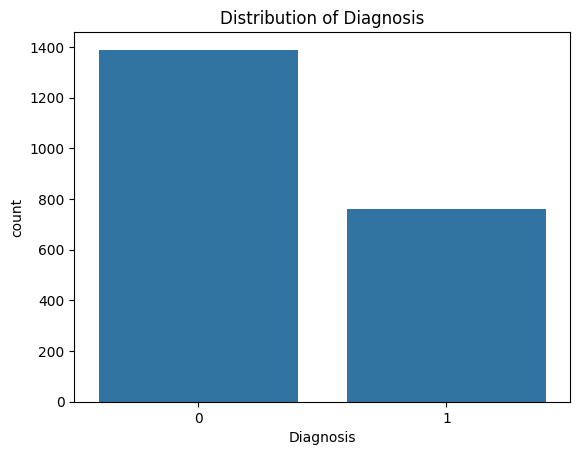

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
categories=[0,1]
counts=data['Diagnosis'].value_counts()
print(counts)
sns.barplot(counts)
# plt.pie(counts,labels=categories,autopct='%1.1f%%')
plt.title('Distribution of Diagnosis')
#from this pie chart we can conclude that there data imbalance

plt.savefig('diagnosis.png', dpi=300)

plt.show()

plt.close()

files.download('diagnosis.png')


# **3.5. Countplot for each column v/s Diagnosis**

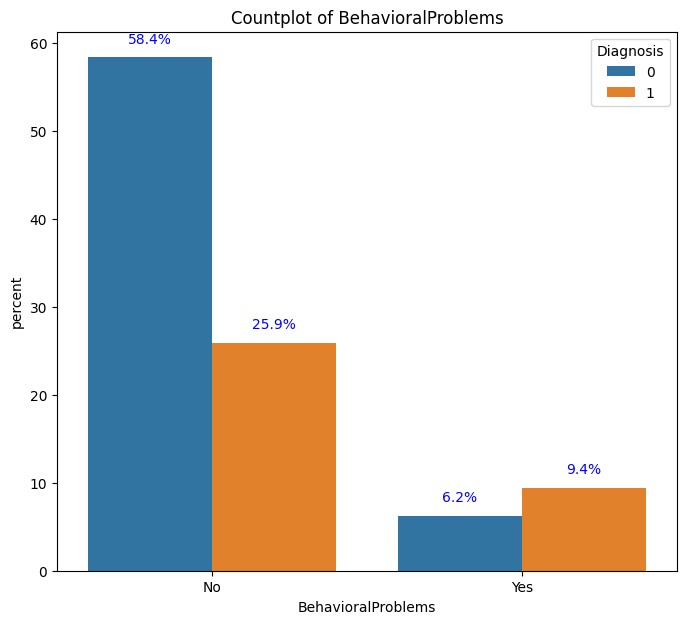

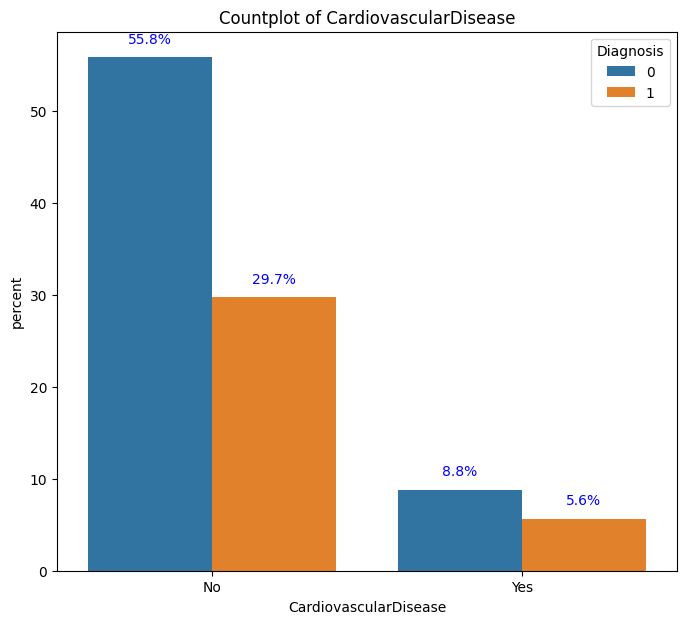

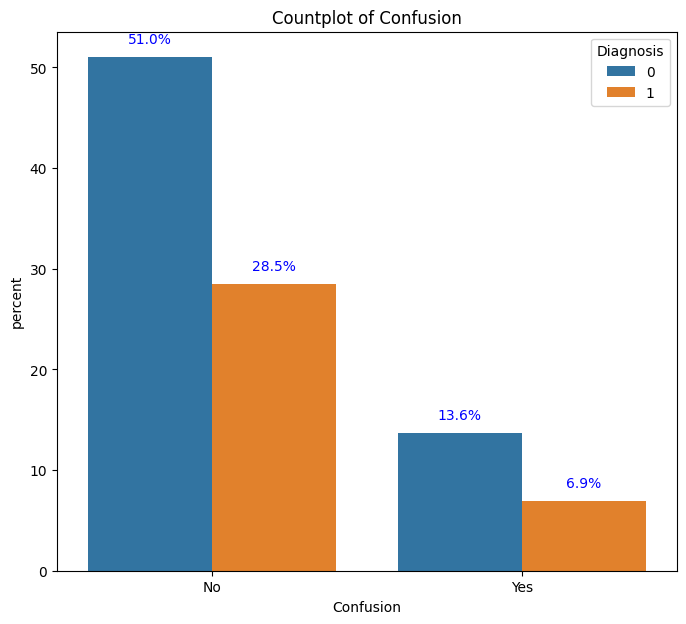

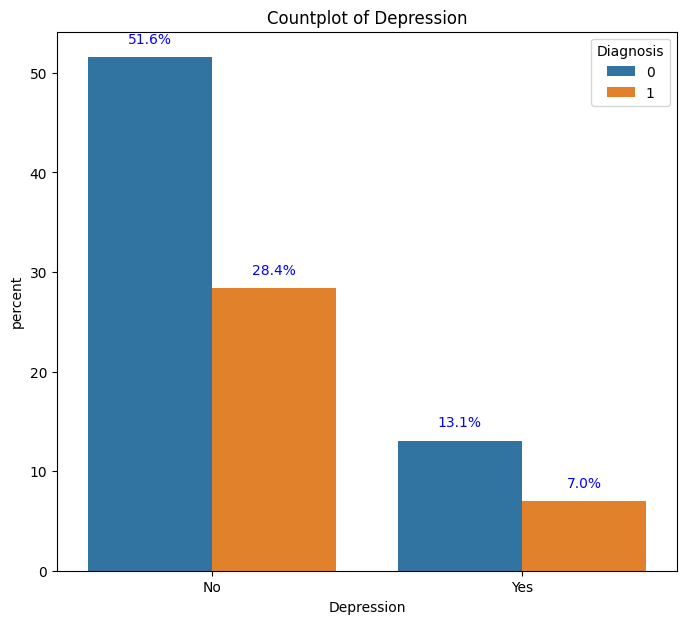

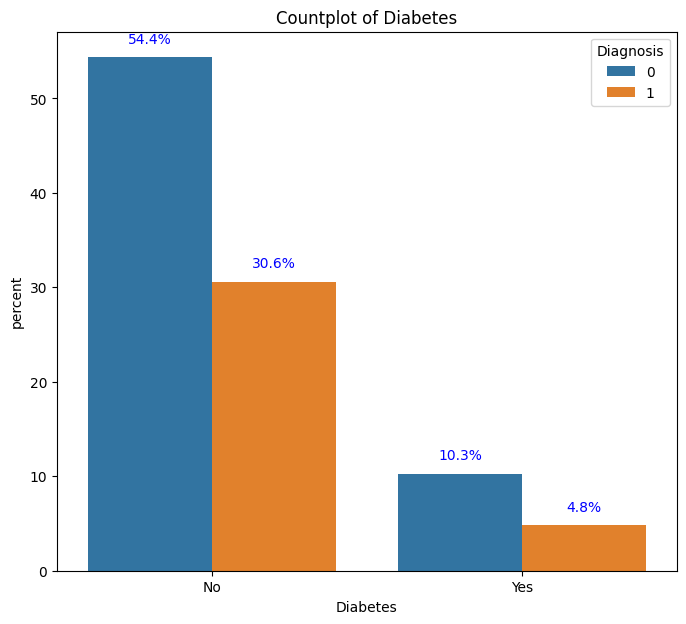

...

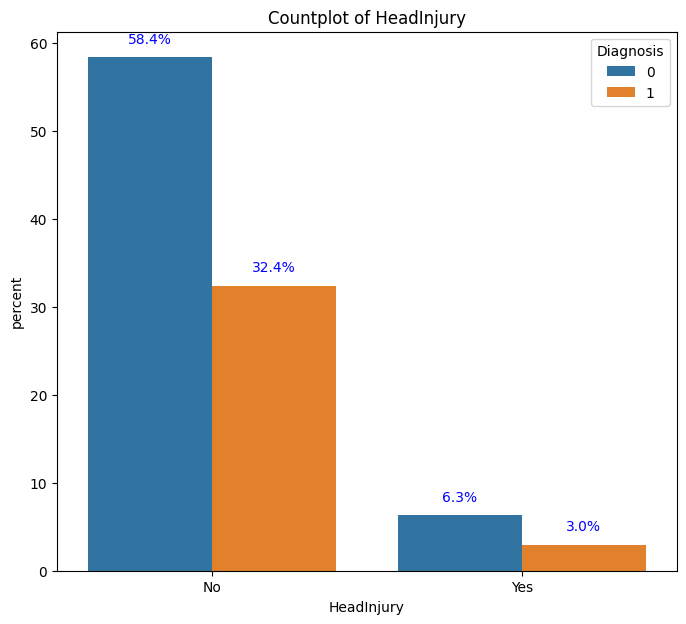

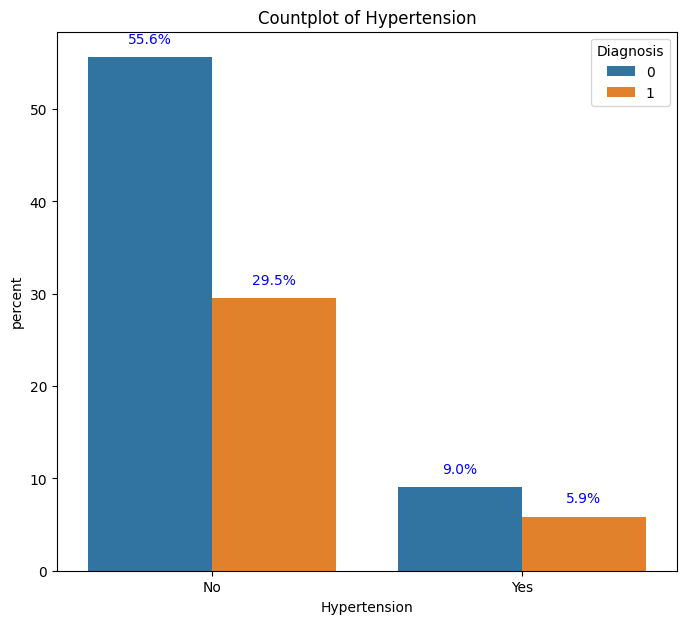

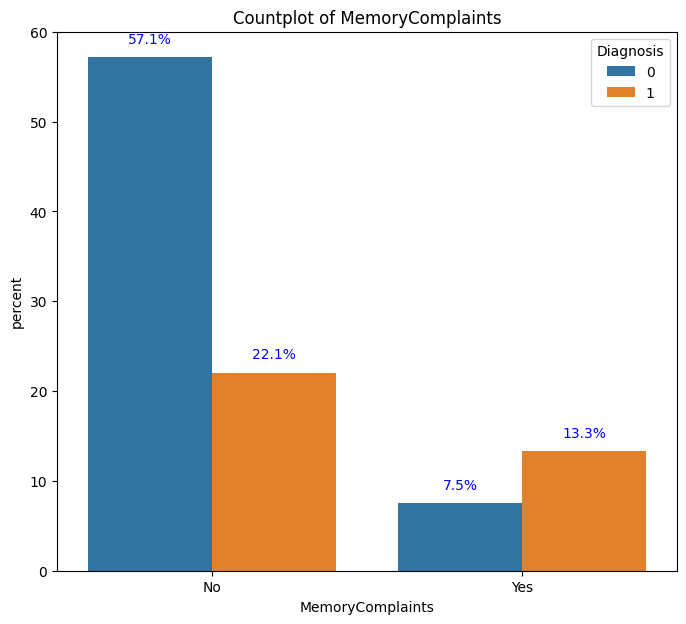

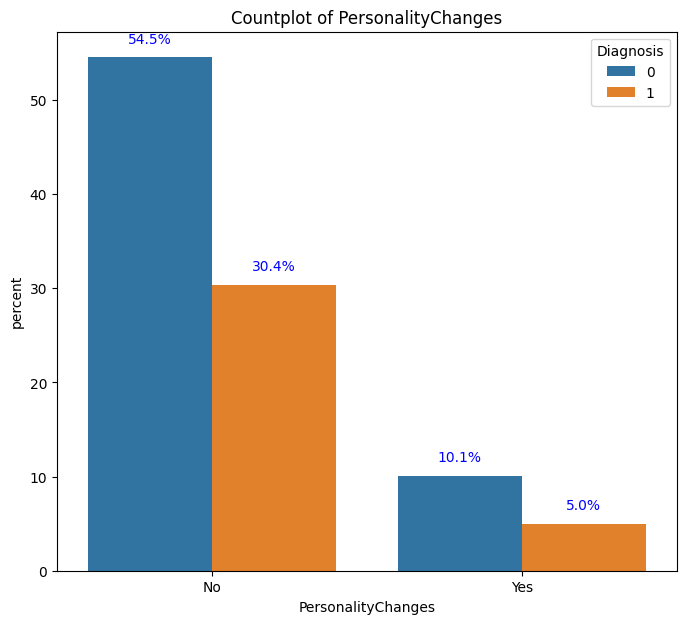

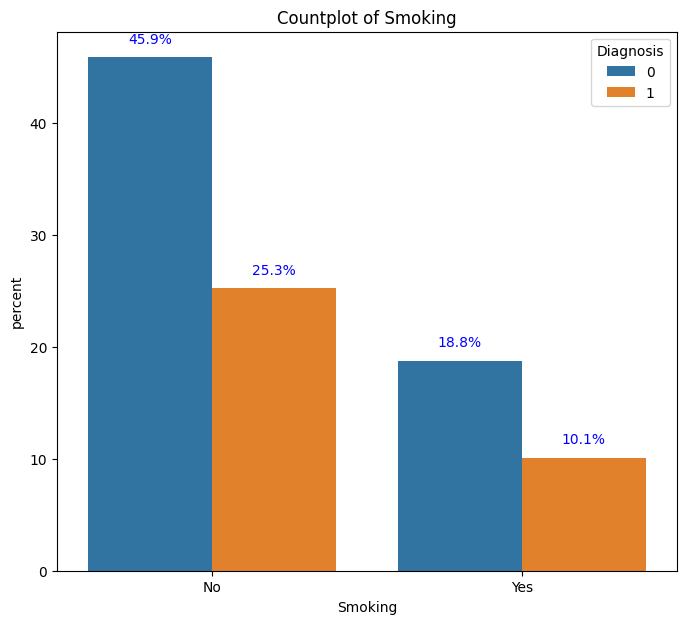

In [ ]:
#Countplot of each feature with the target column
for column in categorical_columns:
    plt.figure(figsize=(8, 7))
    ax = sns.countplot(data=data, x=column,hue='Diagnosis',stat='percent')
    plt.title(f'Countplot of {column}')
    labels = custom_labels[column]
    ticks = range(len(labels))
    plt.xticks(ticks=ticks, labels=labels)
    for p in ax.patches:
        height = p.get_height()
        if height == 0.0:
          continue
        else:
            ax.annotate(f'{height:.1f}%', (p.get_x() + p.get_width() / 2., height), ha='center', va='bottom', xytext=(0, 8), textcoords='offset points',color='blue')


# **4.Data Preprocessing**

# **4.1. Checking for Outliers**

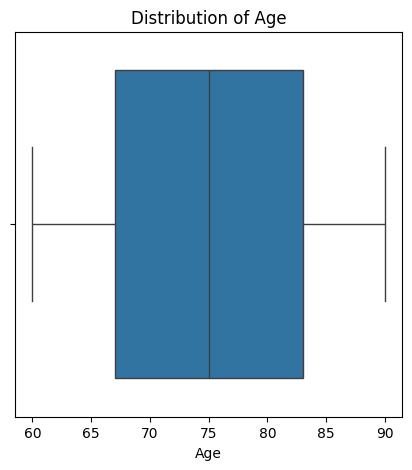

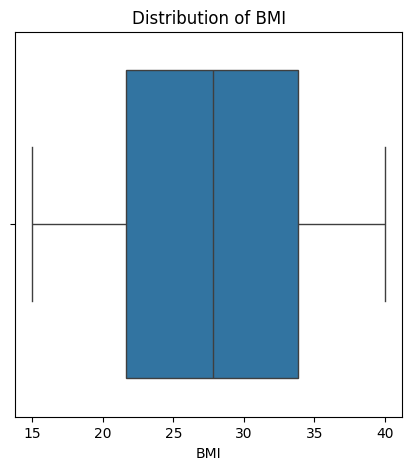

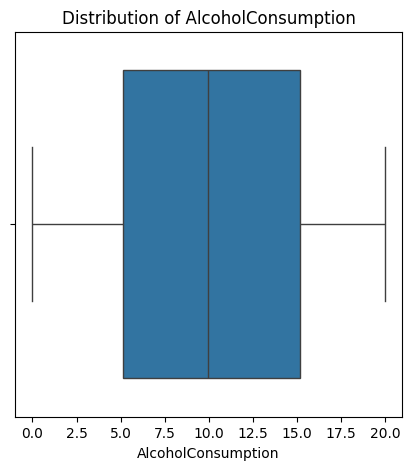

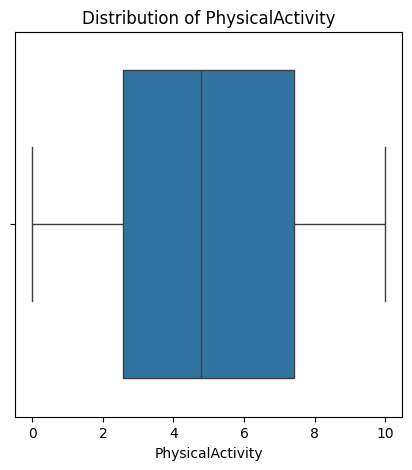

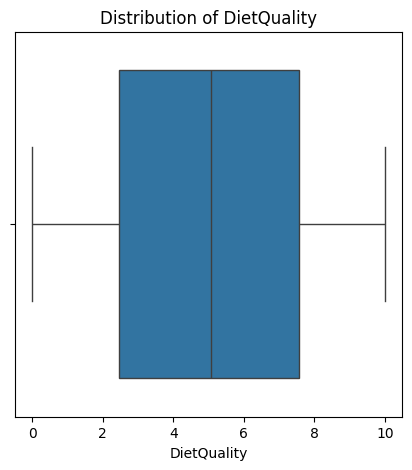

...

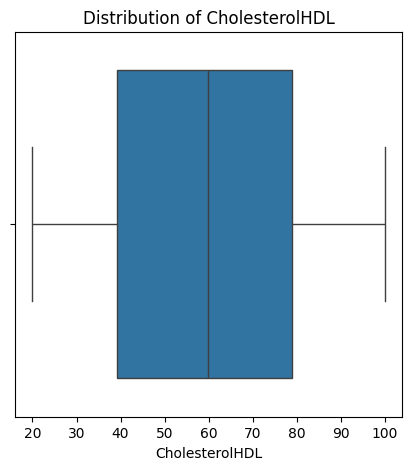

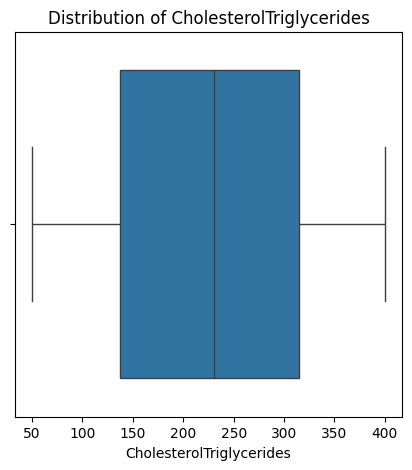

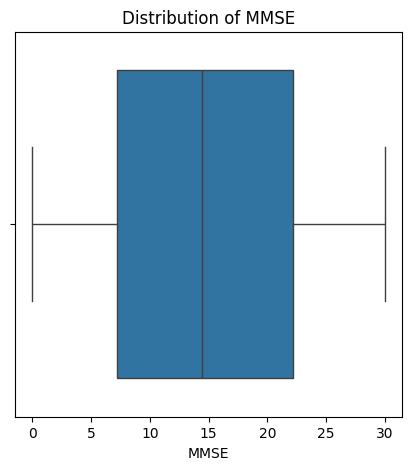

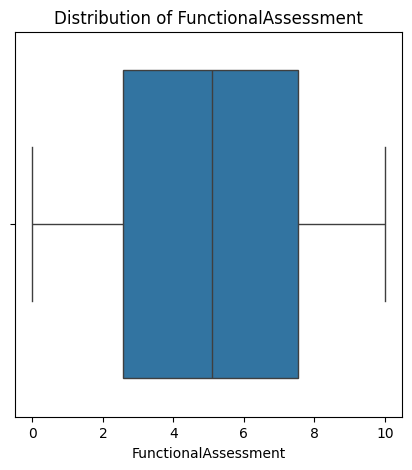

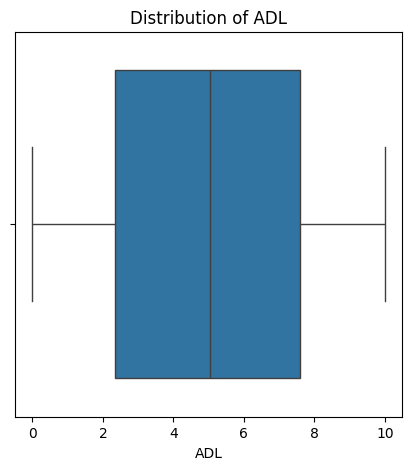

In [ ]:
#checking for outlier int the dataset
for column in numerical_columns:
    plt.figure(figsize=(5, 5))
    sns.boxplot(data=data, x=column)
    plt.title(f'Distribution of {column}')
    plt.show()

# **5.1 Taking Selected Numerical Features For Training**

In [ ]:
#balancing unbalanced data
from sklearn.model_selection import StratifiedKFold,cross_val_score
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']
skf = StratifiedKFold(n_splits=5,random_state=0,shuffle=True)
for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index] # Use .iloc to index by position
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index] # Use .iloc for the Series as well

Time taken to train the model: 0.12281084060668945
Training Accuracy: 0.7511251125112511
Training Log Loss: 0.5046238935304805
Test Accuracy: 0.7558139534883721
Test Log Loss: 0.5000989929061855
              precision    recall  f1-score   support

           0       0.86      0.75      0.80       278
           1       0.63      0.77      0.69       152

    accuracy                           0.76       430
   macro avg       0.74      0.76      0.74       430
weighted avg       0.77      0.76      0.76       430

Mean cross-validation accuracy: 0.7493420386678814
Best hyperparameters from grid search: {'C': 10}

Confusion Matrix : 
[[208  70]
 [ 35 117]]


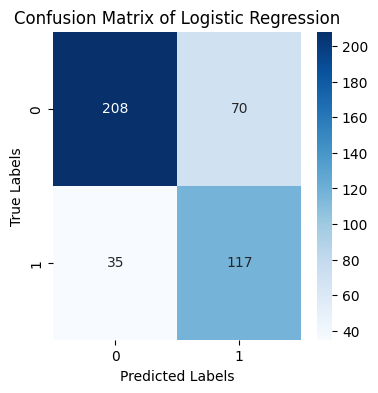

In [ ]:
#Logistic Regression

import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score, log_loss
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE

# Prepare data
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data
X_train, X_test, y_train, y_test_case1 = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define an extensive parameter grid for grid search
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10],  # Use a range of values for regularization strength
}

# Initialize the Logistic Regression model
lr = LogisticRegression(penalty="l1",solver='liblinear', random_state=42)

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, scoring='accuracy', cv=StratifiedKFold(n_splits=5))
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()

# Evaluate the best model
best_lr = grid_search.best_estimator_
y_train_pred = best_lr.predict(X_train_resampled)
y_train_prob = best_lr.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_pred_case1 = best_lr.predict(X_test_scaled)
y_test_prob = best_lr.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test_case1, y_test_pred_case1)
test_loss = log_loss(y_test_case1, y_test_prob)

# Print results
print(f"Time taken to train the model: {end_time - start_time}")
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test_case1, y_test_pred_case1))

# Cross-validation score for overall performance
cv_scores = cross_val_score(best_lr, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print(f"Mean cross-validation accuracy: {cv_scores.mean()}")

# Best hyperparameters
print(f"Best hyperparameters from grid search: {grid_search.best_params_}")

print()

#Confusion Matrix
print("Confusion Matrix : ")
print(confusion_matrix(y_test_case1, y_test_pred_case1))
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test_case1, y_test_pred_case1), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Logistic Regression')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


Time taken to train the model: 10.039258003234863
Training Accuracy: 0.8388598022105875
Training Log Loss: 0.3762877114831802
Test Accuracy: 0.8372093023255814
Test Log Loss: 0.4380492230073015
              precision    recall  f1-score   support

           0       0.81      0.99      0.89       278
           1       0.96      0.57      0.71       152

    accuracy                           0.84       430
   macro avg       0.88      0.78      0.80       430
weighted avg       0.86      0.84      0.82       430

Mean cross-validation accuracy: 0.8356936087168645
Best parameters from randomized search: {'criterion': 'entropy', 'max_depth': 3, 'min_samples_leaf': 4, 'min_samples_split': 6}


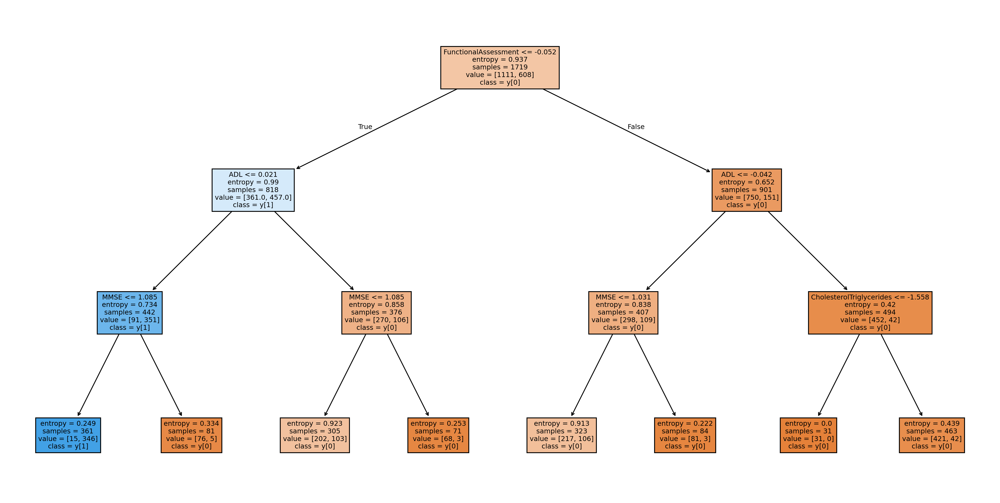


Confusion Matrix : 
[[274   4]
 [ 66  86]]


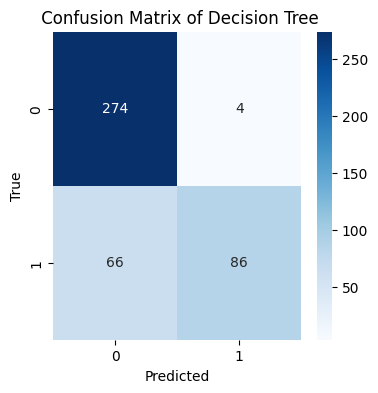

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#Decision Tree

import time
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree, DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV, cross_val_score, train_test_split
from sklearn.metrics import classification_report, accuracy_score, log_loss
from sklearn.preprocessing import StandardScaler
from scipy.stats import randint

# Prepare data (Numerical Columns)
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize numerical features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define parameter distribution for RandomizedSearchCV (for faster tuning)
param_dist = {
    'max_depth': [3, 5, 7, 12, None],
    'criterion': ['gini', 'entropy'],
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 10)
}

# Initialize the Decision Tree model
model = DecisionTreeClassifier(random_state=42)

# Perform randomized search with cross-validation
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_dist, scoring='accuracy', cv=5,random_state=42, n_jobs=-1)
start_time = time.time()
random_search.fit(X_train_scaled, y_train)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best model
best_model = random_search.best_estimator_

# Evaluate on training data
y_train_pred = best_model.predict(X_train_scaled)
y_train_prob = best_model.predict_proba(X_train_scaled)
train_accuracy = accuracy_score(y_train, y_train_pred)
train_loss = log_loss(y_train, y_train_prob)

# Evaluate on test data
y_test_pred = best_model.predict(X_test_scaled)
y_test_prob = best_model.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_loss = log_loss(y_test, y_test_prob)

# Print results
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test, y_test_pred))

# Cross-validation score
scores = cross_val_score(best_model, X, Y, scoring='accuracy', cv=5)
print("Mean cross-validation accuracy:", scores.mean())

# Best parameters from randomized search
print("Best parameters from randomized search:", random_search.best_params_)

# Plot the decision tree
plt.figure(figsize=(20, 10), dpi=300)
plot_tree(best_model, filled=True, feature_names=X.columns, class_names=True)
plt.show()

print()

#Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred)
print("Confusion Matrix : ")
print(confusion_matrix(y_test, y_test_pred))

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title(' Confusion Matrix of Decision Tree')

cm_case1 = 'cm_case1.png'
plt.savefig(cm_case1, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

# Download the saved image
files.download(cm_case1)  # Download the saved confusion matrix heatmap



Time taken to train the model: 16.478514194488525
Training Accuracy: 0.8226822682268227
Training Log Loss: 0.42776231430098505
Test Accuracy: 0.8488372093023255
Test Log Loss: 0.4321775335432175
              precision    recall  f1-score   support

           0       0.86      0.92      0.89       278
           1       0.83      0.72      0.77       152

    accuracy                           0.85       430
   macro avg       0.84      0.82      0.83       430
weighted avg       0.85      0.85      0.85       430

Mean cross-validation accuracy: 0.7984026723352566
Best parameters from randomized search: {'n_estimators': 100, 'min_samples_split': 70, 'min_samples_leaf': 50, 'max_samples': 0.7, 'max_features': 'log2', 'max_depth': 4, 'bootstrap': True}

Confusion Matrix : 
[[256  22]
 [ 43 109]]


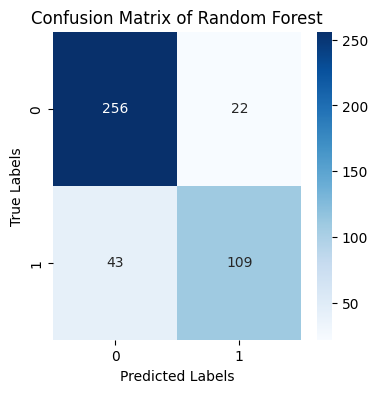

In [ ]:
#Random Forest

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.metrics import classification_report, accuracy_score, log_loss
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
import time
from sklearn.model_selection import cross_val_score

# Prepare data (Numerical Columns)
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize numerical features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to balance the class distribution in the training set
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define parameter grid for RandomizedSearchCV to minimize overfitting
param_dist = {
    'n_estimators': [50, 100, 150],  # Reduced number of trees
    'max_depth': [3, 4, 5, 7, None],  # Further restricted depth
    'min_samples_split': [50, 70],  # Increased split size
    'min_samples_leaf': [50, 70],  # Larger leaf size
    'max_features': ['sqrt', 'log2'],  # Limited number of features per split
    'max_samples': [0.7],  # Reduced fraction of data used for each tree
    'bootstrap': [True]  # Bootstrapping for randomness
}

# Initialize the Random Forest model
rf = RandomForestClassifier(random_state=42)

# Perform randomized search with cross-validation
random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_dist, scoring='accuracy', cv=5, n_iter=10, random_state=42, n_jobs=-1)
start_time = time.time()
random_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best model after hyperparameter tuning
best_rf = random_search.best_estimator_

# Evaluate the model on the training data
y_train_pred = best_rf.predict(X_train_resampled)
y_train_prob = best_rf.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

# Evaluate the model on the test data
y_test_pred = best_rf.predict(X_test_scaled)
y_test_prob = best_rf.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_loss = log_loss(y_test, y_test_prob)

# Print evaluation metrics
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test, y_test_pred))

# Cross-validation score for the best model
scores = cross_val_score(best_rf, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Mean cross-validation accuracy:", scores.mean())

# Best hyperparameters from RandomizedSearchCV
print("Best parameters from randomized search:", random_search.best_params_)

print()

#Confusion Matrix
print("Confusion Matrix : ")
print(confusion_matrix(y_test, y_test_pred))
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_test_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Random Forest')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


Time taken to train the model: 92.42018437385559
Training Accuracy: 0.8259129564782391
Training Log Loss: 0.3900660755192216
Test Accuracy: 0.8162790697674419
Test Log Loss: 0.4259544294818145
              precision    recall  f1-score   support

           0       0.82      0.91      0.86       278
           1       0.80      0.64      0.71       152

    accuracy                           0.82       430
   macro avg       0.81      0.78      0.79       430
weighted avg       0.81      0.82      0.81       430

Mean cross-validation accuracy: 0.7839122807017544
Best parameters from GridSearchCV: {'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}

Confusion Matrix : 
[[253  25]
 [ 54  98]]


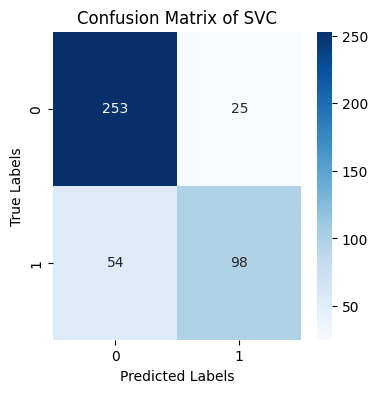

In [ ]:
#Support Vector Machine

from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, accuracy_score, log_loss
from imblearn.over_sampling import SMOTE
import time

# Prepare data (Numerical Columns)
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize numerical features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42, sampling_strategy=0.8)  # Use 80% synthetic data to balance while avoiding over-sampling
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define a tighter parameter grid for GridSearchCV
param_grid = {
    'C': [0.1,0.001, 1, 1],  # Focus on regularization to balance bias-variance trade-off
    'kernel': ['linear','rbf'],  # Linear kernel is simpler and less prone to overfitting
    'gamma': ['scale', 'auto',0.1,0.01,0.001]  # Default scale gamma for simplicity and preventing overfitting
}

# Initialize SVC
svc = SVC(probability=True)

# Perform GridSearchCV for hyperparameter tuning
grid_search = GridSearchCV(estimator=svc, param_grid=param_grid, scoring='accuracy', cv=5, n_jobs=-1)
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best model after tuning
best_svc = grid_search.best_estimator_

# Evaluate on training data
y_train_pred = best_svc.predict(X_train_resampled)
y_train_prob = best_svc.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

# Evaluate on test data
y_test_pred = best_svc.predict(X_test_scaled)
y_test_prob = best_svc.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_loss = log_loss(y_test, y_test_prob)

# Print results
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test, y_test_pred))

# Cross-validation score
scores = cross_val_score(best_svc, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Mean cross-validation accuracy:", scores.mean())

# Best hyperparameters
print("Best parameters from GridSearchCV:", grid_search.best_params_)

print()

#Confusion Matrix
print("Confusion Matrix : ")
print(confusion_matrix(y_test, y_test_pred))
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_test_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of SVC')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


In [ ]:
pip install keras-tuner

Reloading Tuner from ./untitled_project/tuner0.json


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 2 variables whereas the saved optimizer has 14 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


70/70 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6219 - loss: 0.6483 - val_accuracy: 0.7628 - val_loss: 0.5850
Epoch 2/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6495 - loss: 0.6382 - val_accuracy: 0.7674 - val_loss: 0.5670
Epoch 3/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.6617 - loss: 0.6379 - val_accuracy: 0.7535 - val_loss: 0.5640
Epoch 4/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6722 - loss: 0.6208 - val_accuracy: 0.7512 - val_loss: 0.5587
Epoch 5/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.6770 - loss: 0.6113 - val_accuracy: 0.7535 - val_loss: 0.5432
Epoch 6/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.6730 - loss: 0.6111 - val_accuracy: 0.7605 - val_loss: 0.5403
Epoch 7/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.6888 - loss: 0.6227 - val_accuracy: 0.7581 - val_loss: 0.5440
Epoch 8/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7195 - loss: 0.5938 - val_accuracy: 0.7628 - val_loss: 

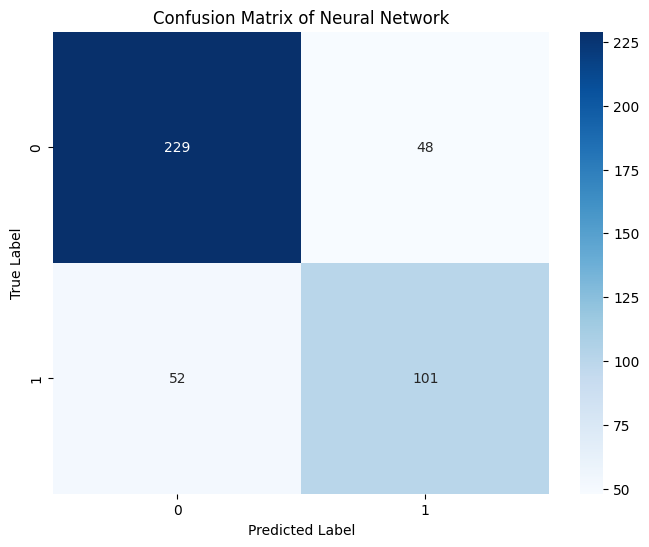


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.81      0.83      0.82       277
           1       0.68      0.66      0.67       153

    accuracy                           0.77       430
   macro avg       0.75      0.74      0.74       430
weighted avg       0.77      0.77      0.77       430

Overall Accuracy: 0.7674


In [ ]:
#Neural Network

from keras.callbacks import EarlyStopping
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, log_loss, confusion_matrix
import keras_tuner as kt
import time
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from imblearn.over_sampling import SMOTE

# Data preprocessing
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE',
        'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Model building function for Keras Tuner
def build_model(hp):
    model = Sequential()
    counter = 0
    for i in range(hp.Int('num_layers', min_value=1, max_value=5)):
        if counter == 0:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid']),
                            input_dim=9))
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.3, 0.4, 0.5, 0.6, 0.7])))
        else:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid'])))
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.3, 0.4, 0.5, 0.6, 0.7])))
        counter += 1
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=hp.Choice('optimizer', values=['adam', 'rmsprop', 'nadam']),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True)

# Tuning the model
tuner = kt.RandomSearch(build_model, objective='val_accuracy', max_trials=5)
tuner.search(X_train_resampled, y_train_resampled, epochs=20, validation_data=(X_test, y_test))

# Getting the best model
model = tuner.get_best_models(num_models=1)[0]
tuner.get_best_hyperparameters()[0].values

# Training the model with early stopping
start = time.time()
history = model.fit(X_train_resampled, y_train_resampled, epochs=100, validation_data=(X_test, y_test), callbacks=[early_stopping])
end = time.time()
print("Time taken to train the model:", end - start)

# Evaluating the model
train_loss, train_accuracy = model.evaluate(X_train_resampled, y_train_resampled, verbose=0)
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

print(f"Training Accuracy: {train_accuracy:.4f}")
print(f"Training Loss: {train_loss:.4f}")
print(f"Testing Accuracy: {test_accuracy:.4f}")
print(f"Testing Loss: {test_loss:.4f}")


# Predicting and printing classification metrics
y_test_pred = (model.predict(X_test) > 0.5).astype("int32")
y_train_pred = (model.predict(X_train_resampled) > 0.5).astype("int32")

# Confusion matrix and heatmap for test data
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix of Neural Network")
plt.show()

# Classification report for test data
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_test_pred))
# Overall accuracy
overall_accuracy = accuracy_score(y_test, y_test_pred)
print(f"Overall Accuracy: {overall_accuracy:.4f}")


In [ ]:
#Graph for NN

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()


Reloading Tuner from ./untitled_project/tuner0.json


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 14s 22ms/step - accuracy: 0.4909 - loss: 1.1604 - val_accuracy: 0.4302 - val_loss: 0.8084 - learning_rate: 0.0010
Epoch 2/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5843 - loss: 0.9287 - val_accuracy: 0.5558 - val_loss: 0.7932 - learning_rate: 0.0010
Epoch 3/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5625 - loss: 0.9083 - val_accuracy: 0.7023 - val_loss: 0.7685 - learning_rate: 0.0010
Epoch 4/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5899 - loss: 0.8672 - val_accuracy: 0.6767 - val_loss: 0.7346 - learning_rate: 0.0010
Epoch 5/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6474 - loss: 0.7691 - val_accuracy: 0.7070 - val_loss: 0.6777 - learning_rate: 0.0010
Epoch 6/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.6458 - loss: 0.7666 - val_accuracy: 0.7093 - val_loss: 0.6454 - learning_rate: 0.0010
Epoch 7/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.6588 - loss: 0.7699 - 

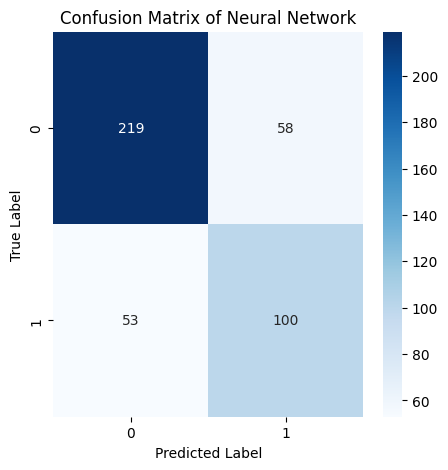


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.81      0.79      0.80       277
           1       0.63      0.65      0.64       153

    accuracy                           0.74       430
   macro avg       0.72      0.72      0.72       430
weighted avg       0.74      0.74      0.74       430

Overall Accuracy: 0.7419


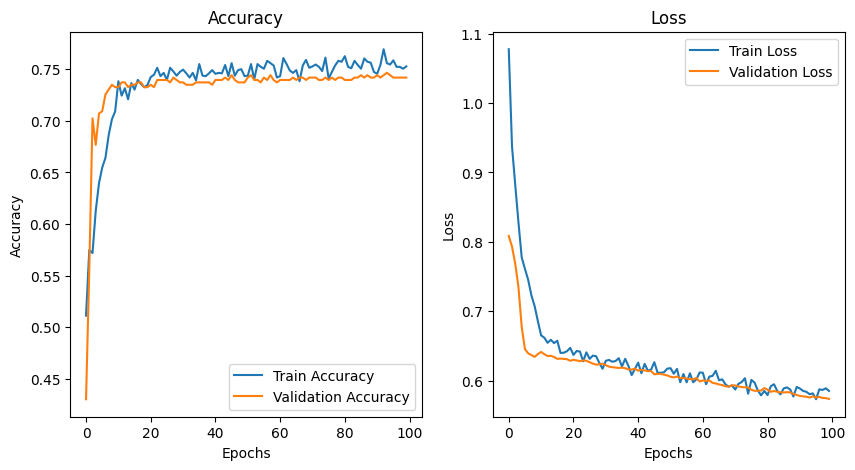

In [ ]:
#NN 3

from keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import keras_tuner as kt
import time
import matplotlib.pyplot as plt
import seaborn as sns
from imblearn.over_sampling import SMOTE

# Data preprocessing
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
          'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE',
          'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Model building function for Keras Tuner
def build_model(hp):
    model = Sequential()
    counter = 0
    for i in range(hp.Int('num_layers', min_value=1, max_value=5)):
        if counter == 0:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh']),
                            input_dim=9,
                            kernel_regularizer=l2(0.001)))  # L2 regularization, known as weight decay in the context of neural networks, is commonly applied to the weights of the neural network layers. It helps prevent overfitting by shrinking the weights, making the network less sensitive to small changes in input data
            model.add(BatchNormalization())
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.4, 0.5, 0.6, 0.7])))  # Increased dropout
        else:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh']),
                            kernel_regularizer=l2(0.001)))  # L2 regularization
            model.add(BatchNormalization())
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.4, 0.5, 0.6, 0.7])))  # Increased dropout
        counter += 1
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=hp.Choice('optimizer', values=['adam', 'rmsprop', 'nadam']),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Early stopping and ReduceLROnPlateau callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00001)
#ReduceLROnPlateau is a scheduling technique that decreases the learning rate when the specified metric stops improving for longer than the patience number allows

# Tuning the model
tuner = kt.RandomSearch(build_model, objective='val_accuracy', max_trials=5)
tuner.search(X_train_resampled, y_train_resampled, epochs=20, validation_data=(X_test, y_test))

# Getting the best model
best_hp = tuner.get_best_hyperparameters()[0] # get the best hyperparameters
model = build_model(best_hp)


# Training the model with early stopping and ReduceLROnPlateau
start = time.time()
history = model.fit(X_train_resampled, y_train_resampled, epochs=100,
                    validation_data=(X_test, y_test),
                    callbacks=[early_stopping, reduce_lr])
end = time.time()
print("Time taken to train the model:", end - start)

# Evaluating the model
train_loss, train_accuracy = model.evaluate(X_train_resampled, y_train_resampled, verbose=0)
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

print(f"Training Accuracy: {train_accuracy:.4f}")
print(f"Training Loss: {train_loss:.4f}")
print(f"Testing Accuracy: {test_accuracy:.4f}")
print(f"Testing Loss: {test_loss:.4f}")

# Predicting and printing classification metrics
y_test_pred = (model.predict(X_test) > 0.5).astype("int32")
y_train_pred = (model.predict(X_train_resampled) > 0.5).astype("int32")

# Confusion matrix and heatmap for test data
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(5, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix of Neural Network")
plt.show()

# Classification report for test data
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_test_pred))

# Overall accuracy
overall_accuracy = accuracy_score(y_test, y_test_pred)
print(f"Overall Accuracy: {overall_accuracy:.4f}")

# Plotting training and validation accuracy/loss
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()


# **5.2 Taking All Numerical Features Training**

In [ ]:
#balancing unbalanced data
from sklearn.model_selection import StratifiedKFold,cross_val_score
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']
skf = StratifiedKFold(n_splits=5,random_state=0,shuffle=True)
for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index] # Use .iloc to index by position
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index] # Use .iloc for the Series as well

Time taken to train the model: 0.24149417877197266
Training Accuracy: 0.7632763276327633
Training Log Loss: 0.5032612906805731
Test Accuracy: 0.7418604651162791
Test Log Loss: 0.5033080898860818
              precision    recall  f1-score   support

           0       0.85      0.73      0.79       278
           1       0.61      0.76      0.68       152

    accuracy                           0.74       430
   macro avg       0.73      0.75      0.73       430
weighted avg       0.76      0.74      0.75       430

Mean cross-validation accuracy: 0.7560937341836218
Best hyperparameters from grid search: {'C': 1}

Confusion Matrix : 
[[203  75]
 [ 36 116]]


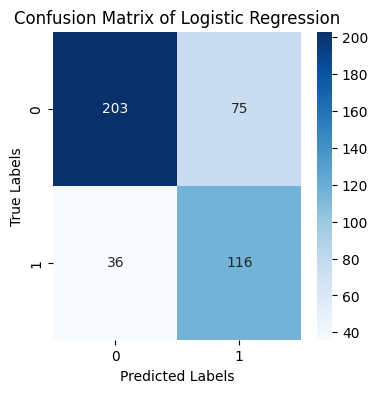

In [ ]:
#Logistic Regression

import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score, log_loss
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE

# Prepare data
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data
X_train, X_test, y_train, y_test_case2 = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)


# Define an extensive parameter grid for grid search
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10],  # Use a range of values for regularization strength
    # 'max_iter': [100, 200, 300],  # Ensure convergence with different iterations
    # 'tol': [1e-4, 1e-5, 1e-6],  # Convergence tolerance
    # 'warm_start': [True, False]  # Whether to reuse the solution of the previous call to fit
}

# Initialize the Logistic Regression model
lr = LogisticRegression(penalty="l1",solver='liblinear', random_state=42)

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, scoring='accuracy', cv=StratifiedKFold(n_splits=5))
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()

# Evaluate the best model
best_lr = grid_search.best_estimator_
y_train_pred = best_lr.predict(X_train_resampled)
y_train_prob = best_lr.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_pred_case2 = best_lr.predict(X_test_scaled)
y_test_prob = best_lr.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test_case2, y_test_pred_case2)
test_loss = log_loss(y_test_case2, y_test_prob)

# Print results
print(f"Time taken to train the model: {end_time - start_time}")
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test_case2, y_test_pred_case2))

# Cross-validation score for overall performance
cv_scores = cross_val_score(best_lr, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print(f"Mean cross-validation accuracy: {cv_scores.mean()}")

# Best hyperparameters
print(f"Best hyperparameters from grid search: {grid_search.best_params_}")

print()

#Confusion Matrix
print("Confusion Matrix : ")
print(confusion_matrix(y_test_case2, y_test_pred_case2))
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test_case2, y_test_pred_case2), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Logistic Regression')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


Time taken to train the model: 7.460927248001099
Training Accuracy: 0.840023269342641
Training Log Loss: 0.37505148459065385
Test Accuracy: 0.8325581395348837
Test Log Loss: 0.5267361871449014
              precision    recall  f1-score   support

           0       0.80      0.98      0.88       278
           1       0.93      0.57      0.70       152

    accuracy                           0.83       430
   macro avg       0.87      0.77      0.79       430
weighted avg       0.85      0.83      0.82       430

Mean cross-validation accuracy: 0.8352284924377947
Best parameters from randomized search: {'criterion': 'entropy', 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 4}


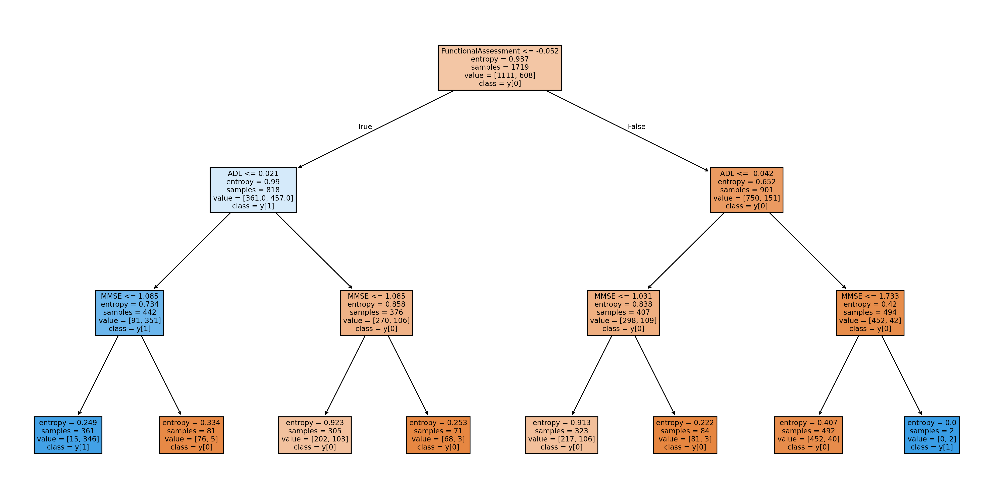


Confusion Matrix : 
[[272   6]
 [ 66  86]]


Text(0.5, 1.0, ' Confusion Matrix of Decision Tree')

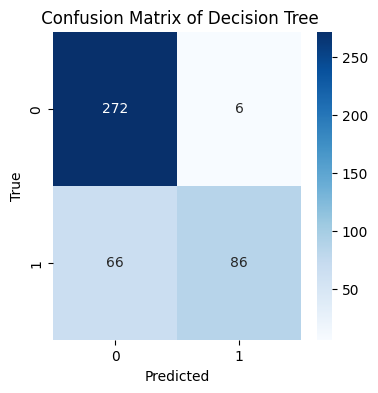

In [ ]:
#Decision Tree

import time
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree, DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV, cross_val_score, train_test_split
from sklearn.metrics import classification_report, accuracy_score, log_loss
from sklearn.preprocessing import StandardScaler
from scipy.stats import randint

# Prepare data (Numerical Columns)
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize numerical features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define parameter distribution for RandomizedSearchCV (for faster tuning)
param_dist = {
    'max_depth': [3, 5, 7, 12, None],
    'criterion': ['gini', 'entropy'],
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 10)
}

# Initialize the Decision Tree model
model = DecisionTreeClassifier(splitter='best',random_state=42)

# Perform randomized search with cross-validation
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_dist, scoring='accuracy', cv=5,random_state=42, n_jobs=-1)
start_time = time.time()
random_search.fit(X_train_scaled, y_train)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best model
best_model = random_search.best_estimator_

# Evaluate on training data
y_train_pred = best_model.predict(X_train_scaled)
y_train_prob = best_model.predict_proba(X_train_scaled)
train_accuracy = accuracy_score(y_train, y_train_pred)
train_loss = log_loss(y_train, y_train_prob)

# Evaluate on test data
y_test_pred = best_model.predict(X_test_scaled)
y_test_prob = best_model.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_loss = log_loss(y_test, y_test_prob)

# Print results
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test, y_test_pred))

# Cross-validation score
scores = cross_val_score(best_model, X, Y, scoring='accuracy', cv=5)
print("Mean cross-validation accuracy:", scores.mean())

# Best parameters from randomized search
print("Best parameters from randomized search:", random_search.best_params_)

# Plot the decision tree
plt.figure(figsize=(20, 10), dpi=300)
plot_tree(best_model, filled=True, feature_names=X.columns, class_names=True)
plt.show()


print()

#Confusion Matrix
print("Confusion Matrix : ")
cm1 = confusion_matrix(y_test, y_test_pred)
print(cm1)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm1, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title(' Confusion Matrix of Decision Tree')

# cm_case2 = 'cm_case2.png'
# plt.savefig(cm_case2, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# # Show the plot
# plt.show()

# # Download the saved image
# files.download(cm_case2)  # Download the saved confusion matrix heatmap

Time taken to train the model: 25.173900604248047
Training Accuracy: 0.8371
Training Log Loss: 0.4654
Test Accuracy: 0.8256
Test Log Loss: 0.4817
              precision    recall  f1-score   support

           0       0.84      0.90      0.87       278
           1       0.79      0.68      0.73       152

    accuracy                           0.83       430
   macro avg       0.82      0.79      0.80       430
weighted avg       0.82      0.83      0.82       430

Mean cross-validation accuracy: 0.7997307419779329
Best parameters from randomized search: {'n_estimators': 150, 'min_samples_split': 50, 'min_samples_leaf': 70, 'max_samples': 0.7, 'max_features': 'sqrt', 'max_depth': 6, 'bootstrap': True}

Confusion Matrix:


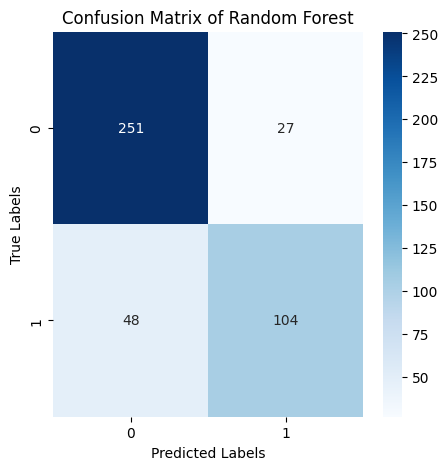

In [ ]:
#Random Forest

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV, train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score, log_loss, confusion_matrix
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

# Prepare data (Numerical Columns)
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize numerical features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to balance the class distribution in the training set
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define parameter grid for RandomizedSearchCV to minimize overfitting
param_dist = {
    'n_estimators': [50, 100, 150],  # Reduced number of trees
    'max_depth': [3, 4, 5, 6],  # Further restricted depth
    'min_samples_split': [50, 70],  # Increased split size
    'min_samples_leaf': [50, 70],  # Larger leaf size
    'max_features': ['sqrt', 'log2'],  # Limited number of features per split
    'max_samples': [0.7],  # Reduced fraction of data used for each tree
    'bootstrap': [True]  # Bootstrapping for randomness
}

# Initialize the Random Forest model
rf = RandomForestClassifier(random_state=42)

# Stratified K-Fold Cross-Validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Perform randomized search with cross-validation
random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_dist, scoring='accuracy', cv=cv, n_iter=10, random_state=42, n_jobs=-1)
start_time = time.time()
random_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best model after hyperparameter tuning
best_rf = random_search.best_estimator_

# Evaluate the model on the training data
y_train_pred = best_rf.predict(X_train_resampled)
y_train_prob = best_rf.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

# Evaluate the model on the test data
y_test_pred = best_rf.predict(X_test_scaled)
y_test_prob = best_rf.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_loss = log_loss(y_test, y_test_prob)

# Print evaluation metrics
print(f"Training Accuracy: {train_accuracy:.4f}")
print(f"Training Log Loss: {train_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test Log Loss: {test_loss:.4f}")
print(classification_report(y_test, y_test_pred))

# Cross-validation score for the best model
scores = cross_val_score(best_rf, X_train_resampled, y_train_resampled, scoring='accuracy', cv=cv)
print("Mean cross-validation accuracy:", scores.mean())

# Best hyperparameters from RandomizedSearchCV
print("Best parameters from randomized search:", random_search.best_params_)

# Confusion Matrix
print("\nConfusion Matrix:")
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(5, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix of Random Forest')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Time taken to train the model: 14.863500118255615
Training Accuracy: 0.7638819409704852
Training Log Loss: 0.5034501380215002
Test Accuracy: 0.7813953488372093
Test Log Loss: 0.4866219050849185
              precision    recall  f1-score   support

           0       0.84      0.82      0.83       278
           1       0.69      0.70      0.69       152

    accuracy                           0.78       430
   macro avg       0.76      0.76      0.76       430
weighted avg       0.78      0.78      0.78       430

Mean cross-validation accuracy: 0.7538922305764411
Best parameters from GridSearchCV: {'C': 0.1}

Confusion Matrix : 
[[229  49]
 [ 45 107]]


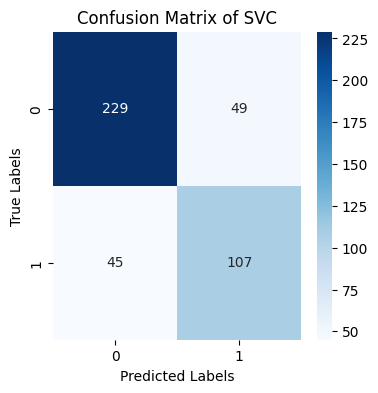

In [ ]:
#Support Vector Machine

from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, accuracy_score, log_loss
from imblearn.over_sampling import SMOTE
import time

# Prepare data (Numerical Columns)
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']

# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42, stratify=Y)

# Standardize numerical features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42, sampling_strategy=0.8)  # Use 80% synthetic data to balance while avoiding over-sampling
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define a tighter parameter grid for GridSearchCV
param_grid = {
    'C': [0.1, 1]  # Focus on regularization to balance bias-variance trade-off
}


# Initialize SVC
svc = SVC(probability=True,kernel='linear')

# Perform GridSearchCV for hyperparameter tuning
grid_search = GridSearchCV(estimator=svc, param_grid=param_grid, scoring='accuracy', cv=5, n_jobs=-1)
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best model after tuning
best_svc = grid_search.best_estimator_

# Evaluate on training data
y_train_pred = best_svc.predict(X_train_resampled)
y_train_prob = best_svc.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

# Evaluate on test data
y_test_pred = best_svc.predict(X_test_scaled)
y_test_prob = best_svc.predict_proba(X_test_scaled)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_loss = log_loss(y_test, y_test_prob)

# Print results
print(f"Training Accuracy: {train_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Test Log Loss: {test_loss}")
print(classification_report(y_test, y_test_pred))

# Cross-validation score
scores = cross_val_score(best_svc, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Mean cross-validation accuracy:", scores.mean())

# Best hyperparameters
print("Best parameters from GridSearchCV:", grid_search.best_params_)

print()

#Confusion Matrix
print("Confusion Matrix : ")
print(confusion_matrix(y_test, y_test_pred))
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_test_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of SVC')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
pip install keras-tuner


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 2.7 MB/s eta 0:00:00


Reloading Tuner from ./untitled_project/tuner0.json
Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


70/70 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.5000 - loss: 0.7251 - val_accuracy: 0.3558 - val_loss: 0.6988
Epoch 2/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4886 - loss: 0.7047 - val_accuracy: 0.6465 - val_loss: 0.6908
Epoch 3/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5101 - loss: 0.6961 - val_accuracy: 0.6651 - val_loss: 0.6899
Epoch 4/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5025 - loss: 0.6951 - val_accuracy: 0.4535 - val_loss: 0.6937
Epoch 5/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5184 - loss: 0.6922 - val_accuracy: 0.5140 - val_loss: 0.6930
Epoch 6/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5054 - loss: 0.6934 - val_accuracy: 0.3581 - val_loss: 0.6949
Epoch 7/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5155 - loss: 0.6939 - val_accuracy: 0.5000 - val_loss: 0.6925
Epoch 8/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5034 - loss: 0.6919 - val_accuracy: 0.6628 - val_loss: 0.6

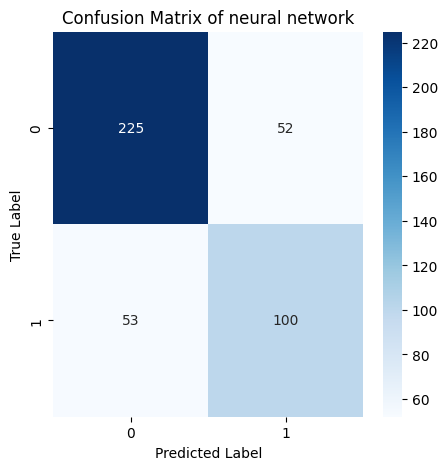


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.81      0.81      0.81       277
           1       0.66      0.65      0.66       153

    accuracy                           0.76       430
   macro avg       0.73      0.73      0.73       430
weighted avg       0.76      0.76      0.76       430

Overall Accuracy: 0.7558


In [ ]:
#NN

from keras.callbacks import EarlyStopping
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, log_loss, confusion_matrix
import keras_tuner as kt
import time
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from imblearn.over_sampling import SMOTE

# Data preprocessing
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Model building function for Keras Tuner
def build_model(hp):
    model = Sequential()
    counter = 0
    for i in range(hp.Int('num_layers', min_value=1, max_value=5)):
        if counter == 0:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid']),
                            input_dim=15))
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.3, 0.4, 0.5, 0.6, 0.7])))
        else:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid'])))
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.3, 0.4, 0.5, 0.6, 0.7])))
        counter += 1
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=hp.Choice('optimizer', values=['adam', 'rmsprop', 'nadam']),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True)

# Tuning the model
tuner = kt.RandomSearch(build_model, objective='val_accuracy', max_trials=5)
tuner.search(X_train_resampled, y_train_resampled, epochs=20, validation_data=(X_test, y_test))

# Getting the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials = 1)[0]

# Building the model with the best hyperparameters
model = build_model(best_hps)

# Training the model with early stopping
start = time.time()
history = model.fit(X_train_resampled, y_train_resampled, epochs=100, validation_data=(X_test, y_test), callbacks=[early_stopping])
end = time.time()
print("Time taken to train the model:", end - start)

# Evaluating the model
train_loss, train_accuracy = model.evaluate(X_train_resampled, y_train_resampled, verbose=0)
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

print(f"Training Accuracy: {train_accuracy:.4f}")
print(f"Training Loss: {train_loss:.4f}")
print(f"Testing Accuracy: {test_accuracy:.4f}")
print(f"Testing Loss: {test_loss:.4f}")


# Predicting and printing classification metrics
y_test_pred = (model.predict(X_test) > 0.5).astype("int32")
y_train_pred = (model.predict(X_train_resampled) > 0.5).astype("int32")

# Confusion matrix and heatmap for test data
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(5, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix of neural network")
plt.show()

# Classification report for test data
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_test_pred))
# Overall accuracy
overall_accuracy = accuracy_score(y_test, y_test_pred)
print(f"Overall Accuracy: {overall_accuracy:.4f}")


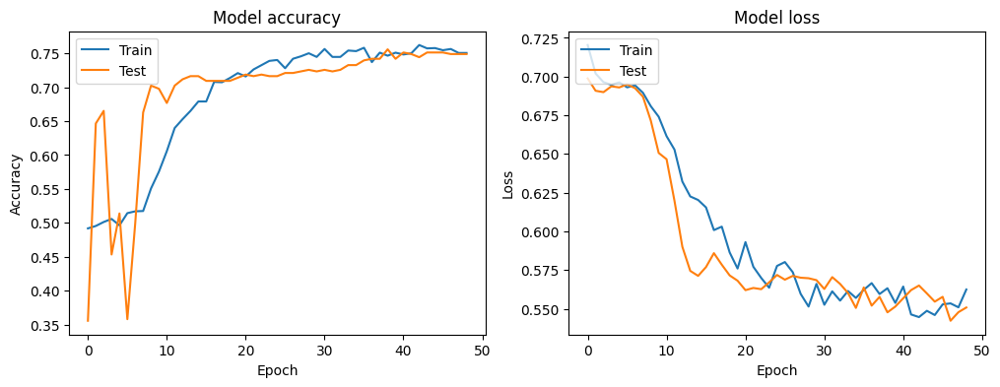

In [ ]:
#Graph for NN 1

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()


Reloading Tuner from ./untitled_project/tuner0.json


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.5111 - loss: 0.7181 - val_accuracy: 0.3558 - val_loss: 0.6965
Epoch 2/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.5090 - loss: 0.7019 - val_accuracy: 0.3558 - val_loss: 0.6996
Epoch 3/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.5152 - loss: 0.6950 - val_accuracy: 0.3558 - val_loss: 0.6997
Epoch 4/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5044 - loss: 0.6975 - val_accuracy: 0.3558 - val_loss: 0.6977
Epoch 5/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.4950 - loss: 0.6960 - val_accuracy: 0.3651 - val_loss: 0.6953
Epoch 6/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5339 - loss: 0.6902 - val_accuracy: 0.4884 - val_loss: 0.6924
Epoch 7/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5610 - loss: 0.6833 - val_accuracy: 0.6140 - val_loss: 0.6835
Epoch 8/100
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5446 - loss: 0.6824 - val_accuracy: 0.6256 - 

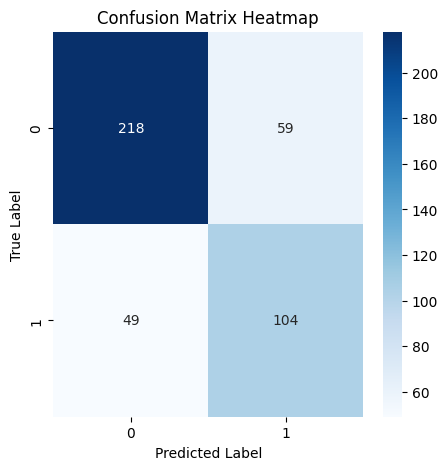


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.82      0.79      0.80       277
           1       0.64      0.68      0.66       153

    accuracy                           0.75       430
   macro avg       0.73      0.73      0.73       430
weighted avg       0.75      0.75      0.75       430

Overall Accuracy: 0.7488


In [ ]:
#NN 2

from keras.callbacks import EarlyStopping
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, log_loss, confusion_matrix
import keras_tuner as kt
import time
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from imblearn.over_sampling import SMOTE

# Data preprocessing
X = data[['Age', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality',
          'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL',
          'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Apply SMOTE to balance class distribution
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Model building function for Keras Tuner
def build_model(hp):
    model = Sequential()
    counter = 0
    for i in range(hp.Int('num_layers', min_value=1, max_value=5)):
        if counter == 0:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid']),
                            input_dim=15))
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.3, 0.4, 0.5, 0.6, 0.7])))
        else:
            model.add(Dense(hp.Int('units' + str(i), min_value=16, max_value=64, step=16),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid'])))
            model.add(Dropout(hp.Choice('dropout' + str(i), values=[0.3, 0.4, 0.5, 0.6, 0.7])))
        counter += 1
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=hp.Choice('optimizer', values=['adam', 'rmsprop', 'nadam']),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)

# Tuning the model
tuner = kt.RandomSearch(build_model, objective='val_accuracy', max_trials=5)
tuner.search(X_train_resampled, y_train_resampled, epochs=20, validation_data=(X_test, y_test))

# Getting the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials = 1)[0]

# Building the model with the best hyperparameters
model = build_model(best_hps)

# Training the model with early stopping
start = time.time()
history = model.fit(X_train_resampled, y_train_resampled, epochs=100, validation_data=(X_test, y_test), callbacks=[early_stopping])
end = time.time()
print("Time taken to train the model:", end - start)

# Evaluating the model
train_loss, train_accuracy = model.evaluate(X_train_resampled, y_train_resampled, verbose=0)
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

print(f"Training Accuracy: {train_accuracy:.4f}")
print(f"Training Loss: {train_loss:.4f}")
print(f"Testing Accuracy: {test_accuracy:.4f}")
print(f"Testing Loss: {test_loss:.4f}")


# Predicting and printing classification metrics
y_test_pred = (model.predict(X_test) > 0.5).astype("int32")
y_train_pred = (model.predict(X_train_resampled) > 0.5).astype("int32")

# Confusion matrix and heatmap for test data
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(5, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix Heatmap")
plt.show()

# Classification report for test data
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_test_pred))
# Overall accuracy
overall_accuracy = accuracy_score(y_test, y_test_pred)
print(f"Overall Accuracy: {overall_accuracy:.4f}")


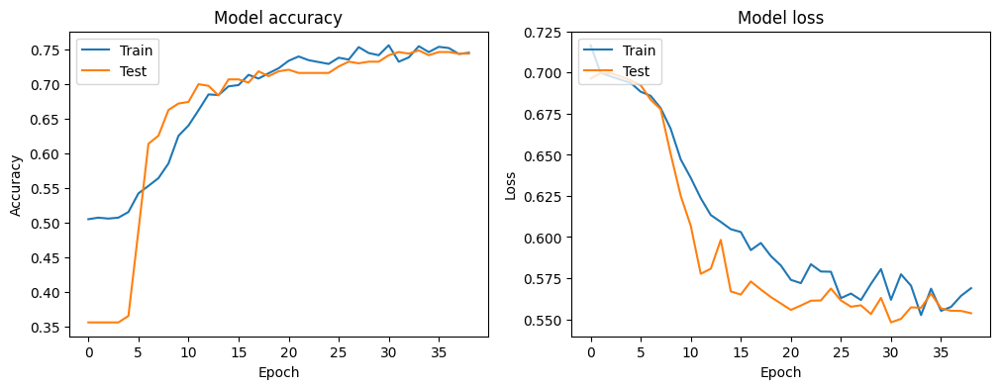

In [ ]:
#Graph for NN 1

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()


# **5.3 Taking selected Categorical Features For Training**

In [ ]:
# #balancing unbalanced data
from sklearn.model_selection import StratifiedKFold,cross_val_score
X = data[['BehavioralProblems','MemoryComplaints']]
Y = data['Diagnosis']
skf = StratifiedKFold(n_splits=5,random_state=0,shuffle=True)
for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index] # Use .iloc to index by position
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index] # Use .iloc for the Series as well

In [ ]:
print(y_train.value_counts())

Diagnosis
0    1112
1     608
Name: count, dtype: int64


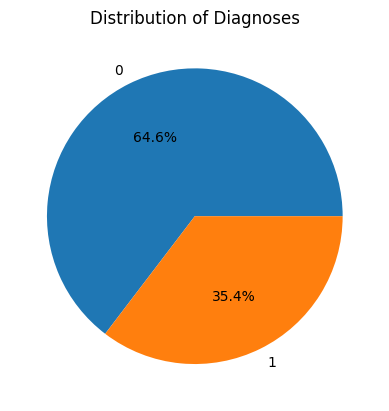

In [ ]:
diagnosis_counts = data['Diagnosis'].value_counts()

# Create the pie chart
plt.pie(diagnosis_counts, labels=diagnosis_counts.index, autopct='%1.1f%%')
plt.title('Distribution of Diagnoses')
plt.show()

Training Accuracy: 0.6857014388489209
Test Accuracy: 0.7395348837209302
Training Log Loss: 0.6480476727794291
Test Log Loss: 0.6428459003322536
Test ROC-AUC Score: 0.7122531322998514
Time taken by the model: 8.613390684127808
              precision    recall  f1-score   support

           0       0.78      0.82      0.80       277
           1       0.65      0.59      0.62       153

    accuracy                           0.74       430
   macro avg       0.72      0.71      0.71       430
weighted avg       0.74      0.74      0.74       430

ROC-AUC Score after cross-validation: 0.6856797246684887
Best parameters found by GridSearch: {'C': 0.001, 'class_weight': 'balanced', 'max_iter': 100, 'penalty': 'l2', 'solver': 'liblinear'}


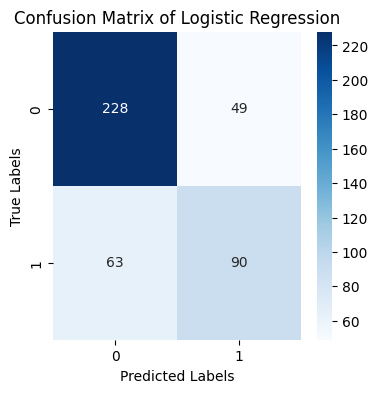

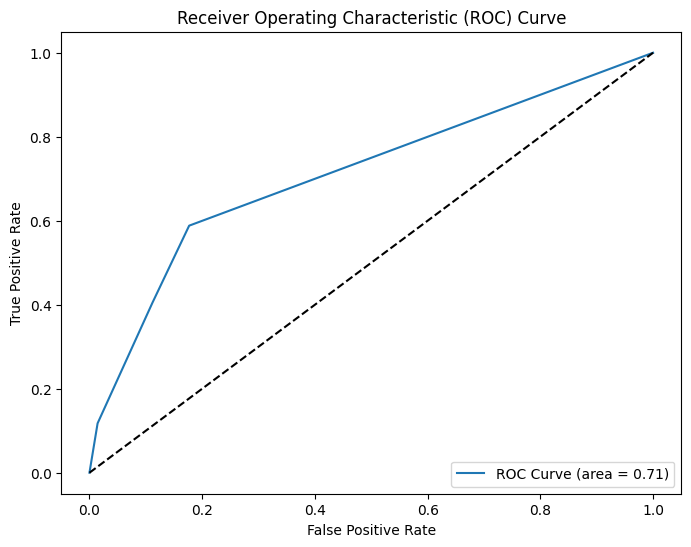

Optimal Threshold: 0.5667330635402184


In [ ]:
#Logistic Regression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, StratifiedKFold, cross_val_score, train_test_split
from sklearn.metrics import classification_report, accuracy_score, log_loss, roc_auc_score, confusion_matrix, roc_curve
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import time

# Data Preparation
X = data[['BehavioralProblems','MemoryComplaints']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test_case3 = train_test_split(X, Y, test_size=0.2, random_state=42)

# Feature Scaling
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Resampling with SMOTE
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Model with Grid Search
param_grid = {
    'C': [0.001, 0.01, 0.1, 0.5, 1, 10],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga'],
    'max_iter': [100, 200, 300],
    'class_weight': ['balanced', None]
}

lr = LogisticRegression(random_state=0)
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, scoring='accuracy', cv=5)
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()

# Best Estimator
best_lr = grid_search.best_estimator_

# Training Performance
y_train_pred = best_lr.predict(X_train_resampled)
y_train_prob = best_lr.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

# Test Performance
y_pred_case3 = best_lr.predict(X_test)
y_test_prob = best_lr.predict_proba(X_test)
test_accuracy = accuracy_score(y_test_case3, y_pred_case3)
test_loss = log_loss(y_test_case3, y_test_prob)
roc_auc = roc_auc_score(y_test_case3, y_test_prob[:, 1])

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print(f"Test ROC-AUC Score: {roc_auc}")
print("Time taken by the model:", end_time - start_time)

print(classification_report(y_test_case3, y_pred_case3))

# Cross Validation Score
score = cross_val_score(best_lr, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("ROC-AUC Score after cross-validation:", score.mean())

# Best Parameters
print("Best parameters found by GridSearch:", grid_search.best_params_)

# Confusion Matrix
conf_matrix = confusion_matrix(y_test_case3, y_pred_case3)
plt.figure(figsize=(4, 4))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix of Logistic Regression')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# ROC Curve and Threshold Tuning
fpr, tpr, thresholds = roc_curve(y_test_case3, y_test_prob[:, 1])
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

# Find optimal threshold
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print("Optimal Threshold:", optimal_threshold)


Training Accuracy: 0.6857014388489209
Test Accuracy: 0.7395348837209302
Training Log Loss: 0.6143184555863143
Test Log Loss: 0.5952781094036219
time taken by the model 8.410497903823853
              precision    recall  f1-score   support

           0       0.78      0.82      0.80       277
           1       0.65      0.59      0.62       153

    accuracy                           0.74       430
   macro avg       0.72      0.71      0.71       430
weighted avg       0.74      0.74      0.74       430

Value after cross validation 0.6856797246684887
Best parameter for regularization strength C: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 5, 'min_samples_split': 5}
Confusion Matrix : 
[[228  49]
 [ 63  90]]


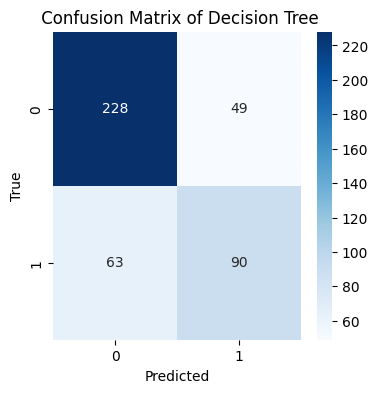

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Decision Tree
from sklearn.tree import plot_tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report,accuracy_score,log_loss
from imblearn.over_sampling import SMOTE
from collections import Counter

X = data[['BehavioralProblems','MemoryComplaints']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

param_grids = { 'max_depth': [ 5, 7,10],'min_samples_split':[5,6,7,10],'criterion' :['entropy','gini'],'min_samples_leaf':[5,6,7,10]}

dt = DecisionTreeClassifier(random_state=42)
grid_search = GridSearchCV(dt,param_grids, scoring='accuracy', cv=5)
start_time=time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time=time.time()
best_dt=grid_search.best_estimator_
y_pred = best_dt.predict(X_test)

y_train_pred = best_dt.predict(X_train_resampled)
y_train_prob = best_dt.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_prob = best_dt.predict_proba(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
test_loss = log_loss(y_test, y_test_prob)
roc_auc = roc_auc_score(y_test, y_test_prob[:, 1])

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("time taken by the model",end_time-start_time)

print(classification_report(y_test, y_pred))
score=cross_val_score(best_dt, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Value after cross validation",score.mean())
print("Best parameter for regularization strength C:", grid_search.best_params_)

#Confusion Matrix
print("Confusion Matrix : ")
cm_3 = confusion_matrix(y_test, y_pred)
print(cm_3)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm_3, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title(' Confusion Matrix of Decision Tree')

cm_case3 = 'cm_case3.png'
plt.savefig(cm_case3, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

# Download the saved image
files.download(cm_case3)  # Download the saved confusion matrix heatmap

/usr/local/lib/python3.10/dist-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Training Accuracy: 0.6857014388489209
Test Accuracy: 0.7395348837209302
Training Log Loss: 0.6143330129671299
Test Log Loss: 0.5949111543427833
time taken by the model 241.59069228172302
              precision    recall  f1-score   support

           0       0.78      0.82      0.80       277
           1       0.65      0.59      0.62       153

    accuracy                           0.74       430
   macro avg       0.72      0.71      0.71       430
weighted avg       0.74      0.74      0.74       430

Value after cross validation 0.6856797246684887
Best parameter for regularization strength C: {'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 5, 'n_estimators': 50}


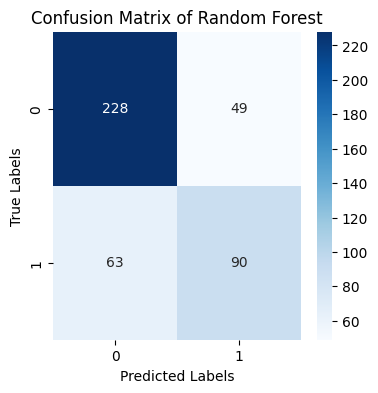

In [ ]:
# Random Forest
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report,accuracy_score,log_loss
from imblearn.over_sampling import SMOTE

X = data[['BehavioralProblems','MemoryComplaints']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
param_grid = {'n_estimators': [50, 100, 200,150],'max_depth':[5,6,7,10],'min_samples_split':[5,6,7,10],'min_samples_leaf':[10,15,20]}

rf=RandomForestClassifier(random_state=42)
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, scoring='accuracy', cv=5)
start_time=time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time=time.time()

best_rf=grid_search.best_estimator_
y_pred=best_rf.predict(X_test)

y_train_pred = best_rf.predict(X_train_resampled)
y_train_prob = best_rf.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_prob = best_rf.predict_proba(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
test_loss = log_loss(y_test, y_test_prob)

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("time taken by the model",end_time-start_time)

print(classification_report(y_test, y_pred))
score=cross_val_score(best_rf, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Value after cross validation",score.mean())
print("Best parameter for regularization strength C:", grid_search.best_params_)
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Random Forest')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

Training Accuracy: 0.6857014388489209
Test Accuracy: 0.7395348837209302
Training Log Loss: 0.6189220158409134
Test Log Loss: 0.5972947221696572
time taken by the model 42.633273124694824
              precision    recall  f1-score   support

           0       0.78      0.82      0.80       277
           1       0.65      0.59      0.62       153

    accuracy                           0.74       430
   macro avg       0.72      0.71      0.71       430
weighted avg       0.74      0.74      0.74       430

Value after cross validation 0.6856797246684887
Best parameter for regularization strength C: {'C': 0.01, 'kernel': 'poly'}


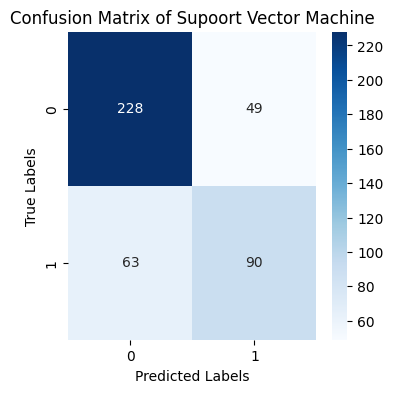

In [ ]:
#Support Vector Machine
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report,accuracy_score,log_loss
from imblearn.over_sampling import SMOTE

X = data[['BehavioralProblems','MemoryComplaints']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Remove 'precomputed' from the kernel options as you are not providing a precomputed kernel matrix
param_grid={'C':[0.001,0.01,0.1,1],'kernel':['linear','poly','rbf','sigmoid']}

svc=SVC(probability=True)
grid_search = GridSearchCV(svc, param_grid, scoring='accuracy', cv=5)
start_time=time.time()
grid_search.fit(X_train_resampled,y_train_resampled)
end_time=time.time()

best_svc=grid_search.best_estimator_
y_pred=best_svc.predict(X_test)

y_train_pred = best_svc.predict(X_train_resampled)
y_train_prob = best_svc.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_prob = best_svc.predict_proba(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
test_loss = log_loss(y_test, y_test_prob)

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("time taken by the model",end_time-start_time)

print(classification_report(y_test, y_pred))
score=cross_val_score(best_svc, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Value after cross validation",score.mean())
print("Best parameter for regularization strength C:", grid_search.best_params_)

plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Supoort Vector Machine')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
pip install keras-tuner

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report,log_loss
import keras_tuner as kt
from imblearn.over_sampling import SMOTE
from keras.callbacks import EarlyStopping
X = data[['BehavioralProblems', 'MemoryComplaints']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [ ]:
def build_model(hp):
  model=Sequential()
  counter=0
  for i in range(hp.Int('num_layers',min_value=1,max_value=10)):
    if counter==0:
      model.add(Dense(hp.Int('units'+str(i),min_value=8,max_value=64,step=8),activation=hp.Choice('activation'+str(i),values=['relu','tanh','sigmoid']),input_dim=2))
      model.add(Dropout(hp.Choice('dropout'+str(i),values=[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])))
    else:
      model.add(Dense(hp.Int('units'+str(i),min_value=8,max_value=64,step=8),activation=hp.Choice('activation'+str(i),values=['relu','tanh','sigmoid'])))
      model.add(Dropout(hp.Choice('dropout'+str(i),values=[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])))
    counter+=1
  model.add(Dense(1,activation='sigmoid'))
  model.compile(optimizer=hp.Choice('optimizer',values=['adam','sgd','rmsprop','nadam','adadelta']),loss='binary_crossentropy',metrics=['accuracy'])
  return model

In [ ]:
tuner=kt.RandomSearch(build_model,objective='val_accuracy',max_trials=5)
tuner.search(X_train_resampled,y_train_resampled,epochs=5,validation_data=(X_test,y_test),callbacks=[EarlyStopping(monitor='val_accuracy',patience=3)])
model=tuner.get_best_models(num_models=1)[0]
best_param=tuner.get_best_hyperparameters()[0].values
start=time.time()
history=model.fit(X_train,y_train,epochs=100,validation_data=(X_test,y_test))
end=time.time()
print("time taken to train the data",end-start)
print('best param',best_param)

Reloading Tuner from ./untitled_project/tuner0.json


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.4870 - loss: 1.0335 - val_accuracy: 0.6442 - val_loss: 0.6506
Epoch 2/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.5349 - loss: 0.8683 - val_accuracy: 0.6442 - val_loss: 0.6507
Epoch 3/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5448 - loss: 0.7842 - val_accuracy: 0.6442 - val_loss: 0.6512
Epoch 4/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.5801 - loss: 0.7482 - val_accuracy: 0.6442 - val_loss: 0.6508
Epoch 5/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5646 - loss: 0.7117 - val_accuracy: 0.6442 - val_loss: 0.6509
Epoch 6/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6192 - loss: 0.6804 - val_accuracy: 0.6442 - val_loss: 0.6520
Epoch 7/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5976 - loss: 0.6765 - val_accuracy: 0.6442 - val_loss: 0.6516
Epoch 8/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6115 - loss: 0.6783 - val_accuracy: 0.644

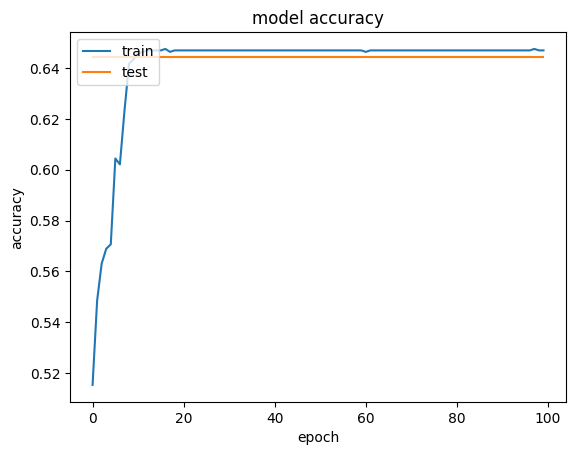

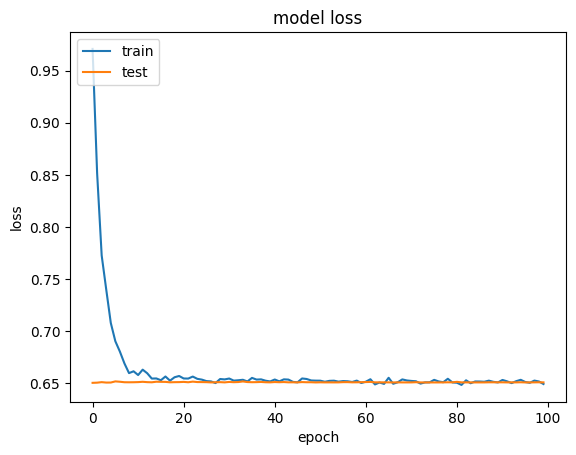

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
# Predict the labels for the test set
y_pred = (model.predict(X_test)).astype("int32")

print(classification_report(y_test, y_pred))

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
              precision    recall  f1-score   support

           0       0.64      1.00      0.78       277
           1       0.00      0.00      0.00       153

    accuracy                           0.64       430
   macro avg       0.32      0.50      0.39       430
weighted avg       0.41      0.64      0.50       430



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from scikeras.wrappers import KerasClassifier
model = KerasClassifier(model=tuner.get_best_models(num_models=1)[0], epochs=100)

# Now you can use cross_val_score
score=cross_val_score(model, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print(score.mean())

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.4864 - loss: 1.0382
Epoch 2/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.4964 - loss: 0.9008
Epoch 3/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.5078 - loss: 0.8428
Epoch 4/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4859 - loss: 0.7928
Epoch 5/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.4982 - loss: 0.7453
Epoch 6/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5161 - loss: 0.7189
Epoch 7/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4911 - loss: 0.7142
Epoch 8/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5174 - loss: 0.6984
Epoch 9/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.5184 - loss: 0.6964
Epoch 10/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.5060 - loss: 0.6999
Epoch 11/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5039 - loss: 0.6956
Epoch 12/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy:

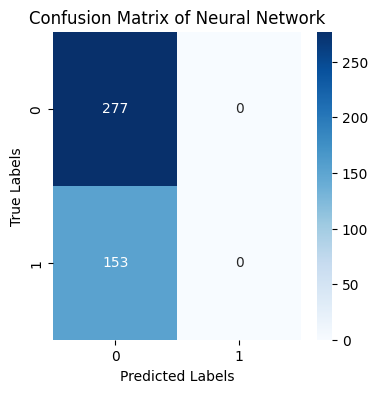

In [ ]:
plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Neural Network')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

Non final (without using smote)

# **5.4 Taking all Categorical features For Training**

Training Accuracy: 0.6636690647482014
Test Accuracy: 0.6558139534883721
Training Log Loss: 0.6376524376348037
Test Log Loss: 0.6347191806545903
time taken by the model 25.40910816192627
              precision    recall  f1-score   support

           0       0.76      0.68      0.72       277
           1       0.51      0.61      0.56       153

    accuracy                           0.66       430
   macro avg       0.64      0.65      0.64       430
weighted avg       0.67      0.66      0.66       430

Value after cross validation 0.6524142119647738
Best parameter for regularization strength C: {'C': 0.01, 'class_weight': 'balanced', 'max_iter': 100, 'penalty': 'l2', 'solver': 'saga'}


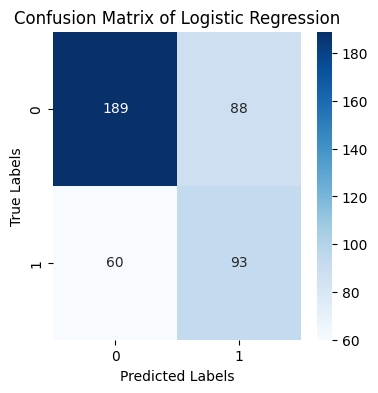

In [ ]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split
from sklearn.metrics import classification_report, accuracy_score, log_loss
from imblearn.over_sampling import SMOTE
from collections import Counter
X = data[['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes', 'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity', 'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'PersonalityChanges', 'Smoking']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test_case4 = train_test_split(X, Y, test_size=0.2, random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
param_grid = {'C': [0.001, 0.01, 0.1, 0.5, 1,10],
              'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga'],
    'max_iter': [100, 200, 300],
    'class_weight': ['balanced', None]}
lr=LogisticRegression(random_state=42)
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, scoring='accuracy', cv=5)
start_time=time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time=time.time()
best_lr=grid_search.best_estimator_
y_pred_case4=best_lr.predict(X_test)

y_train_pred = best_lr.predict(X_train_resampled)
y_train_prob = best_lr.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_prob = best_lr.predict_proba(X_test)
test_accuracy = accuracy_score(y_test_case4, y_pred_case4)
test_loss = log_loss(y_test, y_test_prob)

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("time taken by the model",end_time-start_time)

print(classification_report(y_test_case4, y_pred_case4))
score=cross_val_score(best_lr, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Value after cross validation",score.mean())
print("Best parameter for regularization strength C:", grid_search.best_params_)

plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test_case4, y_pred_case4), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Logistic Regression')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


In [ ]:
print(Counter(y_train_resampled))

Counter({0: 1112, 1: 1112})


Training Accuracy: 0.6569244604316546
Test Accuracy: 0.7372093023255814
Training Log Loss: 0.6286914545080423
Test Log Loss: 0.6094946984869474
Time taken by the model: 6.334090232849121
              precision    recall  f1-score   support

           0       0.78      0.82      0.80       277
           1       0.64      0.58      0.61       153

    accuracy                           0.74       430
   macro avg       0.71      0.70      0.71       430
weighted avg       0.73      0.74      0.73       430

Cross-Validation Accuracy: 0.6465502581232918
Best parameters found by GridSearch: {'criterion': 'entropy', 'max_depth': 3, 'min_samples_leaf': 5, 'min_samples_split': 10, 'splitter': 'best'}


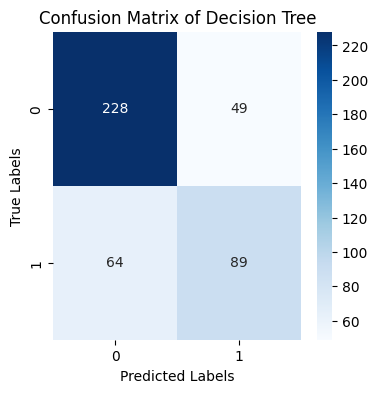

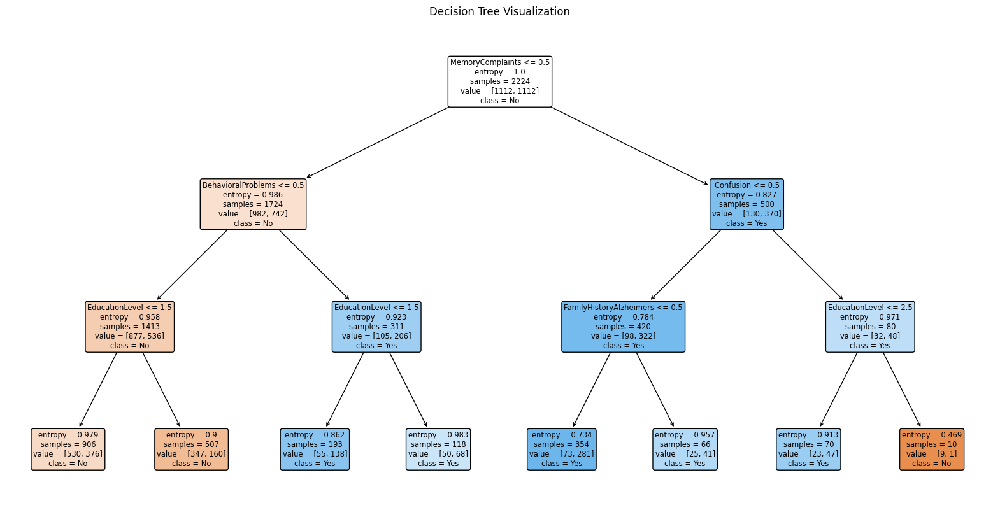

In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split
from sklearn.metrics import classification_report, accuracy_score, log_loss, confusion_matrix
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import time

# Assuming the data is already loaded in the 'data' variable
X = data[['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes',
          'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity',
          'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension',
          'MemoryComplaints', 'PersonalityChanges', 'Smoking']]
Y = data['Diagnosis']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Resampling the training data using SMOTE
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Hyperparameter grid with stricter constraints to reduce overfitting
param_grids = {
    'max_depth': [3, 5, 7],  # Limiting tree depth
    'min_samples_split': [10, 15, 20],  # Increasing the minimum samples to split
    'min_samples_leaf': [5, 10, 15],  # Adding min_samples_leaf to control the minimum number of samples at a leaf node
    'criterion': ['entropy', 'gini'],  # Criteria for splitting
    'splitter': ['best']  # Choosing the best split at each node
}

# Initialize the Decision Tree Classifier
dt = DecisionTreeClassifier(random_state=42, class_weight='balanced')

# GridSearchCV for hyperparameter tuning
grid_search = GridSearchCV(dt, param_grids, scoring='accuracy', cv=5)

# Timing the training process
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()

# Best Decision Tree model after grid search
best_dt = grid_search.best_estimator_

# Training Performance
y_train_pred = best_dt.predict(X_train_resampled)
y_train_prob = best_dt.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

# Test Performance
y_pred = best_dt.predict(X_test)
y_test_prob = best_dt.predict_proba(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
test_loss = log_loss(y_test, y_test_prob)

# Model Evaluation
print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("Time taken by the model:", end_time - start_time)

print(classification_report(y_test, y_pred))

# Cross Validation Score
score = cross_val_score(best_dt, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Cross-Validation Accuracy:", score.mean())

# Best Parameters
print("Best parameters found by GridSearch:", grid_search.best_params_)

# Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(4, 4))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix of Decision Tree')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Visualizing the decision tree
plt.figure(figsize=(20, 10))
plot_tree(best_dt, feature_names=X.columns, class_names=['No', 'Yes'], filled=True, rounded=True)
plt.title('Decision Tree Visualization')
plt.show()


Training Accuracy: 0.7135791366906474
Test Accuracy: 0.6930232558139535
Training Log Loss: 0.5746644787017103
Test Log Loss: 0.6148912103646922
time taken by the model 394.1520166397095
              precision    recall  f1-score   support

           0       0.78      0.74      0.76       277
           1       0.56      0.61      0.59       153

    accuracy                           0.69       430
   macro avg       0.67      0.68      0.67       430
weighted avg       0.70      0.69      0.70       430

Value after cross validation 0.667245672638931
Best parameter for regularization strength C: {'max_depth': 10, 'min_samples_leaf': 10, 'min_samples_split': 5, 'n_estimators': 50}


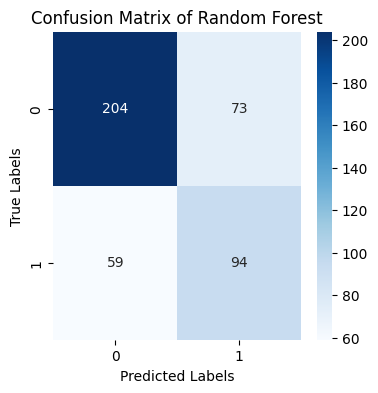

In [ ]:
# Random Forest
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report,accuracy_score,log_loss
from imblearn.over_sampling import SMOTE

X = data[['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes', 'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity', 'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'PersonalityChanges', 'Smoking']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
param_grid = {'n_estimators': [50, 100, 200,150],'max_depth':[5,6,7,10],'min_samples_split':[5,6,7,10],'min_samples_leaf':[10,15,20]}

rf=RandomForestClassifier(random_state=42)
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, scoring='accuracy', cv=5)
start_time=time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time=time.time()

best_rf=grid_search.best_estimator_
y_pred=best_rf.predict(X_test)

y_train_pred = best_rf.predict(X_train_resampled)
y_train_prob = best_rf.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_prob = best_rf.predict_proba(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
test_loss = log_loss(y_test, y_test_prob)

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("time taken by the model",end_time-start_time)

print(classification_report(y_test, y_pred))
score=cross_val_score(best_rf, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Value after cross validation",score.mean())
print("Best parameter for regularization strength C:", grid_search.best_params_)

plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Random Forest')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
#SVC
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report,accuracy_score,log_loss
from imblearn.over_sampling import SMOTE

X = data[['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes', 'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity', 'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'PersonalityChanges', 'Smoking']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Remove 'precomputed' from the kernel options as you are not providing a precomputed kernel matrix
param_grid={'C':[0.001,0.01,0.1,1],'kernel':['linear','poly','rbf','sigmoid'] ,'gamma':[0.001,0.01,0.1]}

svc=SVC(probability=True)
grid_search = GridSearchCV(svc, param_grid, scoring='accuracy', cv=5)
start_time=time.time()
grid_search.fit(X_train_resampled,y_train_resampled)
end_time=time.time()

best_svc=grid_search.best_estimator_
y_pred=best_svc.predict(X_test)

y_train_pred = best_svc.predict(X_train_resampled)
y_train_prob = best_svc.predict_proba(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
train_loss = log_loss(y_train_resampled, y_train_prob)

y_test_prob = best_svc.predict_proba(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
test_loss = log_loss(y_test, y_test_prob)

print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")
print(f"Training Log Loss: {train_loss}")
print(f"Test Log Loss: {test_loss}")
print("time taken by the model",end_time-start_time)

print(classification_report(y_test, y_pred))
score=cross_val_score(best_svc, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print("Value after cross validation",score.mean())
print("Best parameter for regularization strength C:", grid_search.best_params_)

plt.figure(figsize=(4, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d',cmap='Blues')
plt.title('Confusion Matrix of Support Vector Machine')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 2.5 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report,log_loss
import keras_tuner as kt
from imblearn.over_sampling import SMOTE
from keras.callbacks import EarlyStopping
X = data[['BehavioralProblems', 'CardiovascularDisease', 'Confusion', 'Depression', 'Diabetes', 'DifficultyCompletingTasks', 'Disorientation', 'EducationLevel', 'Ethnicity', 'FamilyHistoryAlzheimers', 'Forgetfulness', 'Gender', 'HeadInjury', 'Hypertension', 'MemoryComplaints', 'PersonalityChanges', 'Smoking']]
Y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=42)
smote = SMOTE(random_state=0)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [ ]:
def build_model(hp):
  model=Sequential()
  counter=0
  for i in range(hp.Int('num_layers',min_value=1,max_value=10)):
    if counter==0:
      model.add(Dense(hp.Int('units'+str(i),min_value=32,max_value=128,step=32),activation=hp.Choice('activation'+str(i),values=['relu','tanh','sigmoid']),input_dim=17))
      model.add(Dropout(hp.Choice('dropout'+str(i),values=[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])))
    else:
      model.add(Dense(hp.Int('units'+str(i),min_value=32,max_value=128,step=32),activation=hp.Choice('activation'+str(i),values=['relu','tanh','sigmoid'])))
      model.add(Dropout(hp.Choice('dropout'+str(i),values=[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])))
    counter+=1
  model.add(Dense(1,activation='sigmoid'))
  model.compile(optimizer=hp.Choice('optimizer',values=['adam','sgd','rmsprop','nadam','adadelta']),loss='binary_crossentropy',metrics=['accuracy'])
  return model

In [ ]:
tuner=kt.RandomSearch(build_model,objective='val_accuracy',max_trials=5,directory='result')
tuner.search(X_train_resampled,y_train_resampled,epochs=5,validation_data=(X_test,y_test),callbacks=[EarlyStopping(monitor='val_accuracy',patience=10)])
model=tuner.get_best_models(num_models=1)[0]
best_param=tuner.get_best_hyperparameters()[0].values
start=time.time()
history=model.fit(X_train,y_train,epochs=100,validation_data=(X_test,y_test))
end=time.time()
print("time taken to train the data",end-start)
print('best param',best_param)

Trial 5 Complete [00h 00m 27s]
val_accuracy: 0.6441860198974609

Best val_accuracy So Far: 0.7093023061752319
Total elapsed time: 00h 01m 05s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 2 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Epoch 1/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 23ms/step - accuracy: 0.6732 - loss: 0.6436 - val_accuracy: 0.7116 - val_loss: 0.5792
Epoch 2/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.6675 - loss: 0.6360 - val_accuracy: 0.7070 - val_loss: 0.5824
Epoch 3/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6479 - loss: 0.6421 - val_accuracy: 0.7279 - val_loss: 0.5716
Epoch 4/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.6744 - loss: 0.6245 - val_accuracy: 0.7279 - val_loss: 0.5705
Epoch 5/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6921 - loss: 0.6064 - val_accuracy: 0.7209 - val_loss: 0.5709
Epoch 6/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.6693 - loss: 0.6129 - val_accuracy: 0.7302 - val_loss: 0.5676
Epoch 7/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.6730 - loss: 0.6196 - val_accuracy: 0.7209 - val_loss: 0.5687
Epoch 8/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7070 - loss: 0.6003 - val_accuracy: 0.7

In [ ]:
print(tuner.get_best_hyperparameters()[0].values)

{'num_layers': 2, 'units0': 48, 'activation0': 'tanh', 'dropout0': 0.1, 'optimizer': 'adam', 'units1': 64, 'activation1': 'tanh', 'dropout1': 0.8, 'units2': 64, 'activation2': 'relu', 'dropout2': 0.5, 'units3': 16, 'activation3': 'relu', 'dropout3': 0.7, 'units4': 48, 'activation4': 'relu', 'dropout4': 0.2, 'units5': 16, 'activation5': 'sigmoid', 'dropout5': 0.2, 'units6': 64, 'activation6': 'relu', 'dropout6': 0.3, 'units7': 32, 'activation7': 'relu', 'dropout7': 0.3}


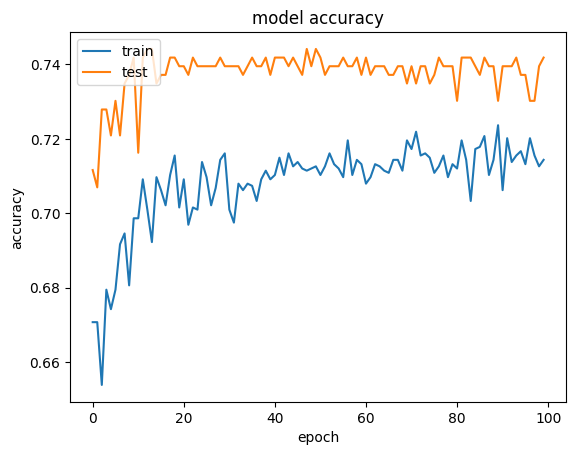

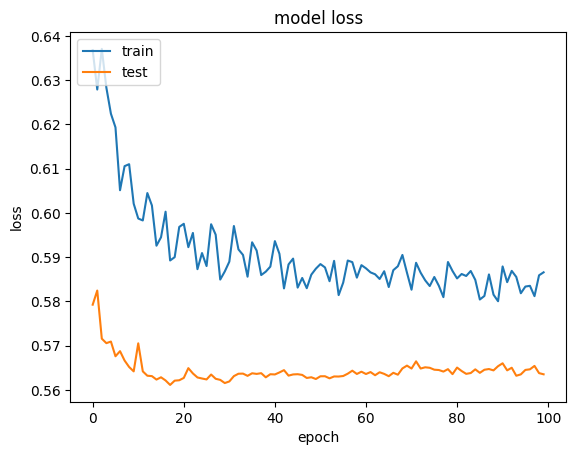

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
!pip install scikeras

In [ ]:
y_pred=model.predict(X_test)
y_pred=(y_pred>0.5)
print(classification_report(y_test, y_pred))

14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
              precision    recall  f1-score   support

           0       0.77      0.84      0.81       277
           1       0.66      0.56      0.60       153

    accuracy                           0.74       430
   macro avg       0.72      0.70      0.71       430
weighted avg       0.74      0.74      0.74       430



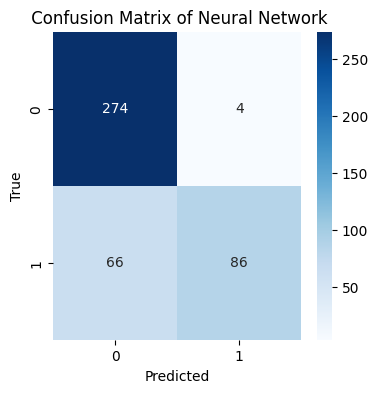

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Calculate the confusion matrix
#print("Confusion matrix")
cm_4 = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title(' Confusion Matrix of Neural Network')

cm_case4 = 'cm_case4.png'
plt.savefig(cm_case4, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

# Download the saved image
files.download(cm_case4)  # Download the saved confusion matrix heatmap

In [ ]:
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import cross_val_score
model = KerasClassifier(model=tuner.get_best_models(num_models=1)[0], epochs=100)

# Now you can use cross_val_score
score=cross_val_score(model, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print(score.mean())

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 14 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 14 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


56/56 ━━━━━━━━━━━━━━━━━━━━ 9s 61ms/step - accuracy: 0.5868 - loss: 0.6732
Epoch 2/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6006 - loss: 0.6754
Epoch 3/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.6193 - loss: 0.6569
Epoch 4/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6578 - loss: 0.6301
Epoch 5/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6459 - loss: 0.6490
Epoch 6/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6411 - loss: 0.6436
Epoch 7/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6688 - loss: 0.6242
Epoch 8/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.6598 - loss: 0.6277
Epoch 9/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6363 - loss: 0.6347
Epoch 10/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6526 - loss: 0.6171
Epoch 11/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6616 - loss: 0.6283
Epoch 12/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6637 - l

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 14 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step - accuracy: 0.6041 - loss: 0.6773
Epoch 2/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6163 - loss: 0.6602
Epoch 3/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6355 - loss: 0.6411
Epoch 4/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6288 - loss: 0.6624
Epoch 5/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6435 - loss: 0.6583
Epoch 6/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.6342 - loss: 0.6404
Epoch 7/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6268 - loss: 0.6462
Epoch 8/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6557 - loss: 0.6259
Epoch 9/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6536 - loss: 0.6298
Epoch 10/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6723 - loss: 0.6122
Epoch 11/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6656 - loss: 0.6218
Epoch 12/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6484 - l

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 14 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


56/56 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - accuracy: 0.6169 - loss: 0.6715
Epoch 2/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6142 - loss: 0.6587
Epoch 3/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6201 - loss: 0.6609
Epoch 4/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6394 - loss: 0.6386
Epoch 5/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6723 - loss: 0.6223
Epoch 6/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6432 - loss: 0.6318
Epoch 7/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6491 - loss: 0.6401
Epoch 8/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6417 - loss: 0.6493
Epoch 9/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.6300 - loss: 0.6370
Epoch 10/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6423 - loss: 0.6366
Epoch 11/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6467 - loss: 0.6330
Epoch 12/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6782 - l

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 14 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 23ms/step - accuracy: 0.5661 - loss: 0.7026
Epoch 2/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5931 - loss: 0.6805
Epoch 3/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6037 - loss: 0.6560
Epoch 4/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6331 - loss: 0.6546
Epoch 5/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6259 - loss: 0.6608
Epoch 6/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6462 - loss: 0.6367
Epoch 7/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6295 - loss: 0.6378
Epoch 8/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6446 - loss: 0.6419
Epoch 9/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6416 - loss: 0.6375
Epoch 10/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6357 - loss: 0.6387
Epoch 11/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6399 - loss: 0.6396
Epoch 12/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6174 - l

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 14 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - accuracy: 0.6001 - loss: 0.6663
Epoch 2/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6301 - loss: 0.6557
Epoch 3/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6636 - loss: 0.6468
Epoch 4/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6384 - loss: 0.6439
Epoch 5/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6552 - loss: 0.6407
Epoch 6/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6372 - loss: 0.6560
Epoch 7/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6597 - loss: 0.6248
Epoch 8/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6606 - loss: 0.6245
Epoch 9/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6592 - loss: 0.6363
Epoch 10/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6486 - loss: 0.6422
Epoch 11/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6453 - loss: 0.6405
Epoch 12/100
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6845 - l

# **5.5 Taking Selected Mix Features(Selected Numerical + Selected Categorical) For Training**

In [ ]:
from sklearn.model_selection import StratifiedKFold,cross_val_score
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL', 'BehavioralProblems','MemoryComplaints']]
y = data['Diagnosis']

skf = StratifiedKFold(n_splits=5,random_state=0,shuffle=True)
for train_index, test_index in skf.split(X, y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index] # Use .iloc to index by position
    y_train, y_test = y.iloc[train_index], y.iloc[test_index] # Use .iloc for the Series as well

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Time taken to train the model: 6.175622463226318
Best Parameters: {'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}
Cross-Validation Scores: 0.7965634173499342
Training Accuracy: 0.7947794779477948
Test Accuracy: 0.7953488372093023
Training Log Loss: 0.428426509013933
Test Log Loss: 0.44386778192555326
Confusion Matrix:
 [[131  21]
 [ 67 211]]
Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.76      0.83       278
           1       0.66      0.86      0.75       152

    accuracy                           0.80       430
   macro avg       0.79      0.81      0.79       430
weighted avg       0.82      0.80      0.80       430

ROC AUC Score: 0.8916130253691783


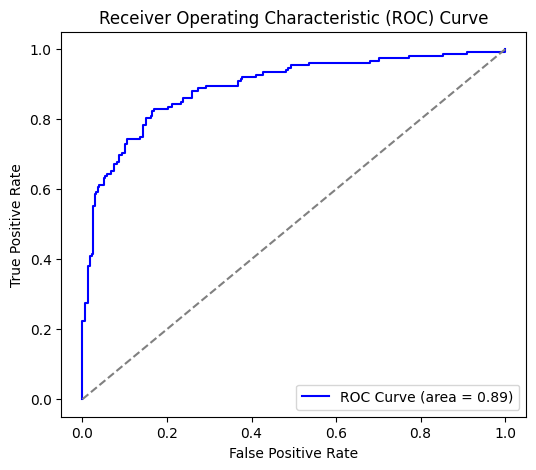

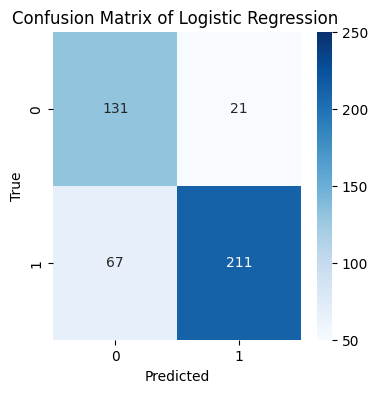

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

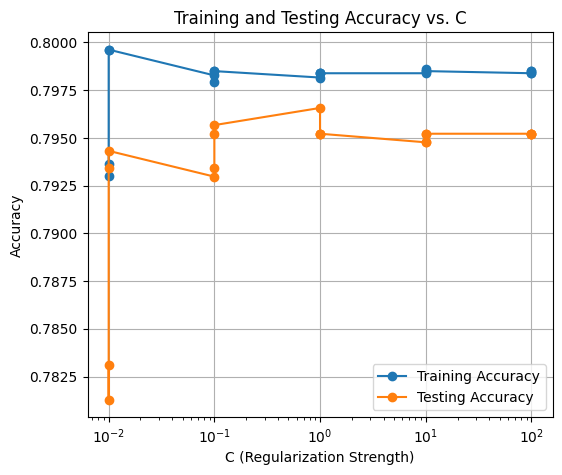

In [ ]:
# Logistic Regression
import time
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, log_loss, confusion_matrix, classification_report, roc_auc_score, roc_curve
from imblearn.over_sampling import SMOTE

X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides','MMSE',
        'FunctionalAssessment', 'ADL', 'BehavioralProblems','MemoryComplaints']]
y = data['Diagnosis']

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test_case5 = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Applying SMOTE to balance the classes in the training set
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Scaling the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Defining the parameter grid
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
}

# Initializing the logistic regression model
model = LogisticRegression(max_iter=100, class_weight='balanced')

# Setting up GridSearchCV
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1, return_train_score=True)

# Timing the model training
start_time = time.time()
grid_search.fit(X_train_scaled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Extracting the best model and best parameters
print(f"Best Parameters: {grid_search.best_params_}")
# Calculating cross-validation
print("Cross-Validation Scores:", grid_search.best_score_)

best_model = grid_search.best_estimator_

# Calculating training accuracy
y_train_pred = best_model.predict(X_train_scaled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predicting the test set and calculating test accuracy
y_pred_case5 = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test_case5, y_pred_case5)
print(f"Test Accuracy: {accuracy}")

# Calculating log loss for the training set
y_train_prob = best_model.predict_proba(X_train_scaled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculating log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test_case5, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Generating the confusion matrix and classification report
cm = confusion_matrix(y_test_case5, y_pred_case5, labels=[1, 0])
report = classification_report(y_test_case5, y_pred_case5)
print("Confusion Matrix:\n", cm)
print("Classification Report:\n", report)
roc_auc = roc_auc_score(y_test_case5, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# ROC Curve
fpr, tpr, thresholds = roc_curve(y_test_case5, best_model.predict_proba(X_test_scaled)[:, 1])
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, color='blue', label=f'ROC Curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(False)
plt.show()

print()

# Confusion Matrix Heatmap with fixed scale
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'],
            yticklabels=['0', '1'], vmin=50, vmax=250,
            cbar_kws={'ticks': [50, 100, 150, 200, 250]})  # Fixed color bar range
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix of Logistic Regression ')

# Save the confusion matrix heatmap
confusion_matrix_filename = 'confusion_matrix_1.png'
plt.savefig(confusion_matrix_filename, dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

# Download the saved image
files.download(confusion_matrix_filename)

print()

# Plotting training and testing accuracy for different values of C
results = grid_search.cv_results_
mean_train_scores = results['mean_train_score']
mean_test_scores = results['mean_test_score']
param_C = [param['C'] for param in results['params']]

plt.figure(figsize=(6, 5))
plt.plot(param_C, mean_train_scores, label='Training Accuracy', marker='o')
plt.plot(param_C, mean_test_scores, label='Testing Accuracy', marker='o')
plt.xscale('log')  # Since C varies on a logarithmic scale
plt.xlabel('C (Regularization Strength)')
plt.ylabel('Accuracy')
plt.title('Training and Testing Accuracy vs. C')
plt.legend()
plt.grid(True)
plt.show()


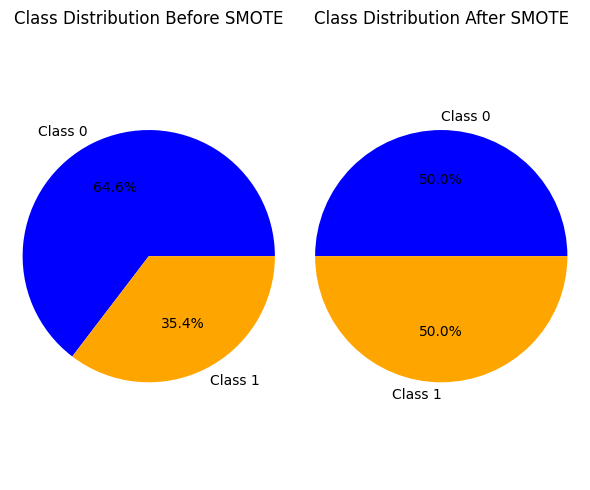

In [ ]:
import matplotlib.pyplot as plt

# Plotting class distribution before SMOTE
plt.figure(figsize=(6, 5))

plt.subplot(1, 2, 1)
plt.title('Class Distribution Before SMOTE')
plt.pie(np.bincount(y_train), labels=['Class 0', 'Class 1'], autopct='%1.1f%%', colors=['blue', 'orange'])
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Applying SMOTE to balance the classes in the training set
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Plotting class distribution after SMOTE
plt.subplot(1, 2, 2)
plt.title('Class Distribution After SMOTE')
plt.pie(np.bincount(y_train_resampled), labels=['Class 0', 'Class 1'], autopct='%1.1f%%', colors=['blue', 'orange'])
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.tight_layout()
plt.show()


Fitting 5 folds for each of 144 candidates, totalling 720 fits


/usr/local/lib/python3.10/dist-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Time taken to train the model: 16.92679452896118
Best Parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 5, 'min_samples_split': 5, 'splitter': 'best'}
Best Cross-Validation Score: 0.9437544285858891
Training Accuracy: 0.950945094509451
Test Accuracy: 0.9465116279069767
Training Log Loss: 0.1868051007672408
Test Log Loss: 0.21320329797940435
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.96      0.96       278
           1       0.93      0.91      0.92       152

    accuracy                           0.95       430
   macro avg       0.94      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430

ROC AUC Score: 0.9385531048845134


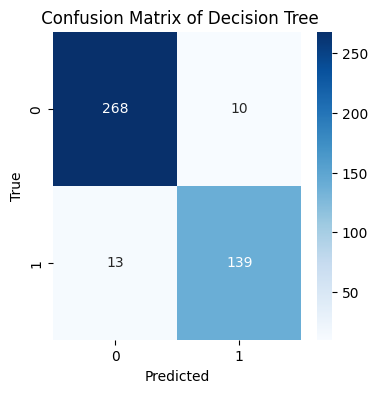

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Decision Tree
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score, log_loss
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

# Features and target
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
          'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE',
          'FunctionalAssessment', 'ADL', 'BehavioralProblems', 'MemoryComplaints']]
y = data['Diagnosis']

# Split the data with stratification to maintain the class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define the parameter grid for GridSearchCV
param_grid = {
    'max_depth': [3, 5, 7, 10],
    'min_samples_split': [5, 10, 15],  # Increase values
    'min_samples_leaf': [5, 10, 15],   # Increase values
    'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random']
}


# Initialize the DecisionTreeClassifier
model = DecisionTreeClassifier(random_state=42, class_weight='balanced', ccp_alpha=0.01)

# Setup GridSearchCV
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)

# Timing the model training
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best parameters and best score
print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# Use the best model for predictions
best_model = grid_search.best_estimator_

# Calculate training accuracy
y_train_pred = best_model.predict(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predict on the test data
y_pred = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy}")

# Calculate log loss for the training set
y_train_prob = best_model.predict_proba(X_train_resampled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculate log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

# ROC AUC Score
roc_auc = roc_auc_score(y_test, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'], yticklabels=['0', '1'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title(' Confusion Matrix of Decision Tree')

confusion_matrix_2 = 'confusion_matrix2.png'
plt.savefig(confusion_matrix_2, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

# Download the saved image
files.download(confusion_matrix_2)  # Download the saved confusion matrix heatmap

Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
30 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
15 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1466, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/_

Time taken to train the model: 10.17021894454956
Best Parameters: {'n_estimators': 150, 'min_samples_split': 2, 'min_samples_leaf': 6, 'max_samples': 0.7, 'max_features': 'sqrt', 'max_depth': 7, 'bootstrap': True}
Best Cross-Validation Score: 0.9482548840975807
Training Accuracy: 0.9576957695769577
Test Accuracy: 0.9558139534883721
Training Log Loss: 0.21480185539059587
Test Log Loss: 0.2774467853207612
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.97       278
           1       0.95      0.93      0.94       152

    accuracy                           0.96       430
   macro avg       0.95      0.95      0.95       430
weighted avg       0.96      0.96      0.96       430

ROC AUC Score: 0.9425407042786823


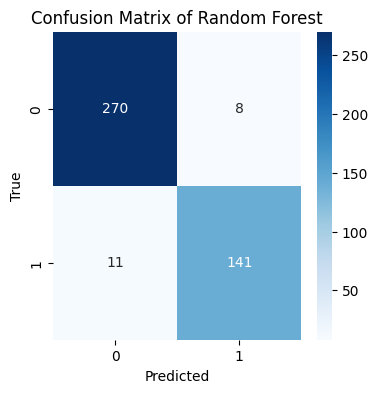

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#Random Forest
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, log_loss, roc_auc_score
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

# Features and target
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
          'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE',
          'FunctionalAssessment', 'ADL', 'BehavioralProblems', 'MemoryComplaints']]
y = data['Diagnosis']

# Split data with stratification to maintain class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Adjusted hyperparameter grid
param_distributions = {
    'n_estimators': [50, 100, 150],  # Reduced number of trees
    'max_depth': [3, 4, 5, 7, None],  # Further restricted depth
    'max_samples': [0.7],  # Reduced fraction of data used for each tree
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [2, 4, 6],
    'max_features': ['auto', 'sqrt', 'log2'],
    'bootstrap': [True, False]
}

model = RandomForestClassifier(random_state=42, class_weight='balanced', n_jobs=-1)

# Randomized Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_distributions,
                                    n_iter=10, cv=5, scoring='accuracy', n_jobs=-1, verbose=1, random_state=42)

# Timing the model training
start_time = time.time()
random_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Cross-Validation Score: {random_search.best_score_}")

# Use the best model for predictions
best_model = random_search.best_estimator_

# Calculate training accuracy
y_train_pred = best_model.predict(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predict on test data
y_pred = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy}")

# Calculate log loss for the training set
y_train_prob = best_model.predict_proba(X_train_resampled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculate log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

# ROC AUC Score
roc_auc = roc_auc_score(y_test, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'], yticklabels=['0', '1'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix of Random Forest')

confusion_matrix_3 = 'confusion_matrix3.png'
plt.savefig(confusion_matrix_3, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

# Download the saved image
#files.download(confusion_matrix_3)  # Download the saved confusion matrix heatmap

In [ ]:
X_test.head(10)

,BMI,SleepQuality,SystolicBP,CholesterolLDL,CholesterolHDL,CholesterolTriglycerides,MMSE,FunctionalAssessment,ADL,BehavioralProblems,MemoryComplaints
451,38.573252,9.257138,118,75.788267,87.013855,310.271705,13.957099,1.273793,2.014531,0,0
2080,17.598953,7.994295,131,93.783223,85.653843,88.186679,4.792434,7.747168,3.170876,0,0
1656,34.802944,4.342512,104,143.709175,66.400977,272.606523,16.924275,0.980757,5.116213,0,1
1070,29.582268,9.812312,129,150.062660,93.321014,248.800430,23.909209,3.610240,1.483020,0,0
830,31.445223,6.169473,94,58.537933,97.910305,272.699741,10.716269,1.310870,4.240209,1,1
1254,32.391942,7.950786,117,145.304938,53.150571,221.035334,20.469966,7.678172,3.037158,0,0
1449,35.331147,5.297291,124,180.524700,72.115578,189.024407,19.418633,1.906224,5.069047,0,1
1910,24.490763,8.908367,137,147.726131,60.702982,190.185729,14.824950,3.463413,7.757273,0,0
1627,35.485625,7.789019,108,93.324299,56.335175,375.520021,28.165115,4.958638,3.222796,0,1
501,37.511567,8.137826,143,95.413983,93.149181,126.364945,1.030018,8.502791,2.036513,1,1


In [ ]:
y_test.head(10)

,Diagnosis
451,1
2080,1
1656,1
1070,1
830,1
1254,0
1449,1
1910,0
1627,0
501,1


In [ ]:
print(X_test.describe())

              BMI  SleepQuality  SystolicBP  CholesterolLDL  CholesterolHDL  \
count  430.000000    430.000000  430.000000      430.000000      430.000000   
mean    27.547720      7.072582  135.576744      122.627859       61.038920   
std      7.169754      1.750756   26.004436       44.060299       22.732075   
min     15.070944      4.006171   90.000000       50.282302       20.064240   
25%     21.557098      5.546186  112.000000       85.336629       41.718970   
50%     27.042365      7.102056  137.000000      122.155797       61.764002   
75%     34.061847      8.542439  158.000000      159.646515       79.596003   
max     39.992767      9.989399  179.000000      199.461721       99.770308   

       CholesterolTriglycerides        MMSE  FunctionalAssessment         ADL  \
count                430.000000  430.000000            430.000000  430.000000   
mean                 225.737718   14.964816              4.931296    5.000112   
std                  100.218949    8.723944  

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Time taken to train the model: 83.04359769821167
Best Parameters: {'kernel': 'rbf', 'gamma': 0.01, 'C': 0.1}
Best Cross-Validation Score: 0.8442025529540359
Training Accuracy: 0.8412769784172662
Test Accuracy: 0.8348837209302326
Training Log Loss: 0.36840510348136557
Test Log Loss: 0.39133931438966263
Confusion Matrix:
 [[229  48]
 [ 23 130]]
Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.83      0.87       277
           1       0.73      0.85      0.79       153

    accuracy                           0.83       430
   macro avg       0.82      0.84      0.83       430
weighted avg       0.85      0.83      0.84       430



Text(0.5, 1.0, 'Confusion Matrix of SVC')

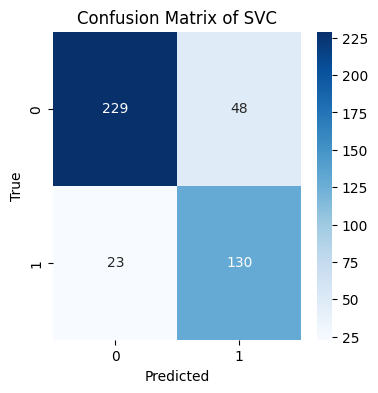

In [ ]:
# Support Vector Machine
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, log_loss
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

# Define features and target
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'ADL', 'BehavioralProblems', 'MemoryComplaints']]
y = data['Diagnosis']

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train_scaled, y_train)

# Reduced hyperparameter grid for RandomizedSearchCV
param_grid = {
    'C': [0.0001, 0.001, 0.01, 0.1],
    'gamma': [0.00001, 0.0001, 0.001, 0.01, 'scale'],
}

# SVM model
model = SVC(random_state=42, class_weight='balanced', probability=True)

# Randomized Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_grid,
                                   n_iter=10, cv=5, scoring='f1', n_jobs=-1, verbose=1, random_state=42)

# Time the model training
start_time = time.time()
random_search.fit(X_train_smote, y_train_smote)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Cross-Validation Score: {random_search.best_score_}")

# Evaluate the best model
best_model = random_search.best_estimator_

# Predict on training and test data
y_train_pred = best_model.predict(X_train_smote)
y_test_pred = best_model.predict(X_test_scaled)

train_accuracy = accuracy_score(y_train_smote, y_train_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)

# Print accuracies
print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")

# Train Loss
y_train_prob = best_model.predict_proba(X_train_smote)
train_log_loss = log_loss(y_train_smote, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Test Loss
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Confusion Matrix and Classification Report
cm = confusion_matrix(y_test, y_test_pred)
report = classification_report(y_test, y_test_pred)
print("Confusion Matrix:\n", cm)
print("Classification Report:\n", report)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'], yticklabels=['0', '1'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix of SVC')


In [ ]:
X.shape

(2149, 11)

In [ ]:
!pip install --upgrade scikit-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.4/13.4 MB 58.6 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.3.2
    Uninstalling scikit-learn-1.3.2:
      Successfully uninstalled scikit-learn-1.3.2


In [ ]:
!pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 3.1 MB/s eta 0:00:00


In [ ]:
!pip install --upgrade tensorflow

Trial 30 Complete [00h 00m 09s]
val_accuracy: 0.6441860198974609

Best val_accuracy So Far: 0.8744186162948608
Total elapsed time: 00h 04m 14s
Epoch 1/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.6582 - loss: 2.6818 - val_accuracy: 0.8163 - val_loss: 1.8028
Epoch 2/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8180 - loss: 1.6329 - val_accuracy: 0.8512 - val_loss: 1.1794
Epoch 3/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8291 - loss: 1.0963 - val_accuracy: 0.8395 - val_loss: 0.8765
Epoch 4/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8393 - loss: 0.8100 - val_accuracy: 0.8465 - val_loss: 0.6871
Epoch 5/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8500 - loss: 0.6597 - val_accuracy: 0.8465 - val_loss: 0.6010
Epoch 6/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8576 - loss: 0.5822 - val_accuracy: 0.8605 - val_loss: 0.5666
Epoch 7/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8519 - loss: 0.5508 - val_accuracy: 

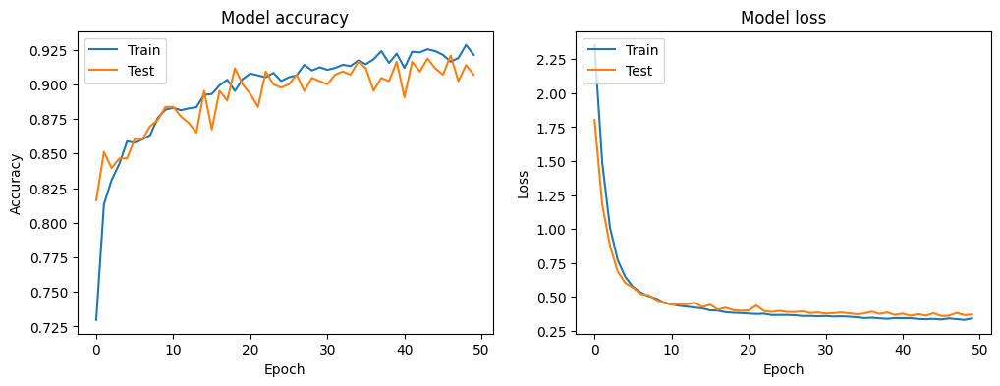

{'num_layers': 5, 'units': 56, 'activation0': 'relu', 'dropout': 0.2, 'optimizer': 'rmsprop', 'activation1': 'tanh', 'activation2': 'tanh', 'activation3': 'relu', 'activation4': 'relu', 'tuner/epochs': 10, 'tuner/initial_epoch': 4, 'tuner/bracket': 2, 'tuner/round': 2, 'tuner/trial_id': '0012'}


In [ ]:
#Neural Network
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, log_loss
import keras_tuner as kt
import time
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE
from tensorflow.keras.callbacks import EarlyStopping

# Splitting the data into features and target
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
        'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE',
        'FunctionalAssessment', 'ADL', 'BehavioralProblems', 'MemoryComplaints']]
y = data['Diagnosis']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Define a function to build the model
def build_model(hp):
    model = Sequential()
    for i in range(hp.Int('num_layers', min_value=1, max_value=5)):  # Reduced max layers
        if i == 0:
            model.add(Dense(hp.Int('units', min_value=8, max_value=64, step=8),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid']),
                            input_dim=11,
                            kernel_regularizer=tf.keras.regularizers.l2(0.01)))  # Added L2 regularization
        else:
            model.add(Dense(hp.Int('units', min_value=8, max_value=64, step=8),
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh', 'sigmoid']),
                            kernel_regularizer=tf.keras.regularizers.l2(0.01)))  # Added L2 regularization
        model.add(Dropout(hp.Choice('dropout', values=[0.2, 0.3, 0.4])))  # Adjusted dropout range
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=hp.Choice('optimizer', values=['adam', 'sgd', 'rmsprop', 'nadam']),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Hyperparameter tuning using Keras Tuner
tuner = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=10,
    factor=3,
    directory='keras_tuner_dir',
    project_name='smote_nn_tuning'
)

# Start the hyperparameter search
tuner.search(X_train_smote, y_train_smote, epochs=10, validation_data=(X_test, y_test)) #Added search method

# Retrieve the best hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters()[0]

# Build the model with the best hyperparameters
best_model = build_model(best_hyperparameters)

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model with the SMOTE-applied training data
start = time.time()
history = best_model.fit(X_train_smote, y_train_smote, epochs=50,  # Increased epochs
                         validation_data=(X_test, y_test),
                         callbacks=[early_stopping])
end = time.time()

# Display training time
print("Time taken to train the model:", end - start)

# Evaluate the model on the train set
train_loss, train_accuracy = best_model.evaluate(X_train_smote, y_train_smote)
print(f"Train Accuracy: {train_accuracy:.4f}")
print(f"Train Loss: {train_loss:.4f}")

# Evaluate the model on the test set
test_loss, test_accuracy = best_model.evaluate(X_test, y_test)
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predict the labels for the test set
y_pred = (best_model.predict(X_test) > 0.5).astype("int32")

# Print classification report
print(classification_report(y_test, y_pred))

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()

# Print the best hyperparameters
print(tuner.get_best_hyperparameters()[0].values)


In [ ]:
!pip install scikeras

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.4/13.4 MB 67.2 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.3.2
    Uninstalling scikit-learn-1.3.2:
      Successfully uninstalled scikit-learn-1.3.2


In [ ]:
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import cross_val_score
#model = KerasClassifier(model=tuner.get_best_models(num_models=1)[0], epochs=100)

# Now you can use cross_val_score
score=cross_val_score(model, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print(score.mean())

0.9010051624658366


Confusion Matrix:
[[260  17]
 [ 23 130]]


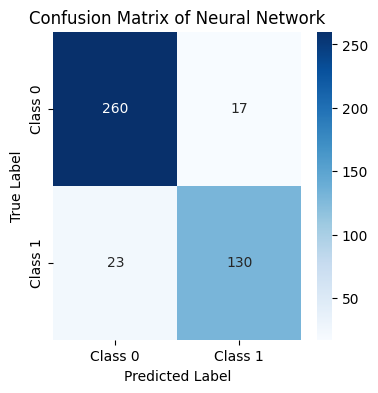

In [ ]:
# Print confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

# Plot confusion matrix
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Class 0', 'Class 1'],
            yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix of Neural Network')
plt.show()

# **5.6 Taking All Features For Training**

In [ ]:
X.shape

(2149, 32)

In [ ]:
X_train.shape

(1719, 32)

In [ ]:
from sklearn.model_selection import StratifiedKFold # Import the necessary class

X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

skf = StratifiedKFold(n_splits=5,random_state=0,shuffle=True)
for train_index, test_index in skf.split(X, y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index] # Use .iloc to index by position
    y_train, y_test = y.iloc[train_index], y.iloc[test_index] # Use .iloc for the Series as well

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Time taken to train the model: 2.4869494438171387
Best Parameters: {'C': 0.1, 'penalty': 'l1', 'solver': 'liblinear'}
Cross-Validation Scores: 0.8150480817896548
Training Accuracy: 0.8379837983798379
Test Accuracy: 0.8116279069767441
Training Log Loss: 0.3858464407279278
Test Log Loss: 0.4387113295663361
Confusion Matrix:
 [[124  28]
 [ 53 225]]
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.81      0.85       278
           1       0.70      0.82      0.75       152

    accuracy                           0.81       430
   macro avg       0.79      0.81      0.80       430
weighted avg       0.82      0.81      0.81       430

ROC AUC Score: 0.881436955698599


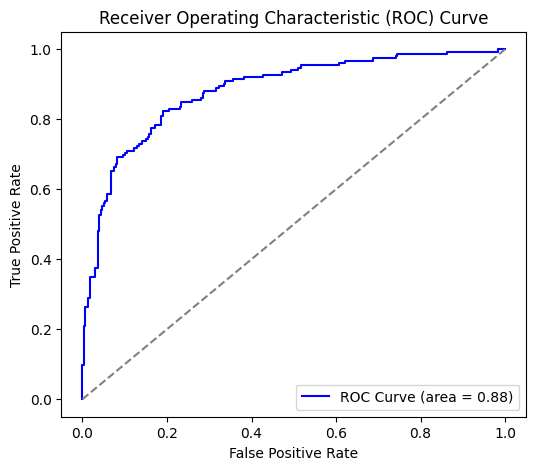

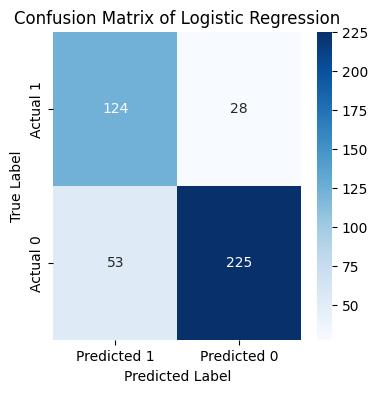

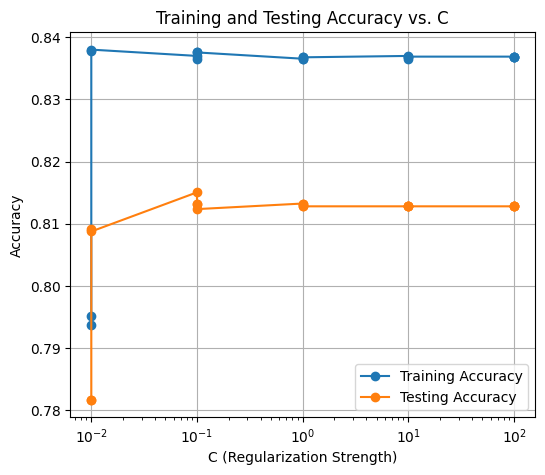

In [ ]:
import time
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, log_loss, confusion_matrix, classification_report, roc_auc_score, roc_curve, make_scorer
from imblearn.over_sampling import SMOTE

X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test_case6 = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Applying SMOTE to balance the classes in the training set
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Scaling the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Defining the parameter grid
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
}

# Initializing the logistic regression model
model = LogisticRegression(max_iter=100, class_weight='balanced')

accuracy_scorer = make_scorer(accuracy_score)
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring=accuracy_scorer, n_jobs=-1, verbose=1, return_train_score=True) # Use the scorer object

# Timing the model training
start_time = time.time()
grid_search.fit(X_train_scaled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Extracting the best model and best parameters
print(f"Best Parameters: {grid_search.best_params_}")
# Calculating cross-validation
print("Cross-Validation Scores:", grid_search.best_score_)

best_model = grid_search.best_estimator_

# Calculating training accuracy
y_train_pred = best_model.predict(X_train_scaled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predicting the test set and calculating test accuracy
y_pred_case6 = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test_case6, y_pred_case6)
print(f"Test Accuracy: {accuracy}")

# Calculating log loss for the training set
y_train_prob = best_model.predict_proba(X_train_scaled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculating log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test_case6, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Generating the confusion matrix and classification report
cm = confusion_matrix(y_test_case6, y_pred_case6, labels=[1, 0])
report = classification_report(y_test_case6, y_pred_case6)
print("Confusion Matrix:\n", cm)
print("Classification Report:\n", report)
roc_auc = roc_auc_score(y_test_case6, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# ROC Curve
fpr, tpr, thresholds = roc_curve(y_test_case6, best_model.predict_proba(X_test_scaled)[:, 1])
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, color='blue', label=f'ROC Curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(False)
plt.show()

print()

# Confusion Matrix Heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Predicted 1', 'Predicted 0'], yticklabels=['Actual 1', 'Actual 0'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix of Logistic Regression')
plt.show()

print()

# Plotting training and testing accuracy for different values of C
results = grid_search.cv_results_
mean_train_scores = results['mean_train_score']
mean_test_scores = results['mean_test_score']
param_C = [param['C'] for param in results['params']]

plt.figure(figsize=(6, 5))
plt.plot(param_C, mean_train_scores, label='Training Accuracy', marker='o')
plt.plot(param_C, mean_test_scores, label='Testing Accuracy', marker='o')
plt.xscale('log')  # Since C varies on a logarithmic scale
plt.xlabel('C (Regularization Strength)')
plt.ylabel('Accuracy')
plt.title('Training and Testing Accuracy vs. C')
plt.legend()
plt.grid(True)
plt.show()


Fitting 5 folds for each of 144 candidates, totalling 720 fits
Time taken to train the model: 12.609740734100342
Best Parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 5, 'min_samples_split': 5, 'splitter': 'best'}
Best Cross-Validation Score: 0.947803421398927
Training Accuracy: 0.9540954095409541
Test Accuracy: 0.9488372093023256
Training Log Loss: 0.1763624913203694
Test Log Loss: 0.21142653763345176
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.97      0.96       278
           1       0.94      0.91      0.93       152

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430

ROC AUC Score: 0.9356422756531617


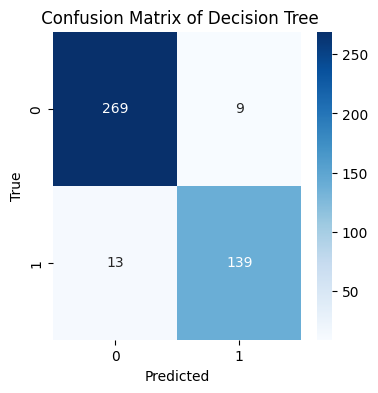

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score, log_loss
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

# Features and target
X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

# Split the data with stratification to maintain the class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Define the parameter grid for GridSearchCV
param_grid = {
    'max_depth': [3, 5, 7, 10],
    'min_samples_split': [5, 10, 15],  # Increase values
    'min_samples_leaf': [5, 10, 15],   # Increase values
    'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random']
}


# Initialize the DecisionTreeClassifier
model = DecisionTreeClassifier(random_state=42, class_weight='balanced', ccp_alpha=0.01)

# Setup GridSearchCV
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)

# Timing the model training
start_time = time.time()
grid_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Best parameters and best score
print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# Use the best model for predictions
best_model = grid_search.best_estimator_

# Calculate training accuracy
y_train_pred = best_model.predict(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predict on the test data
y_pred = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy}")

# Calculate log loss for the training set
y_train_prob = best_model.predict_proba(X_train_resampled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculate log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

# ROC AUC Score
roc_auc = roc_auc_score(y_test, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title(' Confusion Matrix of Decision Tree')

cm_case6 = 'cm_case6.png'
plt.savefig(cm_case6, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

# Download the saved image
files.download(cm_case6)  # Download the saved confusion matrix heatmap

Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:425: FitFailedWarning: 
30 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
15 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1145, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 638, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/_

Time taken to train the model: 16.224028825759888
Best Parameters: {'n_estimators': 150, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_samples': 0.7, 'max_features': 'log2', 'max_depth': 5, 'bootstrap': True}
Best Cross-Validation Score: 0.9482619698350035
Training Accuracy: 0.9585958595859586
Test Accuracy: 0.9465116279069767
Training Log Loss: 0.3872223738736292
Test Log Loss: 0.4345532850477459
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.97      0.96       278
           1       0.94      0.90      0.92       152

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430

ROC AUC Score: 0.9474394168875427


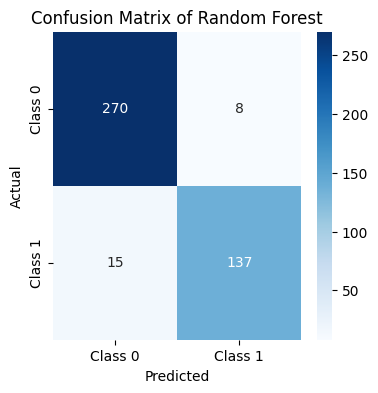

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, log_loss, roc_auc_score
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

# Features and target
X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

# Split data with stratification to maintain class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Adjusted hyperparameter grid
param_distributions = {
    'n_estimators': [50, 100, 150],  # Reduced number of trees
    'max_depth': [3, 4, 5, 7, None],  # Further restricted depth
    'max_samples': [0.7],  # Reduced fraction of data used for each tree
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [2, 4, 6],
    'max_features': ['auto', 'sqrt', 'log2'],
    'bootstrap': [True, False]
}

model = RandomForestClassifier(random_state=42, class_weight='balanced', n_jobs=-1)

# Randomized Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_distributions,
                                    n_iter=10, cv=5, scoring='accuracy', n_jobs=-1, verbose=1, random_state=42)

# Timing the model training
start_time = time.time()
random_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Cross-Validation Score: {random_search.best_score_}")

# Use the best model for predictions
best_model = random_search.best_estimator_

# Calculate training accuracy
y_train_pred = best_model.predict(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predict on test data
y_pred = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy}")

# Calculate log loss for the training set
y_train_prob = best_model.predict_proba(X_train_resampled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculate log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

# ROC AUC Score
roc_auc = roc_auc_score(y_test, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix of Random Forest')
plt.show()

In [ ]:
# Feature selection by Random Forest

from sklearn.feature_selection import RFE

X=data[data.drop(columns=['Diagnosis']).columns]
Y=data['Diagnosis']
# Assuming X and y are your features and target variables
model = RandomForestClassifier(random_state=42)
rfe = RFE(estimator=model, n_features_to_select=11)  # Select top 11 features
rfe = rfe.fit(X, Y)

# Get the ranking of features
ranking = rfe.ranking_
selected_features = X.columns[rfe.support_]

print("Selected Features:", selected_features)

Selected Features: Index(['BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality',
       'SleepQuality', 'CholesterolTriglycerides', 'MMSE',
       'FunctionalAssessment', 'MemoryComplaints', 'BehavioralProblems',
       'ADL'],
      dtype='object')


In [ ]:
import time
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Data preparation
X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Feature selection using Random Forest
feature_selector = RandomForestClassifier(n_estimators=100, random_state=42)
feature_selector.fit(X_train_scaled, y_train)

# Get feature importances
importances = feature_selector.feature_importances_
indices = importances.argsort()[::-1]

# Selecting top features
num_features = 5  # Adjust as needed
selected_features = X.columns[indices[:5]]  # Selecting top features
print(f"Selected Features: {selected_features.tolist()}")

X_train_selected = X_train_scaled[:, indices[:5]]
X_test_selected = X_test_scaled[:, indices[:5]]

# Simplified hyperparameter grid for RandomizedSearchCV
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [2, 4],
    'criterion': ['entropy', 'gini'],
    'class_weight': ['balanced'],
    'bootstrap': [True, False]
}

model = RandomForestClassifier(random_state=42)

# Randomized Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_grid,
                                   n_iter=10, cv=5, scoring='accuracy', n_jobs=-1, verbose=1, random_state=42)

# Timing the model training
start_time = time.time()
random_search.fit(X_train_selected, y_train)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

# Extracting the best model and parameters
print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Cross-Validation Score: {random_search.best_score_}")

best_model = random_search.best_estimator_

# Calculating training accuracy
y_train_pred = best_model.predict(X_train_selected)
train_accuracy = accuracy_score(y_train, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Evaluating the best model on the test data
y_pred = best_model.predict(X_test_selected)
accuracy = accuracy_score(y_test, y_pred)
cm = confusion_matrix(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Test Accuracy: {accuracy}")
print("Confusion Matrix:\n", cm)
print("Classification Report:\n", report)


Selected Features: ['FunctionalAssessment', 'ADL', 'MMSE', 'MemoryComplaints', 'BehavioralProblems']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Time taken to train the model: 30.552217721939087
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_depth': 20, 'criterion': 'entropy', 'class_weight': 'balanced', 'bootstrap': True}
Best Cross-Validation Score: 0.9528747711709269
Training Accuracy: 0.9569517161140197
Test Accuracy: 0.9604651162790697
Confusion Matrix:
 [[272   5]
 [ 12 141]]
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.98      0.97       277
           1       0.97      0.92      0.94       153

    accuracy                           0.96       430
   macro avg       0.96      0.95      0.96       430
weighted avg       0.96      0.96      0.96       430



Fitting 5 folds for each of 10 candidates, totalling 50 fits
Time taken to train the model: 124.83932685852051
Best Parameters: {'kernel': 'rbf', 'gamma': 0.01, 'C': 0.1}
Best Cross-Validation Score: 0.845013883558221
Training Accuracy: 0.8534172661870504
Test Accuracy: 0.8209302325581396
Training Log Loss: 0.351395953685152
Test Log Loss: 0.40702581625802364
Confusion Matrix:
 [[228  49]
 [ 28 125]]
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.82      0.86       277
           1       0.72      0.82      0.76       153

    accuracy                           0.82       430
   macro avg       0.80      0.82      0.81       430
weighted avg       0.83      0.82      0.82       430



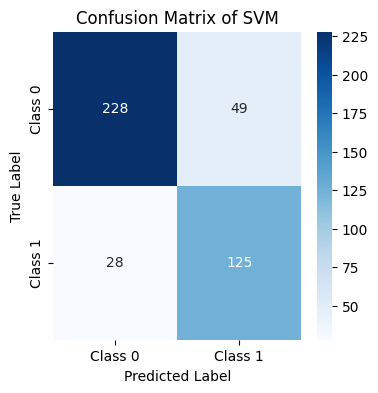

In [ ]:
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, log_loss
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns

X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train_scaled, y_train)

# Reduced hyperparameter grid for RandomizedSearchCV
param_grid = {
    'C': [0.0001, 0.001, 0.01, 0.1],
    'gamma': [0.00001, 0.0001, 0.001, 0.01, 'scale'],
    'kernel': ['rbf']
}

# SVM model
model = SVC(random_state=42, class_weight='balanced', probability=True)

# Randomized Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_grid,
                                   n_iter=10, cv=5, scoring='f1', n_jobs=-1, verbose=1, random_state=42)

# Time the model training
start_time = time.time()
random_search.fit(X_train_smote, y_train_smote)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Cross-Validation Score: {random_search.best_score_}")

# Evaluate the best model
best_model = random_search.best_estimator_

# Predict on training and test data
y_train_pred = best_model.predict(X_train_smote)
y_test_pred = best_model.predict(X_test_scaled)

train_accuracy = accuracy_score(y_train_smote, y_train_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)

# Print accuracies
print(f"Training Accuracy: {train_accuracy}")
print(f"Test Accuracy: {test_accuracy}")

# Train Loss
y_train_prob = best_model.predict_proba(X_train_smote)
train_log_loss = log_loss(y_train_smote, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Test Loss
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Confusion Matrix and Classification Report
cm = confusion_matrix(y_test, y_test_pred)
report = classification_report(y_test, y_test_pred)
print("Confusion Matrix:\n", cm)
print("Classification Report:\n", report)

# Plot Confusion Matrix Heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix of SVM')
plt.show()


In [ ]:
!pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 3.0 MB/s eta 0:00:00


Reloading Tuner from keras_tuner_dir/smote_nn_tuning/tuner0.json
Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


70/70 ━━━━━━━━━━━━━━━━━━━━ 5s 36ms/step - accuracy: 0.5405 - loss: 3.1586 - val_accuracy: 0.7814 - val_loss: 2.0007
Epoch 2/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7298 - loss: 1.7920 - val_accuracy: 0.8023 - val_loss: 1.2044
Epoch 3/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8318 - loss: 1.0853 - val_accuracy: 0.8209 - val_loss: 0.8186
Epoch 4/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8479 - loss: 0.7511 - val_accuracy: 0.8256 - val_loss: 0.6472
Epoch 5/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8564 - loss: 0.5976 - val_accuracy: 0.8279 - val_loss: 0.5694
Epoch 6/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8446 - loss: 0.5361 - val_accuracy: 0.8256 - val_loss: 0.5193
Epoch 7/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8517 - loss: 0.4877 - val_accuracy: 0.8186 - val_loss: 0.5245
Epoch 8/50
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8578 - loss: 0.4636 - val_accuracy: 0.8279 - val_loss: 0.4965
Ep

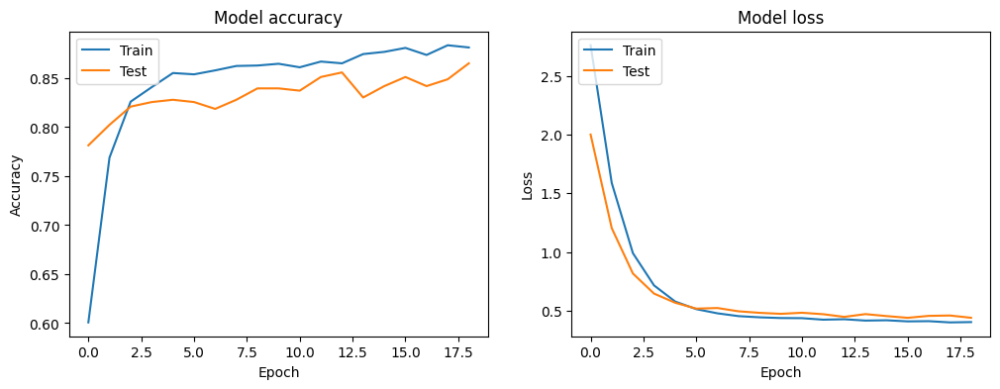

{'num_layers': 2, 'units': 96, 'activation0': 'relu', 'dropout': 0.4, 'optimizer': 'adam', 'activation1': 'relu', 'activation2': 'relu', 'activation3': 'relu', 'activation4': 'tanh', 'activation5': 'tanh', 'activation6': 'sigmoid', 'activation7': 'relu', 'activation8': 'sigmoid', 'activation9': 'sigmoid', 'tuner/epochs': 10, 'tuner/initial_epoch': 4, 'tuner/bracket': 2, 'tuner/round': 2, 'tuner/trial_id': '0012'}


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, log_loss
import keras_tuner as kt
import time
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE
from tensorflow.keras.callbacks import EarlyStopping

# Splitting the data into features and target
X = data.drop(columns=['Diagnosis'])
y = data['Diagnosis']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Define a function to build the model
def build_model(hp):
    model = Sequential()
    for i in range(hp.Int('num_layers', min_value=1, max_value=3)):  # Reduced max layers to 3
        if i == 0:
            model.add(Dense(hp.Int('units', min_value=16, max_value=64, step=16),  # Reduced the range of units
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh']),
                            input_dim=X_train_smote.shape[1],
                            kernel_regularizer=tf.keras.regularizers.l2(0.02)))  # Increased L2 regularization
        else:
            model.add(Dense(hp.Int('units', min_value=16, max_value=64, step=16),  # Reduced the range of units
                            activation=hp.Choice('activation' + str(i), values=['relu', 'tanh']),
                            kernel_regularizer=tf.keras.regularizers.l2(0.02)))  # Increased L2 regularization
        model.add(Dropout(hp.Choice('dropout', values=[0.3, 0.4, 0.5])))  # Increased dropout range
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=hp.Choice('optimizer', values=['adam', 'rmsprop', 'nadam']),  # Removed SGD as it's generally slower
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Hyperparameter tuning using Keras Tuner
tuner = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=20,  # Increased max epochs for tuning
    factor=3,
    directory='keras_tuner_dir',
    project_name='smote_nn_tuning'
)

# Perform the search for the best hyperparameters
tuner.search(X_train_smote, y_train_smote, validation_data=(X_test, y_test),
             epochs=30,  # Reduced number of epochs
             callbacks=[EarlyStopping(monitor='val_loss', patience=3)])  # Reduced patience

# Retrieve the best hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters()[0]

# Build the model with the best hyperparameters
best_model = build_model(best_hyperparameters)

# Train the model with the SMOTE-applied training data
start = time.time()
history = best_model.fit(X_train_smote, y_train_smote, epochs=50,  # Increased epochs
                         validation_data=(X_test, y_test),
                         callbacks=[EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)])
end = time.time()

# Display training time
print("Time taken to train the model:", end - start)

# Evaluate the model on the train set
train_loss, train_accuracy = best_model.evaluate(X_train_smote, y_train_smote)
print(f"Train Accuracy: {train_accuracy:.4f}")
print(f"Train Loss: {train_loss:.4f}")

# Evaluate the model on the test set
test_loss, test_accuracy = best_model.evaluate(X_test, y_test)
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Predict the labels for the test set
y_pred = (best_model.predict(X_test) > 0.5).astype("int32")

# Print classification report
print(classification_report(y_test, y_pred))

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()

# Print the best hyperparameters
print(tuner.get_best_hyperparameters()[0].values)


In [ ]:
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import cross_val_score
#model = KerasClassifier(model=tuner.get_best_models(num_models=1)[0], epochs=100)

# Now you can use cross_val_score
score=cross_val_score(model, X_train_resampled, y_train_resampled, scoring='accuracy', cv=5)
print(score.mean())

0.9010051624658366


Confusion Matrix:
[[244  33]
 [ 31 122]]


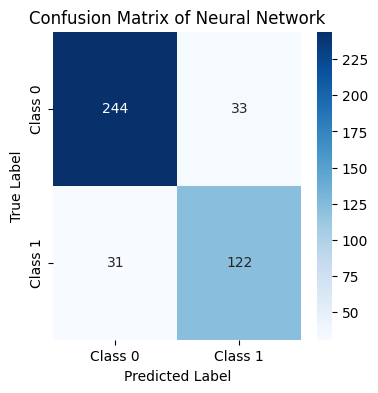

In [ ]:
# Print confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

# Plot confusion matrix
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Class 0', 'Class 1'],
            yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix of Neural Network')
plt.show()

# **Performance Matrix Graph**

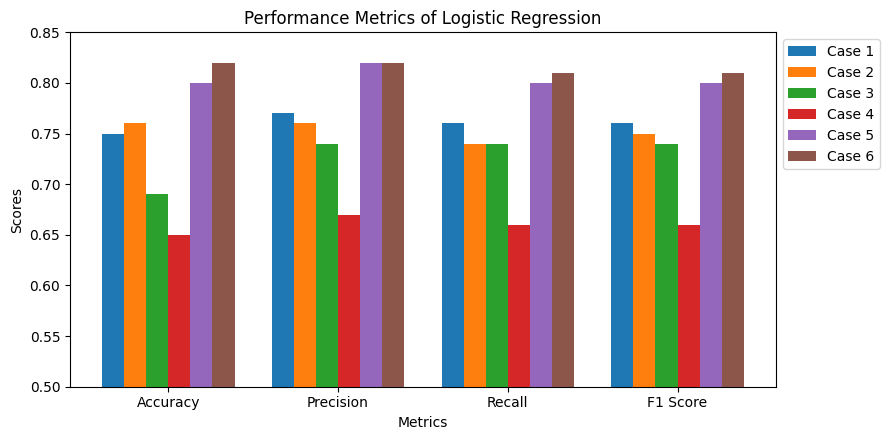

In [ ]:
#Logistic Regression

import matplotlib.pyplot as plt
import numpy as np

# Sample data for demonstration
cases = ['Case 1', 'Case 2', 'Case 3', 'Case 4', 'Case 5', 'Case 6']
accuracy = [0.75, 0.76, 0.69, 0.65, 0.8, 0.82]
precision = [0.77, 0.76, 0.74, 0.67, 0.82, 0.82]
recall = [0.76, 0.74, 0.74, 0.66, 0.8, 0.81]
f1_score = [0.76, 0.75, 0.74, 0.66, 0.8, 0.81]

# Combine the data
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
data = [accuracy, precision, recall, f1_score]

# Set the positions and width for the bars
ind = np.arange(len(metrics))  # x locations for the metrics
width = 0.13  # width of the bars

# Plot the bars
fig, ax = plt.subplots(figsize=(9, 4.5))  # Increase figure size

for i, case in enumerate(cases):
    ax.bar(ind + i * width, [accuracy[i], precision[i], recall[i], f1_score[i]], width, label=case)

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Performance Metrics of Logistic Regression')
ax.set_xticks(ind + width * (len(cases) - 1) / 2)
ax.set_xticklabels(metrics)

# Set y-axis limits and ticks
ax.set_ylim(0.5, 0.85)  # Set y-axis limits
ax.set_yticks(np.arange(0.5, 0.90, 0.05))  # Set y-axis ticks with a gap of 0.05

# Move the legend outside the plot area
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()  # Adjust layout to fit everything
plt.show()


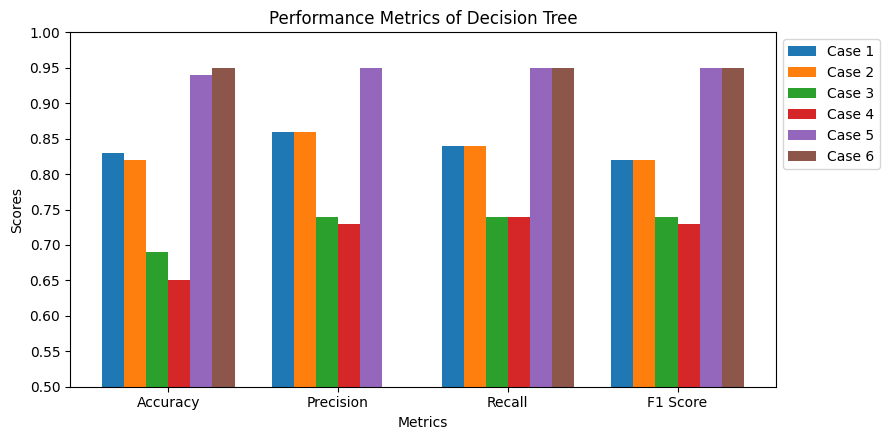

In [ ]:
# DT

import matplotlib.pyplot as plt
import numpy as np

# Sample data for demonstration
cases = ['Case 1', 'Case 2', 'Case 3', 'Case 4', 'Case 5', 'Case 6']
accuracy = [0.83, 0.82, 0.69, 0.65, 0.94, 0.95]
precision = [0.86, 0.86, 0.74, 0.73, 0.95, 0.05]
recall = [0.84, 0.84, 0.74, 0.74, 0.95, 0.95]
f1_score = [0.82, 0.82, 0.74, 0.73, 0.95, 0.95]

# Combine the data
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
data = [accuracy, precision, recall, f1_score]

# Set the positions and width for the bars
ind = np.arange(len(metrics))  # x locations for the metrics
width = 0.13  # width of the bars

# Plot the bars
fig, ax = plt.subplots(figsize=(9, 4.5))  # Increase figure size

for i, case in enumerate(cases):
    ax.bar(ind + i * width, [accuracy[i], precision[i], recall[i], f1_score[i]], width, label=case)

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Performance Metrics of Decision Tree')
ax.set_xticks(ind + width * (len(cases) - 1) / 2)
ax.set_xticklabels(metrics)

# Set y-axis limits and ticks
ax.set_ylim(0.5, 0.95)  # Set y-axis limits
ax.set_yticks(np.arange(0.5, 1.02, 0.05))  # Set y-axis ticks with a gap of 0.05

# Move the legend outside the plot area
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()  # Adjust layout to fit everything
plt.show()


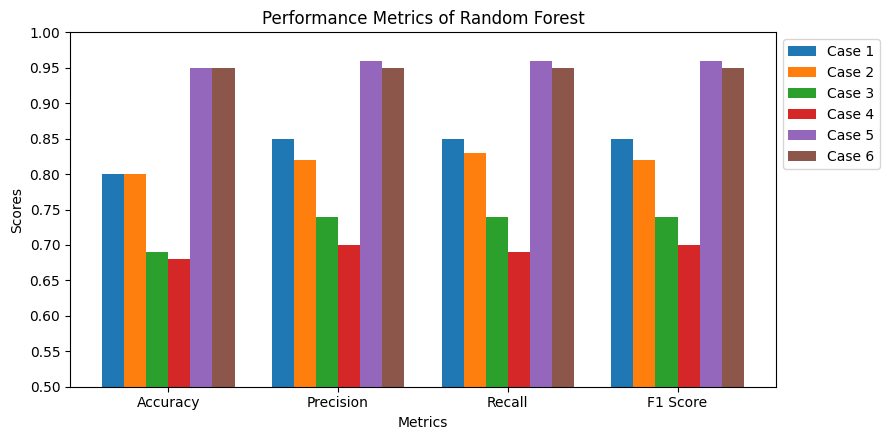

In [ ]:
# RF

import matplotlib.pyplot as plt
import numpy as np

# Sample data for demonstration
cases = ['Case 1', 'Case 2', 'Case 3', 'Case 4', 'Case 5', 'Case 6']
accuracy = [0.80, 0.80, 0.69, 0.68, 0.95, 0.95]
precision = [0.85, 0.82, 0.74, 0.7, 0.96, 0.95]
recall = [0.85, 0.83, 0.74, 0.69, 0.96, 0.95]
f1_score = [0.85, 0.82, 0.74, 0.70, 0.96, 0.95]

# Combine the data
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
data = [accuracy, precision, recall, f1_score]

# Set the positions and width for the bars
ind = np.arange(len(metrics))  # x locations for the metrics
width = 0.13  # width of the bars

# Plot the bars
fig, ax = plt.subplots(figsize=(9, 4.5))  # Increase figure size

for i, case in enumerate(cases):
    ax.bar(ind + i * width, [accuracy[i], precision[i], recall[i], f1_score[i]], width, label=case)

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Performance Metrics of Random Forest')
ax.set_xticks(ind + width * (len(cases) - 1) / 2)
ax.set_xticklabels(metrics)

# Set y-axis limits and ticks
ax.set_ylim(0.5, 0.95)  # Set y-axis limits
ax.set_yticks(np.arange(0.5, 1.02, 0.05))  # Set y-axis ticks with a gap of 0.05

# Move the legend outside the plot area
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()  # Adjust layout to fit everything
plt.show()


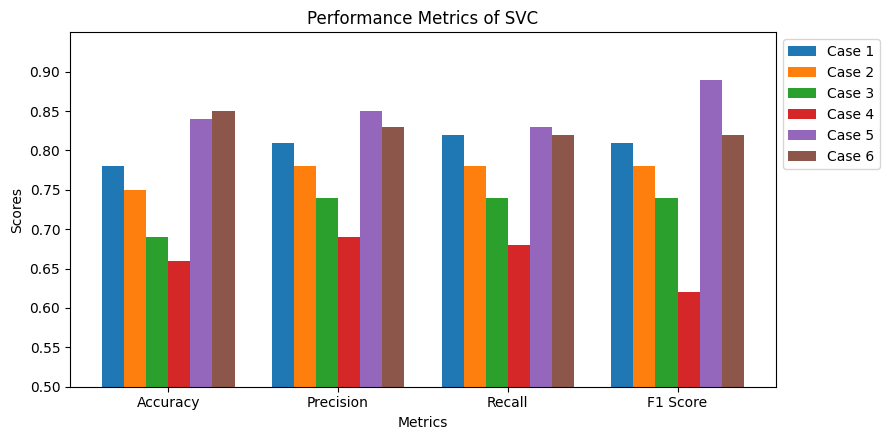

In [ ]:
#SVC

import matplotlib.pyplot as plt
import numpy as np

# Sample data for demonstration
cases = ['Case 1', 'Case 2', 'Case 3', 'Case 4', 'Case 5', 'Case 6']
accuracy = [0.78, 0.75, 0.69, 0.66, 0.84, 0.85]
precision = [0.81, 0.78, 0.74, 0.69, 0.85, 0.83]
recall = [0.82, 0.78, 0.74, 0.68, 0.83, 0.82]
f1_score = [0.81, 0.78, 0.74, 0.62, 0.89, 0.82]

# Combine the data
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
data = [accuracy, precision, recall, f1_score]

# Set the positions and width for the bars
ind = np.arange(len(metrics))  # x locations for the metrics
width = 0.13  # width of the bars

# Plot the bars
fig, ax = plt.subplots(figsize=(9, 4.5))  # Increase figure size

for i, case in enumerate(cases):
    ax.bar(ind + i * width, [accuracy[i], precision[i], recall[i], f1_score[i]], width, label=case)

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Performance Metrics of SVC')
ax.set_xticks(ind + width * (len(cases) - 1) / 2)
ax.set_xticklabels(metrics)

# Set y-axis limits and ticks
ax.set_ylim(0.5, 0.95)  # Set y-axis limits
ax.set_yticks(np.arange(0.5, 0.95, 0.05))  # Set y-axis ticks with a gap of 0.05

# Move the legend outside the plot area
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()  # Adjust layout to fit everything
plt.show()


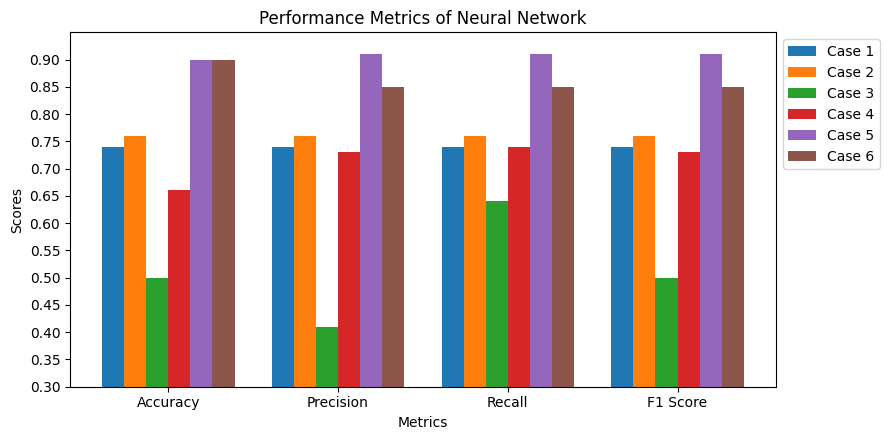

In [ ]:
#Neural Network

import matplotlib.pyplot as plt
import numpy as np

# Sample data for demonstration
cases = ['Case 1', 'Case 2', 'Case 3', 'Case 4', 'Case 5', 'Case 6']
accuracy = [0.74, 0.76, 0.50, 0.66, 0.90, 0.90]
precision = [0.74, 0.76, 0.41, 0.73, 0.91, 0.85]
recall = [0.74, 0.76, 0.64, 0.74, 0.91, 0.85]
f1_score = [0.74, 0.76, 0.50, 0.73, 0.91, 0.85]

# Combine the data
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
data = [accuracy, precision, recall, f1_score]

# Set the positions and width for the bars
ind = np.arange(len(metrics))  # x locations for the metrics
width = 0.13  # width of the bars

# Plot the bars
fig, ax = plt.subplots(figsize=(9, 4.5))  # Increase figure size

for i, case in enumerate(cases):
    ax.bar(ind + i * width, [accuracy[i], precision[i], recall[i], f1_score[i]], width, label=case)

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Performance Metrics of Neural Network')
ax.set_xticks(ind + width * (len(cases) - 1) / 2)
ax.set_xticklabels(metrics)

# Set y-axis limits and ticks
ax.set_ylim(0.3, 0.95)  # Set y-axis limits
ax.set_yticks(np.arange(0.3, 0.95, 0.05))  # Set y-axis ticks with a gap of 0.05

# Move the legend outside the plot area
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()  # Adjust layout to fit everything
plt.show()


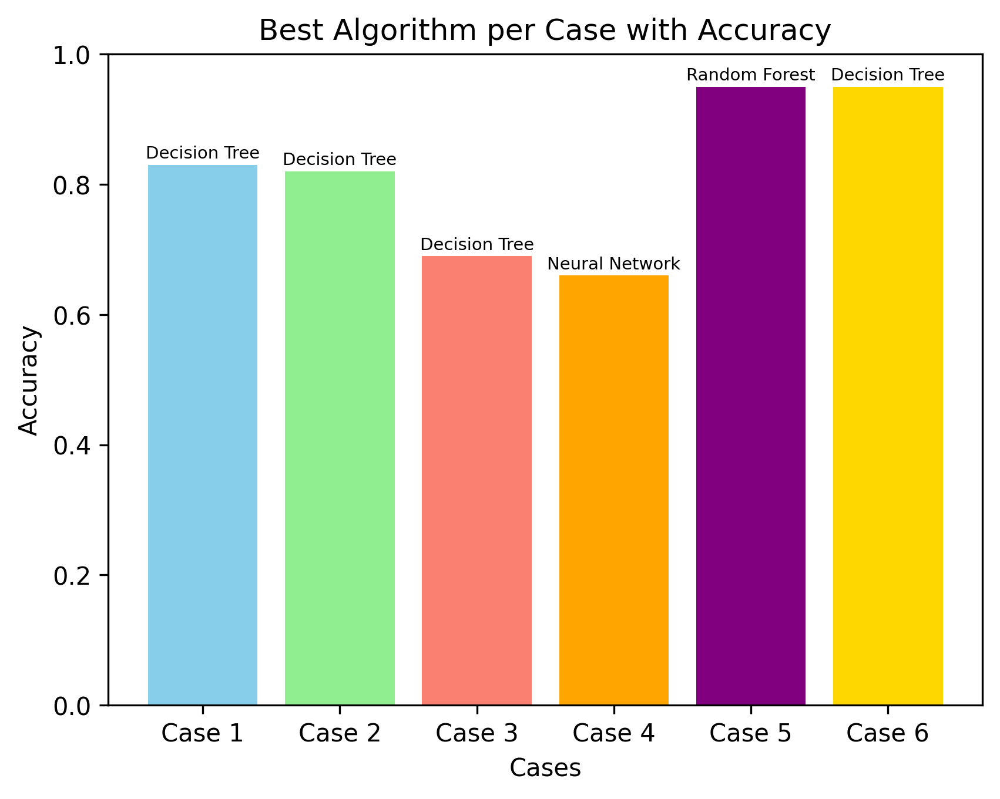

In [ ]:
import matplotlib.pyplot as plt
from google.colab import files

# Sample data: Cases and corresponding best algorithms with accuracies
cases = ['Case 1', 'Case 2', 'Case 3', 'Case 4', 'Case 5', 'Case 6']
algorithms = ['Decision Tree', 'Decision Tree', 'Decision Tree', 'Neural Network', 'Random Forest', 'Decision Tree']
accuracies = [0.83, 0.82, 0.69, 0.66, 0.95, 0.95]

# Different colors for each case
colors = ['skyblue', 'lightgreen', 'salmon', 'orange', 'purple', 'gold']

# Create figure and axis
fig, ax = plt.subplots(dpi=300)

# Plot accuracy as vertical bars, with cases on x-axis and different colors
ax.bar(cases, accuracies, color=colors)

# Set y-axis limits from 0 to 1
ax.set_ylim(0, 1)

# Add annotations for algorithm names with smaller font size
for i in range(len(cases)):
    ax.text(i, accuracies[i] + 0.01, algorithms[i], ha='center', fontsize=7)  # Reduced fontsize to 7

# Add labels and title
ax.set_ylabel('Accuracy')
ax.set_xlabel('Cases')
ax.set_title('Best Algorithm per Case with Accuracy')

plt.show()

# **Downloading the Model**


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
30 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1466, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/_p

Time taken to train the model: 11.600096225738525
Best Parameters: {'n_estimators': 150, 'min_samples_split': 2, 'min_samples_leaf': 6, 'max_samples': 0.7, 'max_features': 'sqrt', 'max_depth': 7, 'bootstrap': True}
Best Cross-Validation Score: 0.9482548840975807
Training Accuracy: 0.9576957695769577
Test Accuracy: 0.9558139534883721
Training Log Loss: 0.21480185539059587
Test Log Loss: 0.2774467853207612
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.97       278
           1       0.95      0.93      0.94       152

    accuracy                           0.96       430
   macro avg       0.95      0.95      0.95       430
weighted avg       0.96      0.96      0.96       430

ROC AUC Score: 0.9425407042786823


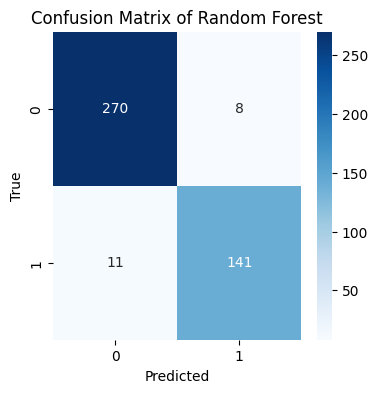

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, log_loss, roc_auc_score
from imblearn.over_sampling import SMOTE
import time
import matplotlib.pyplot as plt
import seaborn as sns


# Features and target
X = data[['BMI', 'SleepQuality', 'SystolicBP', 'CholesterolLDL',
          'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE',
          'FunctionalAssessment', 'ADL', 'BehavioralProblems', 'MemoryComplaints']]
y = data['Diagnosis']

# Split data with stratification to maintain class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Adjusted hyperparameter grid
param_distributions = {
    'n_estimators': [50, 100, 150],  # Reduced number of trees
    'max_depth': [3, 4, 5, 7, None],  # Further restricted depth
    'max_samples': [0.7],  # Reduced fraction of data used for each tree
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [2, 4, 6],
    'max_features': ['auto', 'sqrt', 'log2'],
    'bootstrap': [True, False]
}

model = RandomForestClassifier(random_state=42, class_weight='balanced', n_jobs=-1)

# Randomized Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_distributions,
                                    n_iter=10, cv=5, scoring='accuracy', n_jobs=-1, verbose=1, random_state=42)

# Timing the model training
start_time = time.time()
random_search.fit(X_train_resampled, y_train_resampled)
end_time = time.time()
print("Time taken to train the model:", end_time - start_time)

print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Cross-Validation Score: {random_search.best_score_}")

# Use the best model for predictions
best_model = random_search.best_estimator_

# Calculate training accuracy
y_train_pred = best_model.predict(X_train_resampled)
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)
print(f"Training Accuracy: {train_accuracy}")

# Predict on test data
y_pred = best_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy}")

# Calculate log loss for the training set
y_train_prob = best_model.predict_proba(X_train_resampled)
train_log_loss = log_loss(y_train_resampled, y_train_prob)
print(f"Training Log Loss: {train_log_loss}")

# Calculate log loss for the test set
y_test_prob = best_model.predict_proba(X_test_scaled)
test_log_loss = log_loss(y_test, y_test_prob)
print(f"Test Log Loss: {test_log_loss}")

# Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

# ROC AUC Score
roc_auc = roc_auc_score(y_test, best_model.predict_proba(X_test_scaled)[:, 1])
print(f"ROC AUC Score: {roc_auc}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'], yticklabels=['0', '1'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix of Random Forest')

confusion_matrix_3 = 'confusion_matrix3.png'
plt.savefig(confusion_matrix_3, dpi=300, bbox_inches='tight')  # Save as PNG with 300 DPI

# Show the plot
plt.show()

print()
print()

pipe = Pipeline([('scaler', scaler), ('best_model', best_model)])

y_pred = pipe.predict(X_test_scaled)

In [ ]:
import pickle
pickle.dump(model, open('model.pkl', 'wb'))
pickle.dump(pipe, open('pipe.pkl', 'wb'))


In [ ]:
import pickle

selected_cols = X

#data_selected = data[selected_cols]
pickle.dump(selected_cols, open('selected_cols.pkl', 'wb'))
pickle.dump(pipe, open('pipe.pkl', 'wb'))
